# SETUP

In [ ]:
#Import the relevant modules. If some of these are not installed, create a new cell and run "!pip install <name of the module>"
import pandas as pd
import numpy as np
from google.colab import drive
drive.mount('/content/drive')
import math
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
from scipy import stats
from ast import literal_eval

# Dataset cleaning and preparation 

**Import the dataset**

In [ ]:
air_raw = pd.read_csv("drive/My Drive/Stats Project/AirBB Dataset.csv") #import the raw dataset - replace this with the path to the csv

In [ ]:
# delete columns of that are clearly not relevant or that have a high amount of missing values
del air_raw['thumbnail_url']

del air_raw['zipcode']


del air_raw['first_review']

del air_raw['host_since']

del air_raw['name']

**Clean the Amenities**

In [ ]:
air_raw['amenities_lists'] = air_raw['amenities'].apply(lambda x: x.split(sep=',')) # create a list from the amenity string

#identifying all characters used in amenities
amenities = air_raw['amenities_lists'] 

element = []

for x in amenities:
    for elements in x:
        symbols = list(elements)
        for y in symbols:
            element.append(y)
        
unqiue_symbols = set(element)

# the unique characters identified from the amenities_list
unique_symbols = {'F', 'H', 'd', 'W', ' ', '/', 'h', ')', 'e', 'R', 'C', '4', 'E', 'T', 'I',
                  '0', 'G', 'k', ':', 'v', 'y', 'B', '"', 'z', 'm', 'f', 'w', '{', 'L', '’', 'K',
                  'p', 'b', 'S', 'Q', 'A', '5', '.', 'u', 'o', 'n', '-', '2', '9', 'l', 'x', '&',
                  'i', 'O', 'r', 'V', '(', 's', 'a', '_', 'D', 'P', 'M', '}', 'g', 'c', 't'}


# creating a function to apply to column
def clean_amenities(lis):
    ## identified from analysis above
    unwanted_symbols = [':','(','_','}','/','&','.','{',')','"','"}','{']
    no_wrong_translations_and_lower_case = [x.lower() for x in lis if 'translation' not in x]
    
    # no numerics
    no_numerics = [x for x in no_wrong_translations_and_lower_case if x.isnumeric() == False ]
    # lower_string = []
    finished = []
    for eles in no_numerics:
        for x in unwanted_symbols:
            eles = eles.strip(f'\{x}')
        finished.append(eles)
    return finished


#applying the function 
air_raw['amenities_cleaned'] = air_raw['amenities_lists'].apply(clean_amenities)

# we can now delete the original amenities column
del air_raw['amenities']

In [ ]:
set_amenities = set([symbol for x in air_raw['amenities_cleaned'] for symbol in x])

#now lets identify all the pairs that we want to merge together
replacements = [('washer / dryer','washer'), ('wide doorway', 'wide entryway'), ('smart lock', 'smartlock'), ('firm mattress', 'firm mattress'), ('elevator in building', 'elevator'), ('doorman entry', 'doorman'), ('bathtub with shower chair', 'bathtub'), ('cable tv', 'tv'), ('internet', 'wireless internet'), ('wide hallway clearance', 'wide entryway')]

In [ ]:
def replace_and_clean(listi):  
    if type(list) == str: #For some property the list is store as a string, hence convert it to an array 
      listi = literal_eval(listi_string)

    replacements = [('washer / dryer','washer'), ('wide doorway', 'wide entryway'), ('smart lock', 'smartlock'), ('firm mattress', 'firm mattress'), ('elevator in building', 'elevator'), ('doorman entry', 'doorman'), ('bathtub with shower chair', 'bathtub'), ('cable tv', 'tv'), ('internet', 'wireless internet'), ('wide hallway clearance', 'wide entryway')] 
    for x in replacements:
        if x[0] in listi:
            listi.remove(x[0])
            if x[1] not in listi:
              listi.append(x[1])  
                          
    return listi

In [ ]:
air_raw['amenities_cleaned'] = air_raw['amenities_cleaned'].apply(replace_and_clean)

**Dealing with NA values**

In [ ]:
#exploring the dataset for NA values
air_raw.isnull().sum()

id                            0
log_price                     0
property_type                 0
room_type                     0
accommodates                  0
bathrooms                   200
cancellation_policy           0
cleaning_fee                  0
city                          0
description                   0
host_identity_verified      188
host_response_rate        18299
instant_bookable              0
latitude                      0
longitude                     0
neighbourhood              6872
number_of_reviews             0
review_scores_rating      16722
bedrooms                     91
beds                        131
amenities_lists               0
amenities_cleaned             0
dtype: int64

In [ ]:
# for columns: bedrooms, host identity verified, bedrooms and beds the number of missing values is so low, there are no statistical
# implications when dropping these few rows making up a considerably small portion of the data set. Hence we drop the columns

air_raw = air_raw[air_raw['beds'].notna() & air_raw['bedrooms'].notna() & air_raw['host_identity_verified'].notna() & air_raw['bathrooms'].notna()]


In [ ]:
# We now check for the remaining columns
air_raw.isnull().sum()

# 3 columns have a high number of NA, yet we do not drop them yet as they can be important for future analysis 

id                            0
log_price                     0
property_type                 0
room_type                     0
accommodates                  0
bathrooms                     0
cancellation_policy           0
cleaning_fee                  0
city                          0
description                   0
host_identity_verified        0
host_response_rate        18021
instant_bookable              0
latitude                      0
longitude                     0
neighbourhood              6844
number_of_reviews             0
review_scores_rating      16590
bedrooms                      0
beds                          0
amenities_lists               0
amenities_cleaned             0
dtype: int64

**Cleaning the host response rate**

In [ ]:
#we remove the % sign and turn into a integer
def turn_numeric(strin):
    if type(strin) == type(float("nan")):
        return strin
    else:
        num = strin.strip('%')
        numeric = int(num)
        return round(numeric,0)
air_raw['host_response_rate_numeric'] = air_raw['host_response_rate'].apply(turn_numeric)

#we can now delete the column
del air_raw['host_response_rate']


**Binning the Host Response Rate**

In [ ]:
# creating bins for host response rate
bins = [0,10,20,30,40,50,60,70,80,90,100]
air_raw['response_rate_binned'] = pd.cut(air_raw['host_response_rate_numeric'], bins)

**Adding Regular Price**

In [ ]:
# add regular price
air_raw['normal_price'] = np.exp(air_raw['log_price'])

**Cleaning Property type**

In [ ]:
#Firstly, we merge the following properties in the category other. These appear very rarely, hence no significant statistical conclusion can be drawn
property_types_to_merge_into_others = ["Island","Lighthouse", "Parking Space","Casa particular","Cave","Train","Tipi"
"Earth House",
"LightHouse",
"Treehouse",
"Chalet",
"Hut",
"Yurt",
"Vacation home",
"Castle",
"Tent",
"Boat",
"Camper/RV", 
"Tipi", 
"Earth House",
"Boutique hotel", 
]

air_raw.loc[air_raw["property_type"].isin(property_types_to_merge_into_others), 'property_type'] = "Other"

#Secondly, we merge similar properties together. We looked at Airbnb specifications and guidelines to determine this


#Merge "serviced apartment" into "apartment"
air_raw.loc[air_raw["property_type"] == "Serviced apartment", 'property_type'] = "Apartment"

#Merge "hostel" to "dorm"
air_raw.loc[air_raw["property_type"] == "Hostel", 'property_type'] = "Dorm"

#Merge "timeshare" to "condominium"
air_raw.loc[air_raw["property_type"] == "Timeshare", 'property_type'] = "Condominium"

#Merge "Cabin" to "Bungalow"
air_raw.loc[air_raw["property_type"] == "Cabin", 'property_type'] = "Bungalow"

#Merge "in-law" to "guest-house"
air_raw.loc[air_raw["property_type"] == "In-law", 'property_type'] = "Guesthouse"

#Merge "guesthouse" to "guest-house"
air_raw.loc[air_raw["property_type"] == "Guesthouse", 'property_type'] = "Guest-house"

#Merge "guesthouse" to "guest-house"
air_raw.loc[air_raw["property_type"] == "Guesthouse", 'property_type'] = "Guest-house"

#Merge "Guest suite" to "guest-house"
air_raw.loc[air_raw["property_type"] == "Guest suite", 'property_type'] = "Guest-house"

#We are now left with:
air_raw['property_type'].unique()

array(['Apartment', 'House', 'Condominium', 'Loft', 'Townhouse', 'Dorm',
       'Guest-house', 'Bed & Breakfast', 'Bungalow', 'Other', 'Villa'],
      dtype=object)

**Add price groups**

In [ ]:
air_raw["price"] = air_raw.apply(lambda row: np.exp(row["log_price"]), axis = 1)

# grouping the groups of people to lower down the possible values that the variable can take
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5-6"
    elif x == 7 or x == 8:
        return "7-8"
    elif x == 9 or x == 10:
        return "9-10"
    else:
        return ">10"
air_raw["guests_group"] = air_raw["accommodates"].apply(group_guests)

**Saving the cleaned dataset**

In [ ]:
air_raw.to_csv("/content/drive/MyDrive/Stats Project/cleaned_airbnb_data.csv", index = False)

#Load Cleaned Dataset

In [ ]:
air = pd.read_csv("/content/drive/MyDrive/Stats Project/cleaned_airbnb_data.csv")
air.amenities_cleaned = air.amenities_cleaned.apply(lambda x: literal_eval(x))

**Create city dataframes**

In [ ]:
cities = []

def city(data,city):
    return data[data['city']==city]

for x in list(air['city'].unique()):
    cities.append((city(air,x),x))

#General Data Analysis 

NYC


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


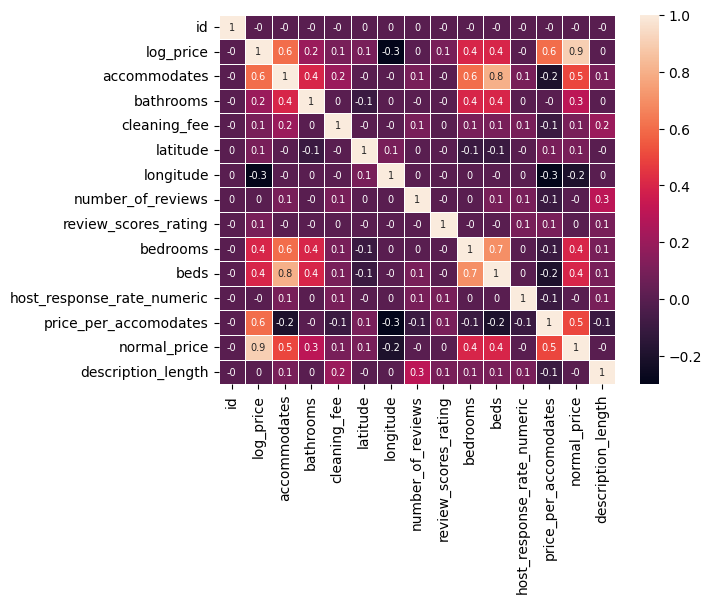

SF


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


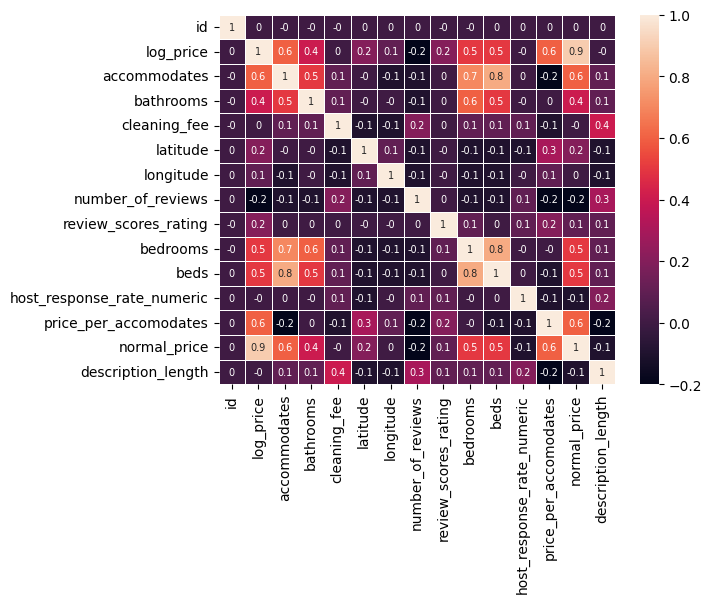

DC


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


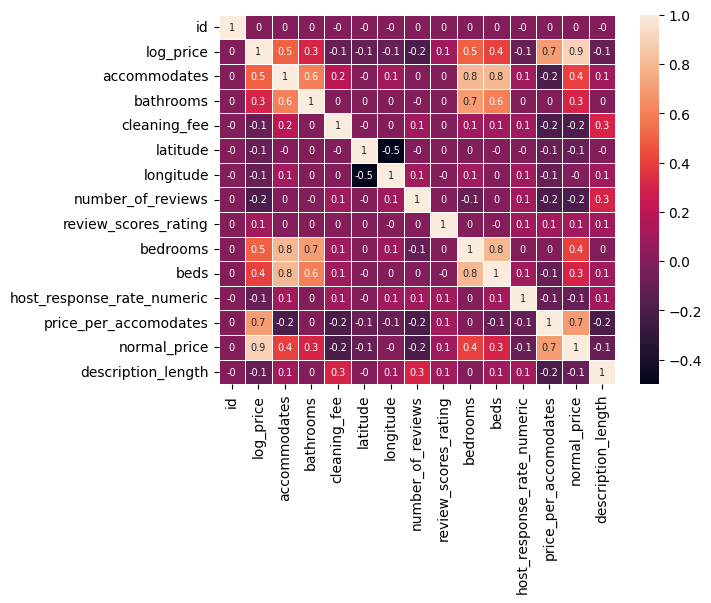

LA


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


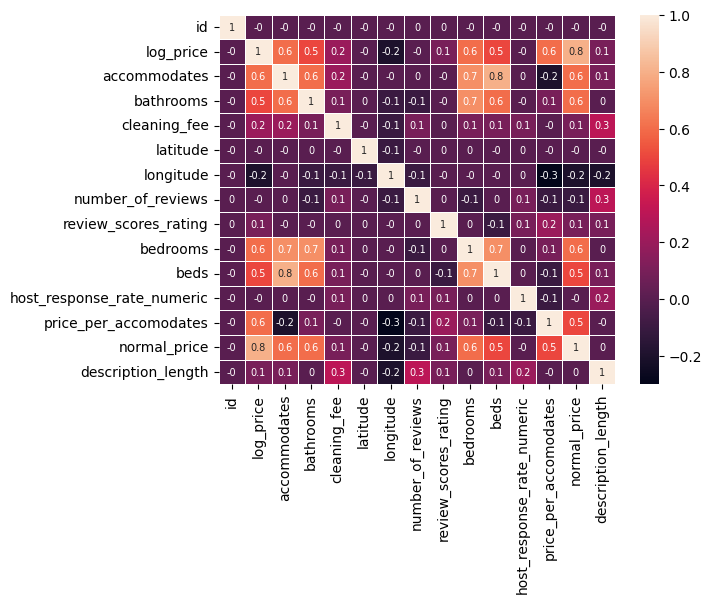

Chicago


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


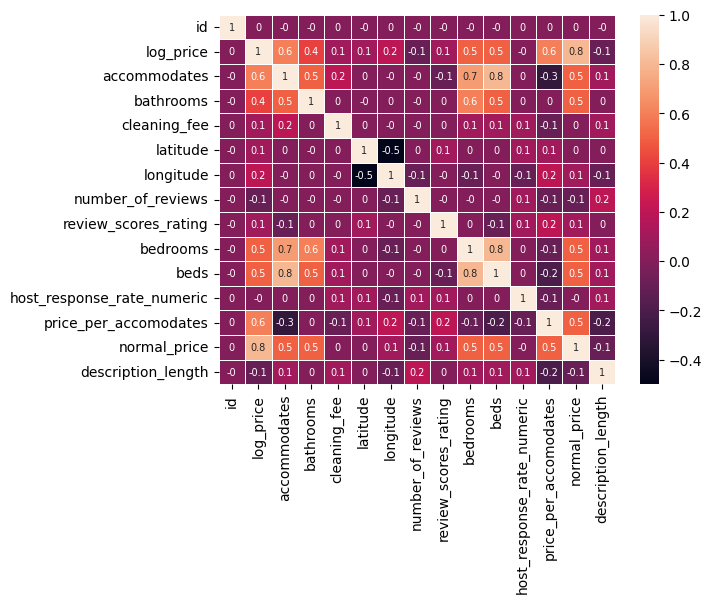

Boston


<ipython-input-40-819573056837>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr()


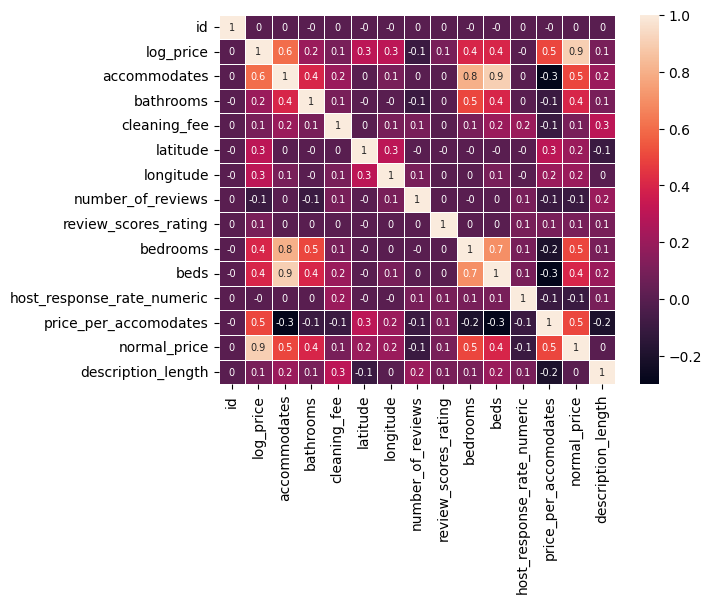

In [ ]:
# check if correlation changes for different cities amongst numerical columns
def myfunc(num):
    return round(num,1)
    
for df, cit in cities:
  print(cit)
  data = df.corr()
  data[list(data.columns)] = data[list(data.columns)].apply(myfunc)
  sns.heatmap(data, annot=True, linewidths=.5, annot_kws={"fontsize":7}, fmt='g')
  plt.show()

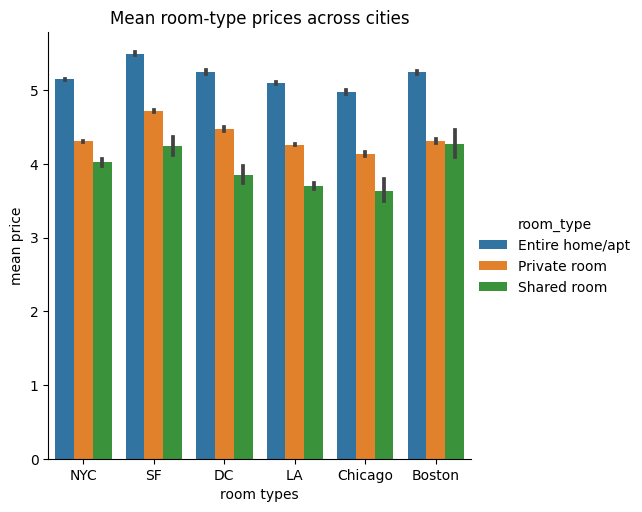

In [ ]:
# room type analysis across cities
ax = sns.catplot(data = air, kind = "bar", x = "city", y = "log_price", hue = 'room_type', estimator='mean', legend=True)
ax.set(title='Mean room-type prices across cities')
ax.set(xlabel='room types', ylabel='mean price')
#plt.legend(title='room types', loc='upper right', labels=['Entire home/apt', 'Private room', 'Shared room'])
plt.show(ax)
#plt.legend(bbox_to_anchor=(1.02, 0.1), loc='upper left', borderaxespad=0, title = "Room")



Result: prices are the highest for entire home/apartment in every city, differences between category can slightly defer though, in general, big difference in price between entire home/apartment and the other two catgeories, smaller difference between privat room and shared room,  situation described previously very comparable for SF,DC,LA,Chicago, lowest prices for shared rooms are in NYC, in Boston almost equl price for shared rooms and privat rooms

<Figure size 1000x400 with 0 Axes>

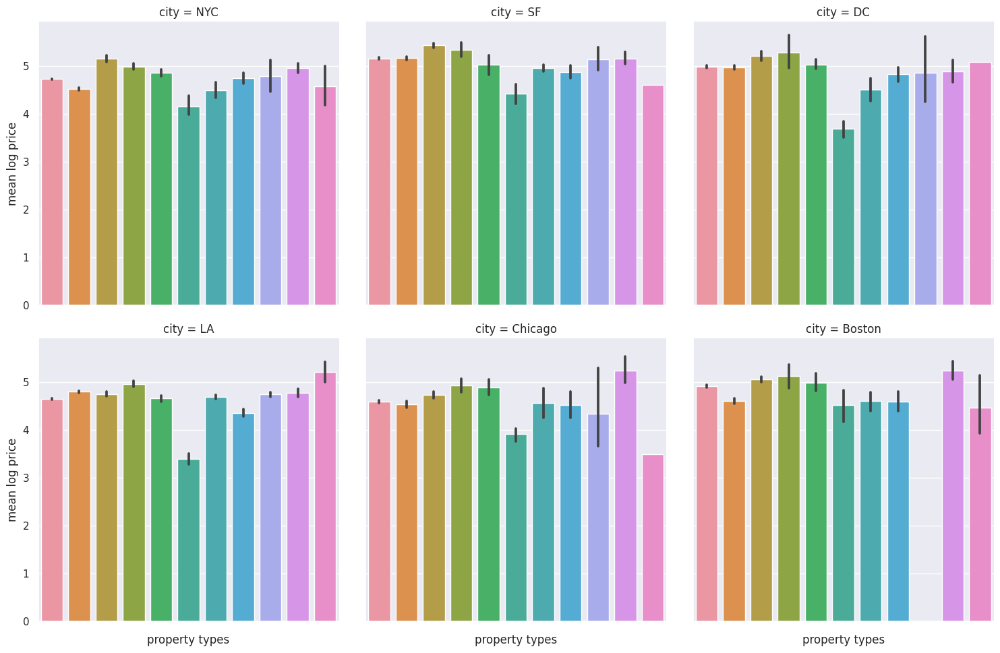

property types:  ['Apartment', 'House', 'Condominium', 'Loft', 'Townhouse', 'Dorm', 'Guest-house', 'Bed & Breakfast', 'Bungalow', 'Other', 'Villa']


In [ ]:
# still to be cleaned or exchanged with
plt.figure(figsize = (10,4))
ax = sns.catplot(data = air, kind = "bar", x = "property_type", y = "log_price", col = "city", col_wrap = 3, estimator='mean')
ax.set(xlabel='property types', ylabel='mean log price')
ax.set_xticklabels(rotation=30)
plt.show(ax)
print('property types: ' , list(air['property_type'].unique()))

Most profitable property types varies across cities, but the two that are always amongst the top 3 are loft and condominium, partially very city specific and results that fit to the 'general city vibe' for example Villa being the most expensive for LA, and Townhouse being 2nd most expensive for Boston --> demand higher for city specific property types

other section has to be recleaned, the fact that it is so randomly filled by all kind of properties but still often one of the most expensive property types shows that it includes very expensive outliers that falsly represent the entire other group, maybe exclude from this visual representation

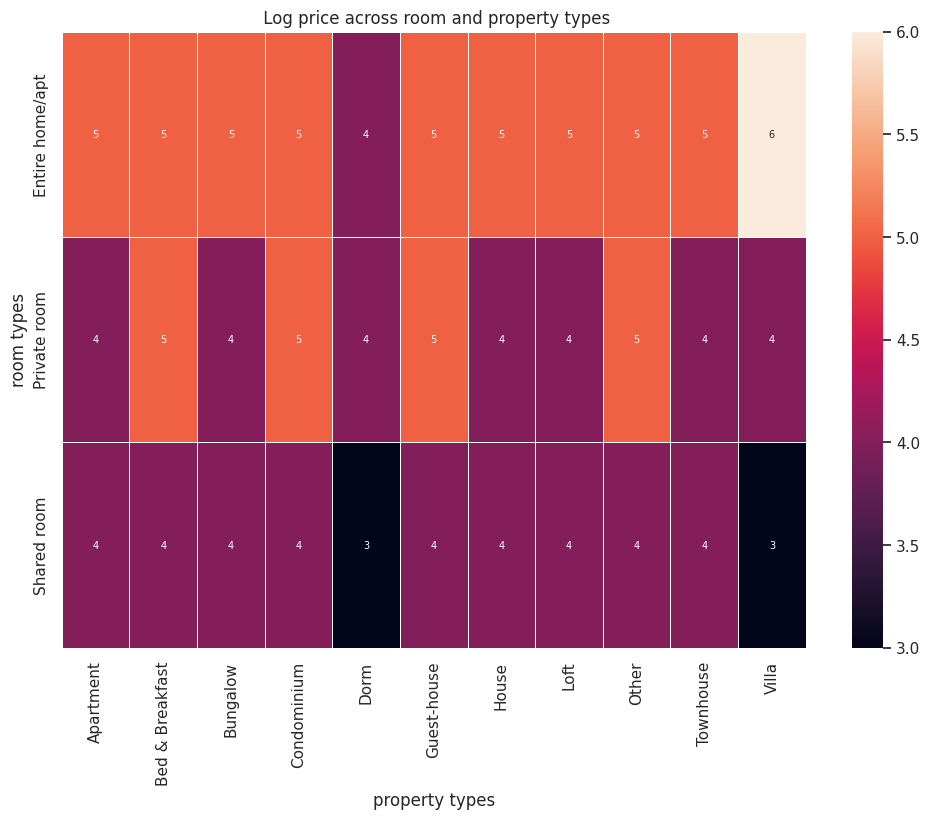

In [ ]:
# heatmap for combination of prices and property type
def myfunc(num):
    return round(np.mean(num))

room_property = pd.pivot_table(air, values='log_price', index=['room_type'], columns=['property_type'], aggfunc=myfunc)
room_property
ax = sns.heatmap(room_property, annot=True, linewidths=.5, annot_kws={"fontsize":7}, fmt='g')
ax.set(xlabel='property types', ylabel='room types')
ax.set(title=' Log price across room and property types')
plt.show(ax)

Heatmap represents the general analysis performed earlier, in general entire homes/apt are the most expensive, also loft /condominium stay relatively high priced across all 3 room types, interesting that through this segmentation, for the entire home/apt segment, lofts and condominiums are being strongly surpassed in price by villa and townhouse which where the most expensive property types in LA and Boston

<Axes: xlabel='city', ylabel='log_price'>

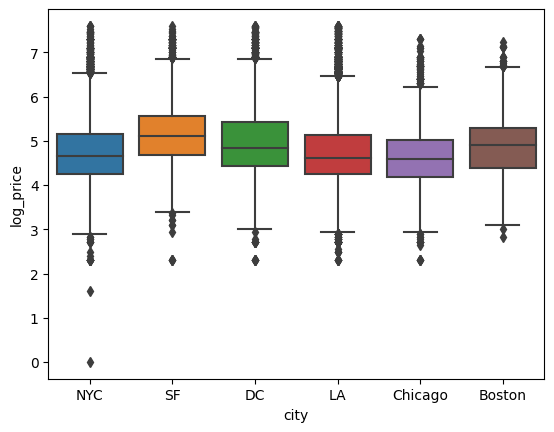

In [ ]:
# check price distribution per city
    
sns.boxplot(data=air, x='city', y='log_price')

All price distributions heavily right skewed, NYC, SF, DC, LA having the most extreme right outliers, compared to Chicago and Boston, solly looking at portion of data that is within defined min and max boarders, San Francisco has the highest median price and also its entire IQR is within the highest price range when compared to the other cities

#How amenities influence price

Finding how many times each amenity appear:

In [ ]:
all_amenities = []
for i, house in air.iloc[:10].iterrows():
  all_amenities += house.amenities_cleaned

**Grouping similar amenities**

1.   We group all the *kitchen amenities* together (stove, oven, etc). As long as you have any typical kitchen amenity (stove, oven, dishwasher, we assume there is a kitchen. Of course, this is not perfect and there could be some occurences of a house having a stove but not a kitchen, but this is not relevant over 70.000.

2.   We group all *accessibility amenities* together (well chair accessible, etc.)
3.   We group all *safety amenities* together (fire extinguisher, carbon monoxide detectors, etc)

4. We group all *family friendly amenities* together

5. We group all "outdoor amenities* together

And so on. See below the dict for more details

**Implementing the code to group and create a column for each group**

The value of the column correponds to the number of amenities in that group


In [ ]:
amenities_groups = {
    "kitchen amenities": ["hot water kettle", "oven","stove", "microwave", "refrigerator","cooking basics","dishes and silverware","dishwasher","coffee maker","high chair", "kitchen"],
    "bathroom amenities": ["hand or paper towel","toilet paper","bath towel", "private bathroom", "bathtub","handheld shower head", "changing table", "shampoo", "body soap", "hand soap"],
    "accessible amenities": ["bathtub with shower chair", " smooth pathway to front door", "wide hallway clearance", "flat smooth pathway to front door", "table corner guards", "firm mattress", "smooth pathway to front door", "wide clearance to bed", "fixed grab bars for shower & toilet", "wide clearance to shower and toilet", "step-free access", "wide doorway", "ground floor access", "wide clearance to shower & toilet", "wheelchair accessible", "wide entryway", "accessible-height toilet","accessible-height bed", "wide clearance to bed and shower & toilet","roll-in shower with chair","grab-rails for shower and toilet","disabled parking spot" ],
    "family-friendly amenities": ["outlet covers", "pack ’n play/travel crib", "stair gates", "baby monitor","babysitter recommendations", "children’s dinnerware", "family/kid friendly","kids' books and toys", "pack 'n play/travel crib", "children's dinnerware", "children’s books and toys"],
    "safety amenities": ["baby bath", "lockbox", "window guards", "air purifier", "smoke detector","carbon monoxide detector","fire extinguisher", "safety card","fireplace guards", "first aid kit", "lock on bedroom door"],
    "technology amenities": ["smart lock", "internet", "buzzer/wireless intercom", "ethernet connection", "wireless internet","laptop friendly workspace", "smartlock", "pocket wifi", "tv", "cable tv"],
    "outdoor amenities": ["pool", "hot tub", "patio/balcony", "path to entrance lit at night","lake access", "garden or backyard", "patio or balcony","beach essentials","waterfront", "ski in/ski out", "beachfront", "bbq grill"],
    "parking amenities": ["free parking on street",  "free parking on premises","paid parking off premises","ev charger"],
    "check-in/check-out amenities": ["host greets you", "keypad", "24-hour check-in","self check-in","cleaning before checkout","luggage dropoff allowed"],
    "comfort/entertainment amenities": ["washer / dryer", "elevator in building", "suitable for events", "gym", "private entrance", "doorman", "elevator", "breakfast", "smoking allowed", "bed linens","firm matress", "room-darkening shades", "essentials","heating","hangers", "hot water", "indoor fireplace", "air conditioning","TV","hair dryer", "iron", "extra pillows and blankets","fireplace", "game console", "washer", "dryer", "", "washer/dryer", "well-lit path to entrance", "doorman entry"],
    "animal-friendly amenities": [ "private living room", "dog(s", "cat(s", "pets allowed", "pets live on this property", "other pet(s)"],
    "other_amenities" : ["crib", "flat", "single level home", "long term stays allowed", "other"]
}

Create the new columns

In [ ]:
air_temp = air.copy()

def find_group(group_dict, amenity):
    print(amenity)
    for group in group_dict:
        if amenity in group_dict[group]:
            return group
    return None # if value not found in any list

#create empty columns
for key in amenities_groups.keys():
  air_temp[key] = 0

for i, house in air_temp.iterrows():
  print(i)
  for amenity in house["amenities_cleaned"]:
    print(amenity)
    group = find_group(amenities_groups, amenity)

    #increment the relevant column by 1 or create if it does not exists
    air_temp.at[i, f"{group}"] += 1 

In [ ]:
air = air_temp.copy()

In [ ]:
air.to_csv("/content/drive/MyDrive/Stats Project/cleaned_airbnb_data_amenities.csv")

In [ ]:
air = pd.read_csv("/content/drive/MyDrive/Stats Project/cleaned_airbnb_data_amenities.csv")

It seems that there is no correlation between these groups of amenities and the price. At least we did this in a systematic way

[Text(0.5, 1.0, 'Amenities and Price')]

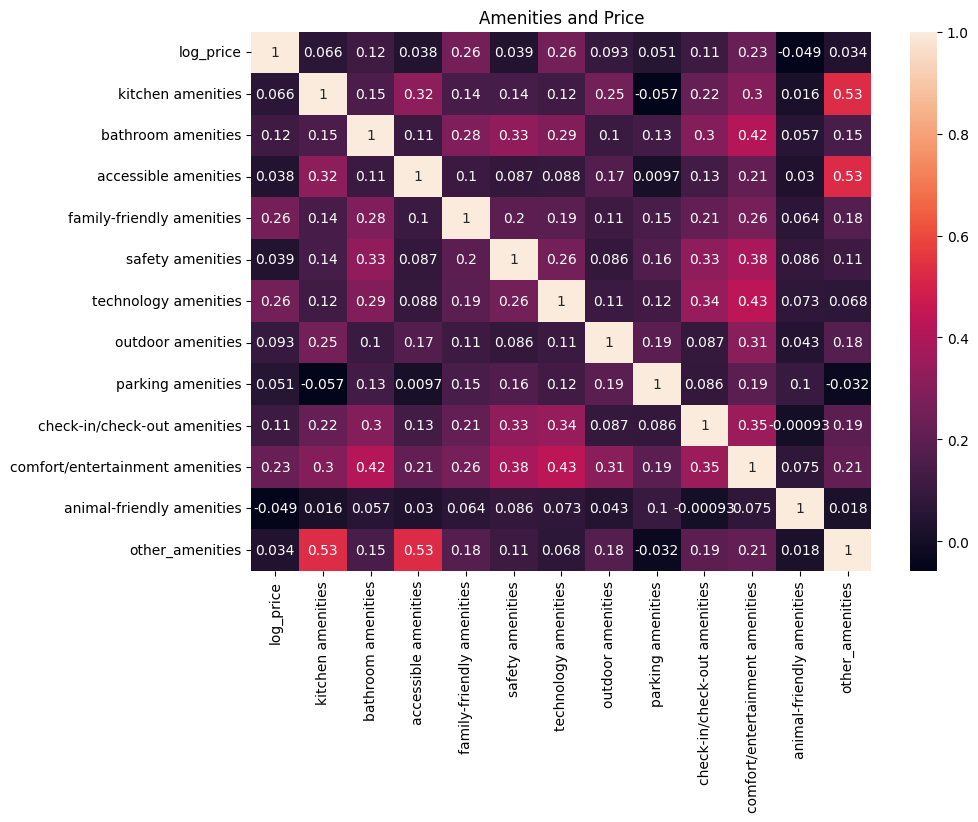

In [ ]:
plt.figure(figsize=(10, 7))
ax = sns.heatmap(air[["log_price", "kitchen amenities",'bathroom amenities', 'accessible amenities','family-friendly amenities', 'safety amenities', 'technology amenities','outdoor amenities', 'parking amenities','check-in/check-out amenities', 'comfort/entertainment amenities','animal-friendly amenities', 'other_amenities']]
    .corr(), annot = True)
ax.set(title = "Amenities and Price")

**Analyzing specific property types**

In villas, there is a correlation of 0.37 between log price per accomodate and outdoor amenities

[Text(0.5, 1.0, 'Amenities and Price in Villas')]

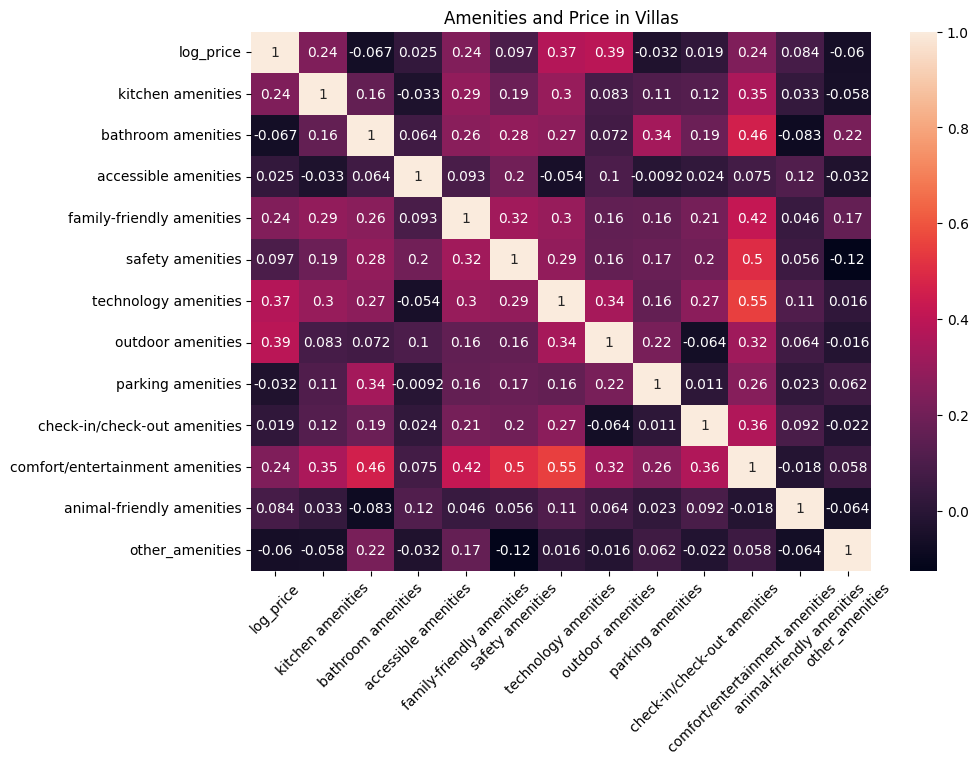

In [ ]:
amenities_and_price_df = air[["log_price", "kitchen amenities",'bathroom amenities', 'accessible amenities','family-friendly amenities', 'safety amenities', 'technology amenities','outdoor amenities', 'parking amenities','check-in/check-out amenities', 'comfort/entertainment amenities','animal-friendly amenities', 'other_amenities']]

plt.figure(figsize=(10, 7))
ax = sns.heatmap(amenities_and_price_df.loc[(air.property_type.isin(["Villa"]))].corr(), annot = True)
plt.xticks(rotation = 45)
ax.set(title = "Amenities and Price in Villas")


##Specific analysis on Pool and Balcony

In [ ]:
df_temp = air.copy()
for i in df_temp.index:
  df_temp.at[i, "has_pool"] = True if "pool" in df_temp.iloc[i].amenities_cleaned else False
  df_temp.at[i, "has_patio_or_balcony"] = True if "patio or balcony" in df_temp.iloc[i].amenities_cleaned else False

The table below shows that the only city with a relevant amount of pool is LA (21% of AIRBNBs listed there)

In [ ]:
df_temp.groupby(["has_pool", "city"]).size()/df_temp.groupby("city").size()

has_pool  city   
False     Boston     0.948236
          Chicago    0.927860
          DC         0.929202
          LA         0.780374
          NYC        0.988843
          SF         0.976584
True      Boston     0.051764
          Chicago    0.072140
          DC         0.070798
          LA         0.219626
          NYC        0.011157
          SF         0.023416
dtype: float64

In [ ]:
df_temp.loc[(df_temp.city == "LA")].groupby([ "has_pool", "property_type" ]).size()/df_temp.loc[df_temp.city == "LA"].groupby("has_pool").size()

has_pool  property_type  
False     Apartment          0.415328
          Bed & Breakfast    0.009810
          Bungalow           0.021168
          Condominium        0.022430
          Dorm               0.006196
          Guest-house        0.020135
          House              0.435693
          Loft               0.016751
          Other              0.021111
          Townhouse          0.026560
          Villa              0.004819
True      Apartment          0.557277
          Bed & Breakfast    0.012230
          Bungalow           0.006523
          Condominium        0.055238
          Dorm               0.000611
          Guest-house        0.016714
          House              0.279861
          Loft               0.023033
          Other              0.007949
          Townhouse          0.026294
          Villa              0.014268
dtype: float64

Here, we focus on the effect of having a pool in LA, the city that has the highest amount of pools. 

<Figure size 1500x800 with 0 Axes>

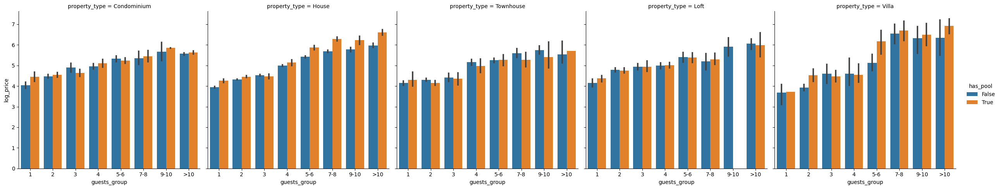

In [ ]:
plt.figure(figsize = (15,8))
ax2 = sns.catplot(data = df_temp[(df_temp.city == "LA") & (df_temp.property_type.isin(["House", "Townhouse", "Aparment", "Condominium", "Townhouse", "Villa", "Loft" ]))],kind = "bar",  x = "guests_group", y = "log_price", hue = "has_pool", col = "property_type", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"])

## Patio/Balcony

This does not appear as relevant as having the pool

<Figure size 5000x800 with 0 Axes>

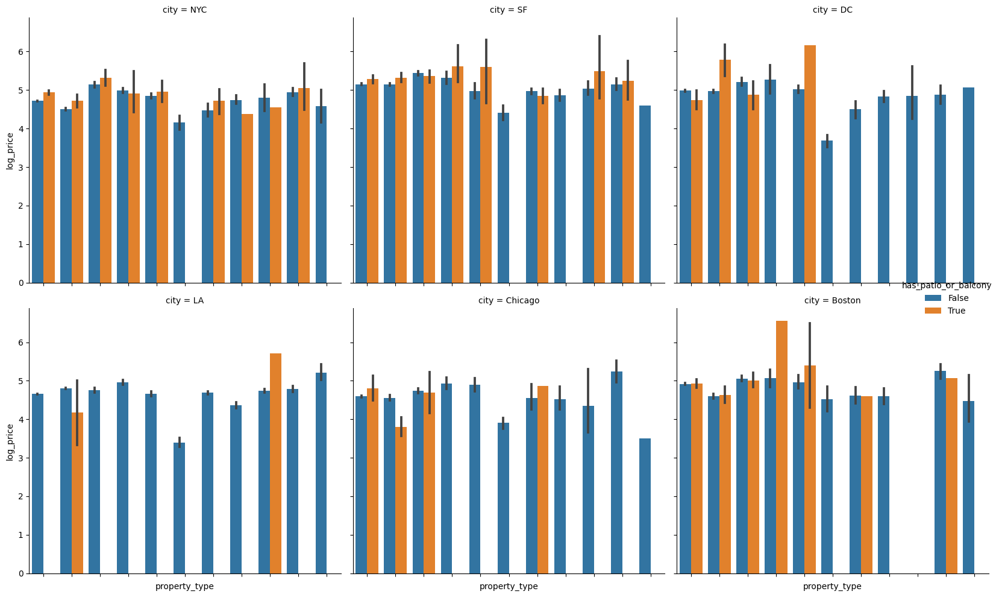

In [ ]:
plt.figure(figsize = (50,8))
ax2 = sns.catplot(data = df_temp, kind = "bar", x = "property_type", y = "log_price", hue = "has_patio_or_balcony", col = "city", col_wrap = 3)
for ax in ax2.axes.flat:
  _ = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.tight_layout()

# Different Neighbourhoods and Distance from the center


## New York

**Calculate and Visualize Median Price vs. Distance from Center for NYC Neighborhoods**

This code calculates the median price and distance from center for each NYC neighborhood and visualizes their relationship.

<ipython-input-7-40d8744cabf7>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["distance"] = np.sqrt((df_NYC["latitude"] - center_lat) ** 2 + (df_NYC["longitude"] - center_long) ** 2)


Correlation is -0.32824553625416464


<Figure size 1200x600 with 0 Axes>

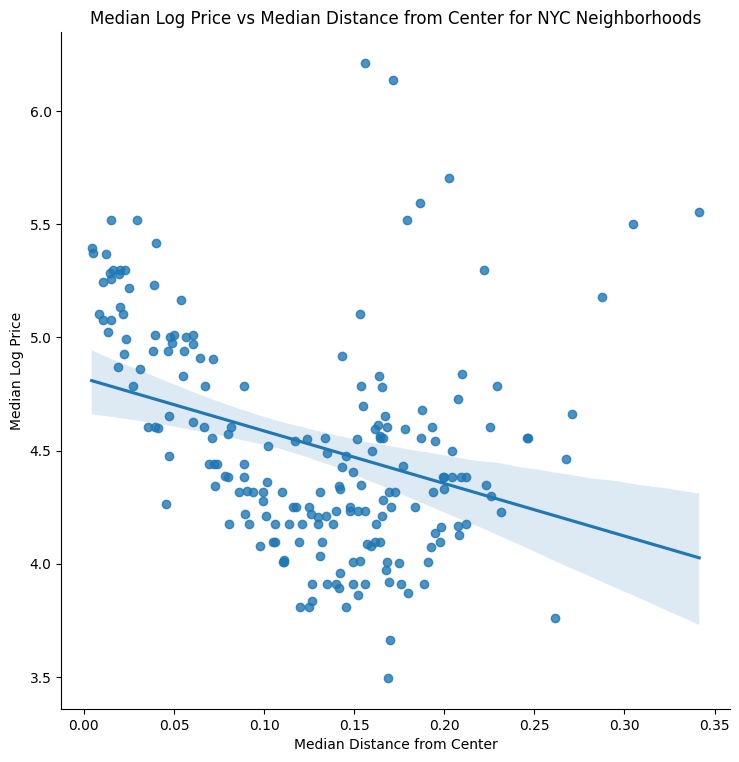

In [ ]:
# Filter for NYC data
df_NYC = air.loc[air.city == "NYC"]

# Flat Iron Building - Center of Manhattan
center_lat = 40.7411
center_long = -73.9897

# Calculate distance from center for each house in New York
df_NYC["distance"] = np.sqrt((df_NYC["latitude"] - center_lat) ** 2 + (df_NYC["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_NYC.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for NYC Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)

**Visualize Median Price vs. Distance for 50% Closest NYC Neighborhoods**

This code filters the 50% closest neighborhoods to the center and visualizes the relationship between median price and distance.

Correlation for the 50% closest neighborhoods to the center is -0.8729116799445072


<Figure size 1200x600 with 0 Axes>

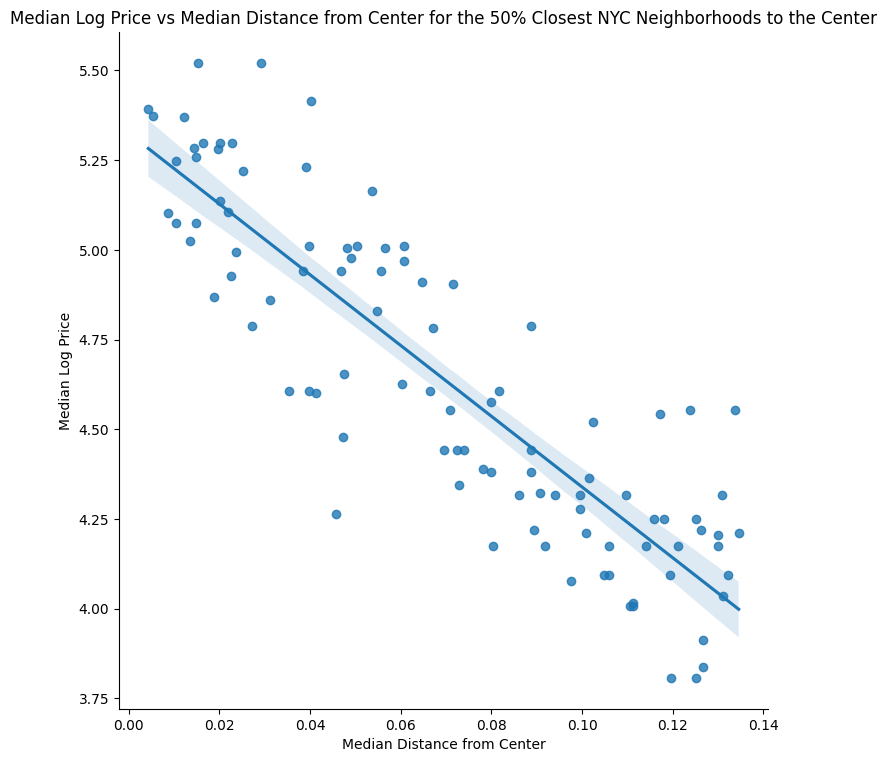

In [ ]:
# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest NYC Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)

**Visualize Median Price vs. Distance for Neighborhood Distance Groups in NYC**

This code creates distance groups for neighborhoods, calculates median price and distance, and visualizes the relationship for each group.

<ipython-input-9-671b4cef2797>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["distance_group"] = df_NYC["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.8729116799445074
Correlation for neighborhoods far from the center is 0.3098894421716602


<Figure size 1200x600 with 0 Axes>

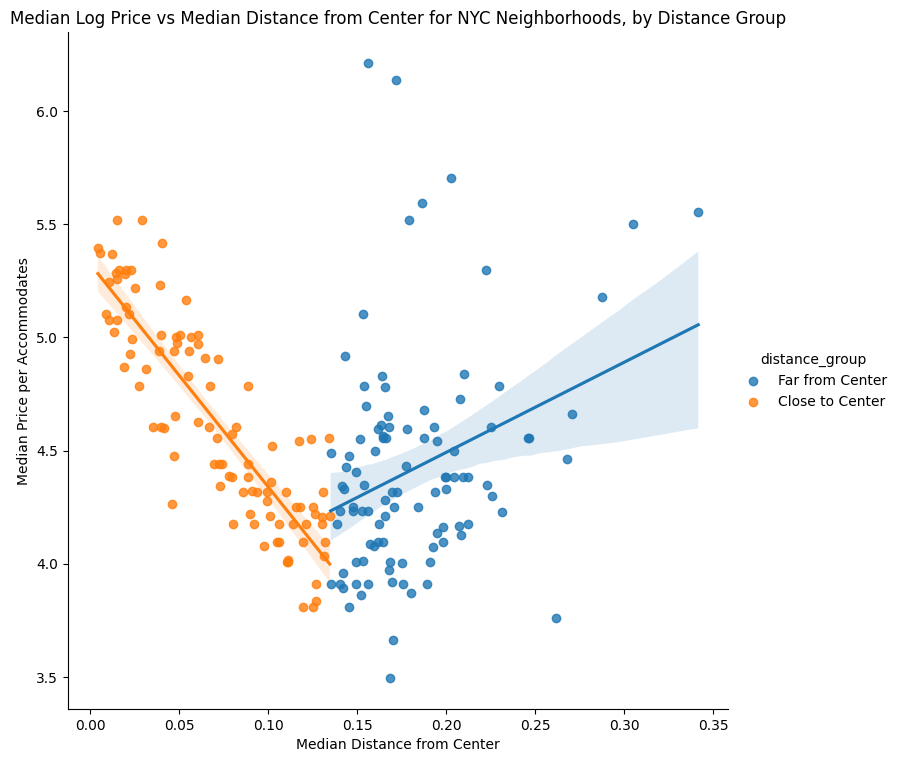

In [ ]:
# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_NYC["distance_group"] = df_NYC["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_NYC.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for NYC Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)

**Visualize Median Price vs. Distance for NYC Neighborhoods, per Number of Guests**

This code groups houses based on the number of guests, calculates median price and distance, and visualizes the relationship for each group.

<ipython-input-10-81e49f4c6b5e>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["guests_group"] = df_NYC["accommodates"].apply(group_guests)


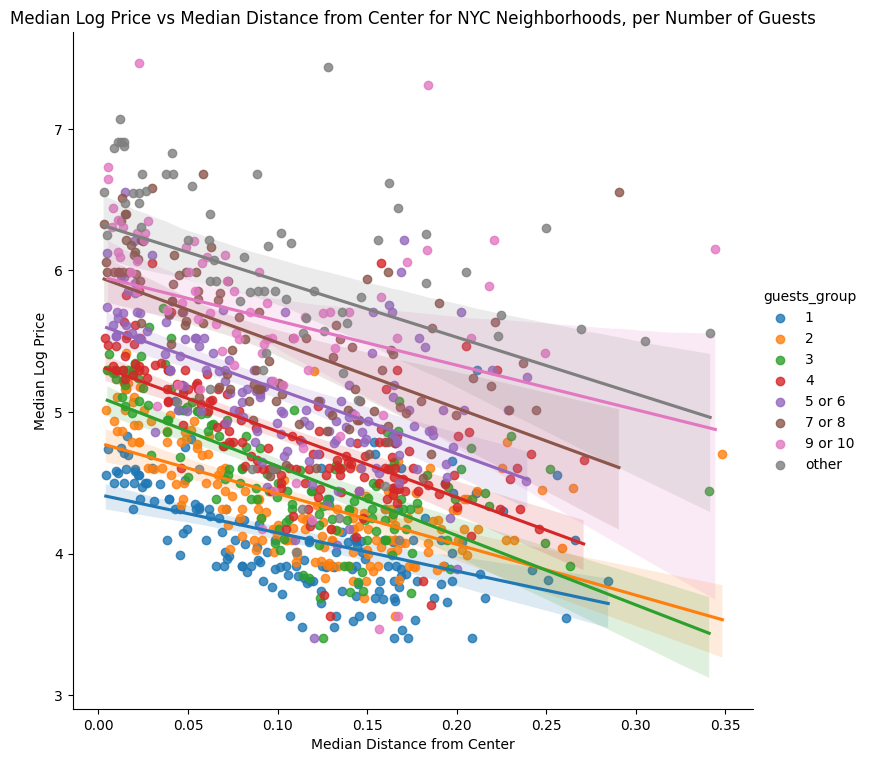

Correlation between Median Price and Median Distance from Center for
1: -0.462861165682336
2: -0.6062478816229673
3: -0.6774814698873877
4: -0.653871977014815
5 or 6: -0.5478485059592246
7 or 8: -0.5641245191558976
9 or 10: -0.2964220331906521
other: -0.38746104811713894


In [ ]:
# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_NYC["guests_group"] = df_NYC["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_NYC.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for NYC Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")

**Visualize Median Price vs. Distance for 50% Closest NYC Neighborhoods, per Number of Guests**

This code filters the 50% closest neighborhoods, groups houses based on the number of guests, and visualizes the relationship between median price and distance for each group.

<ipython-input-11-930315ac20de>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["guests_group"] = df_NYC["accommodates"].apply(group_guests)


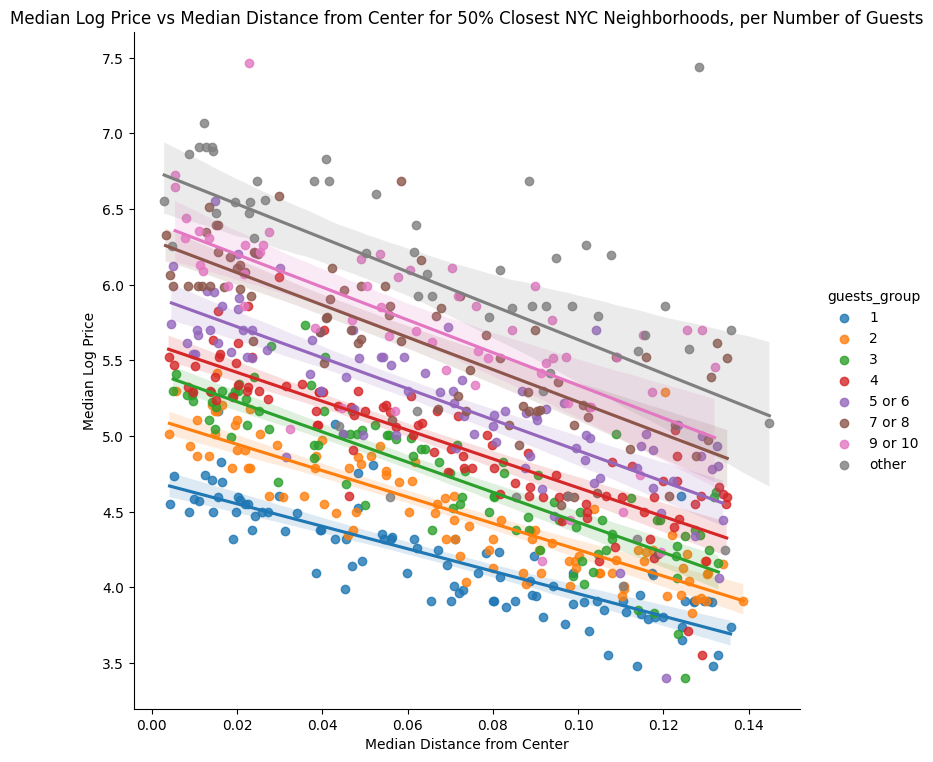

Correlation between Median Price and Median Distance from Center for
1: -0.8231116251755147
2: -0.8468704923776433
3: -0.8513291699682611
4: -0.8523409510294676
5 or 6: -0.7979076927767286
7 or 8: -0.7796618147455864
9 or 10: -0.6733562763753678
other: -0.5883471744487638


In [ ]:
df_NYC["guests_group"] = df_NYC["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_NYC.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the city center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_NYC for the closest neighborhoods
df_NYC_closest = df_NYC[df_NYC["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_NYC_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest NYC Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")

**Visualize Median Price vs. Distance for Different Property Types in NYC Neighborhoods, per Number of Guests**

This code groups houses by property type, calculates median price and distance for each group, and visualizes the relationship between price and distance for each property type and number of guests.

<ipython-input-12-607ec4e2df3d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["property_type_group"] = df_NYC["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


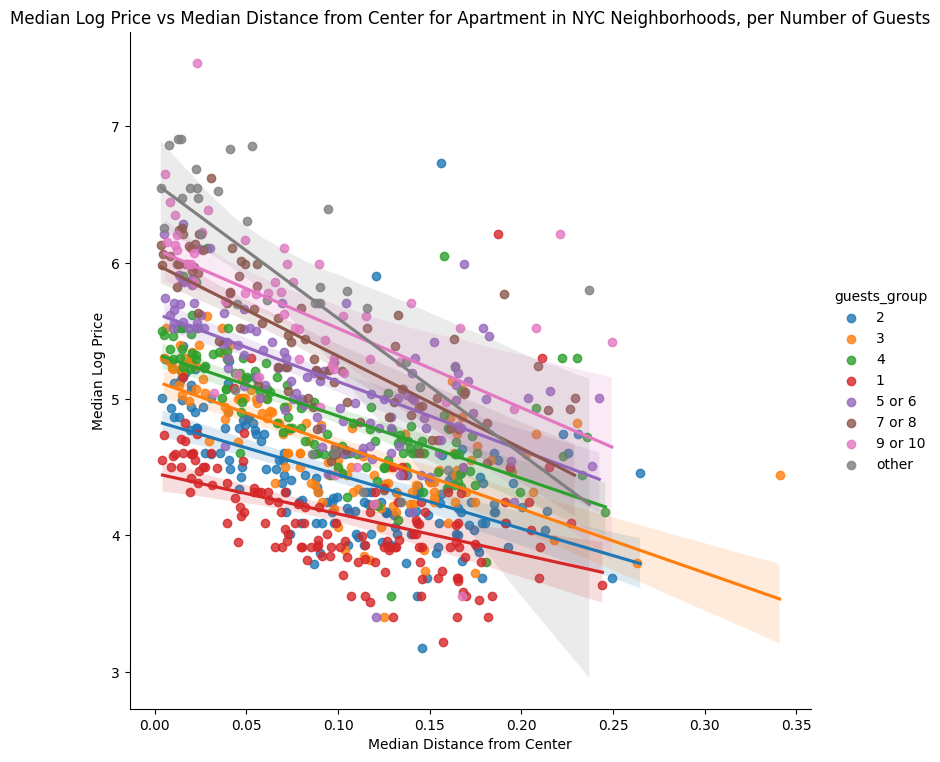

Correlation between Median Price and Median Distance from Center for Apartment
1: -0.4180025785053752
2: -0.5289081875813632
3: -0.6624456361995513
4: -0.6470120803954553
5 or 6: -0.6229288597675993
7 or 8: -0.7323614878886694
9 or 10: -0.5336541760607383
other: -0.6716781492021671




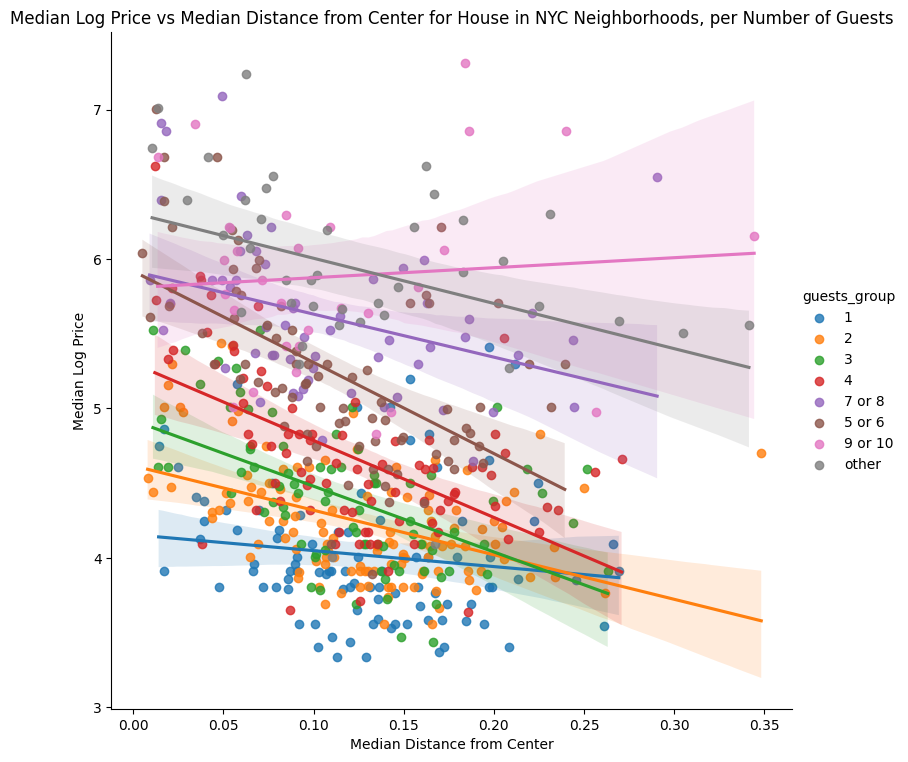

Correlation between Median Price and Median Distance from Center for House
1: -0.1326556180986845
2: -0.4376437684557806
3: -0.5263154736407528
4: -0.5575966969906279
5 or 6: -0.5617166468373698
7 or 8: -0.35649343669547134
9 or 10: 0.07781572892602802
other: -0.360805420230789




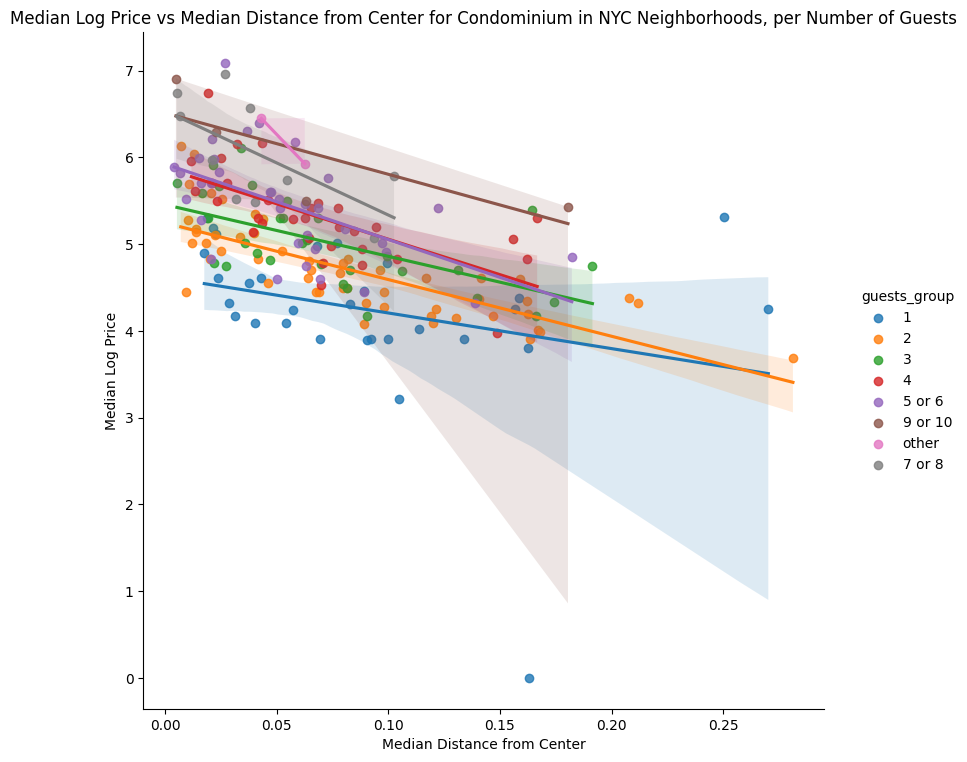

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.28162773129464813
2: -0.7777257431927652
3: -0.5994694285910657
4: -0.6577431256314996
5 or 6: -0.5581919879201738
7 or 8: -0.6394811064198797
9 or 10: -0.7946237320895129
other: -1.0




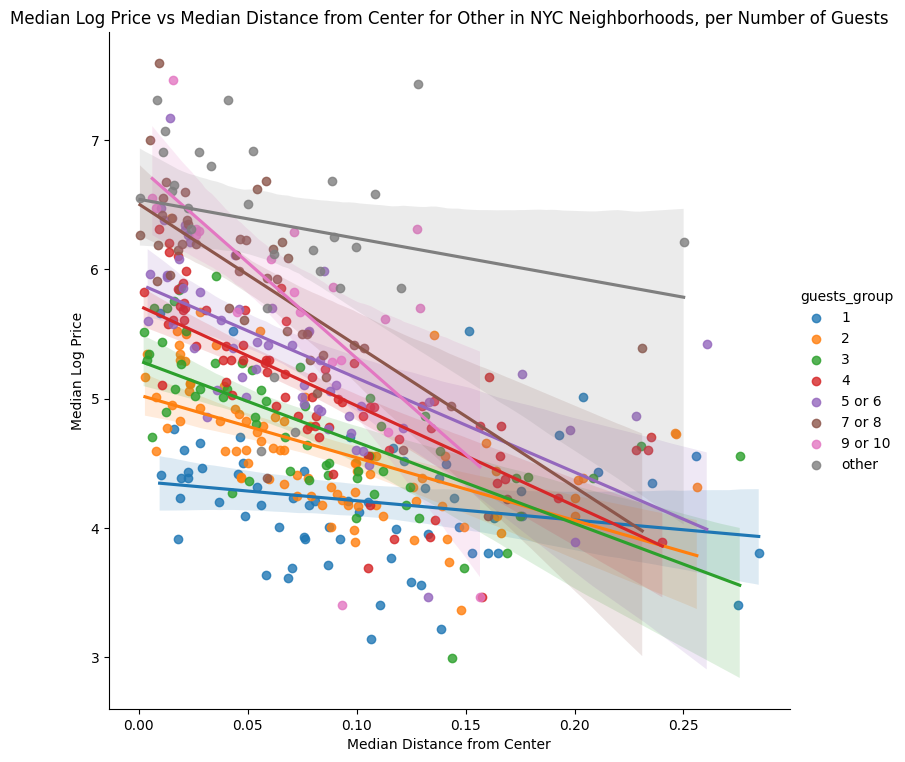

Correlation between Median Price and Median Distance from Center for Other
1: -0.20280169849767138
2: -0.5751257920021091
3: -0.6699311496745068
4: -0.7568268720367508
5 or 6: -0.6293705461623951
7 or 8: -0.7370304141309149
9 or 10: -0.6742323366764033
other: -0.22228320864251772




In [ ]:
# Group property types
df_NYC["property_type_group"] = df_NYC["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_NYC.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in NYC Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")

**Visualize Median Price vs. Distance for Different Property Types in NYC Neighborhoods, per Number of Guests for the closest 50% Neighborhoods to the city center**

<ipython-input-13-bd262a57e335>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["distance"] = np.sqrt((df_NYC["latitude"] - center_lat) ** 2 + (df_NYC["longitude"] - center_long) ** 2)
<ipython-input-13-bd262a57e335>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["property_type_group"] = df_NYC["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")


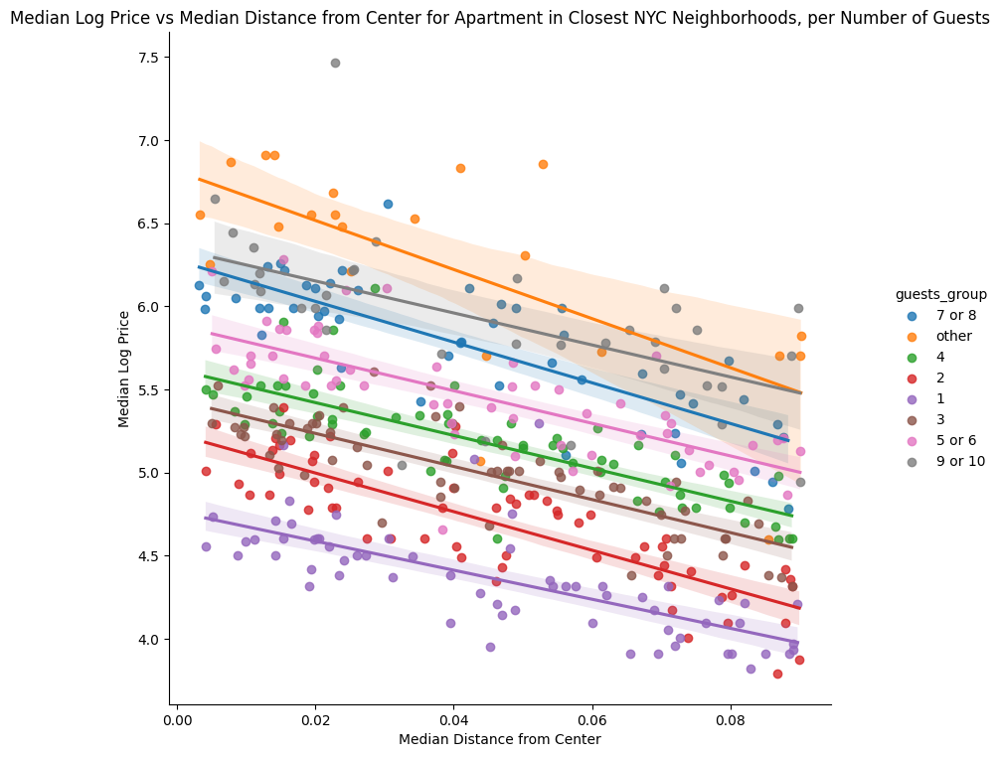

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: -0.7111051609436561
2: -0.8315261919121769
3: -0.8051724500233494
4: -0.7869522649725615
5 or 6: -0.7391619965893308
7 or 8: -0.8048033167436339
9 or 10: -0.5588223786296038
other: -0.682619614787452




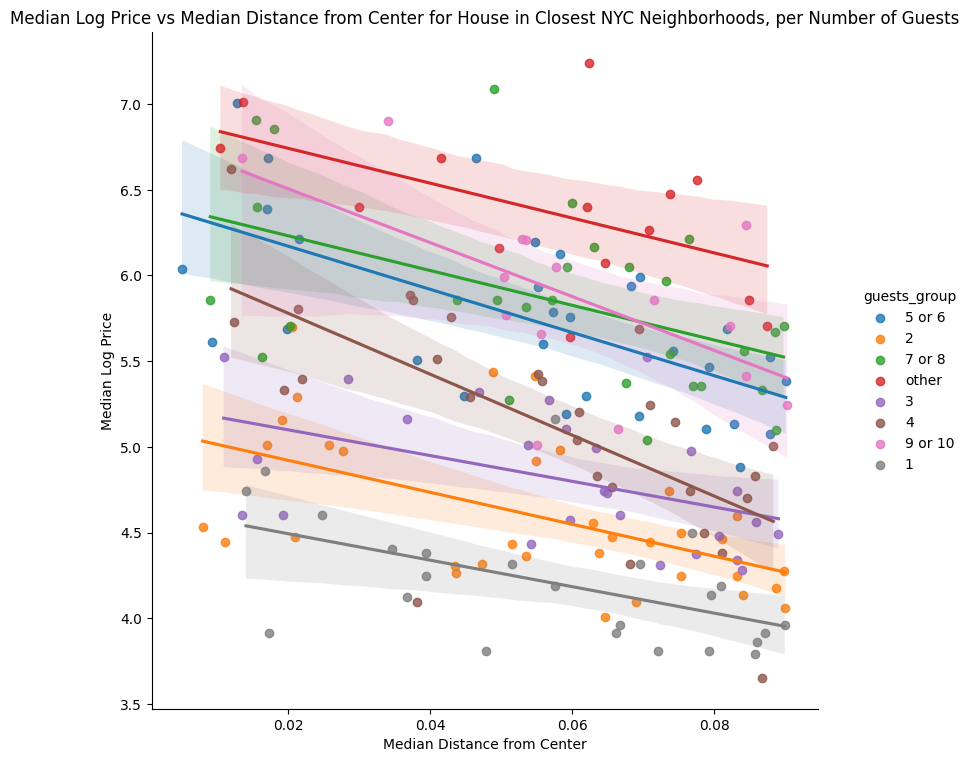

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: -0.5138970517148468
2: -0.538042748569959
3: -0.46923385715480725
4: -0.6708796907800267
5 or 6: -0.6317375571021282
7 or 8: -0.4897255097077353
9 or 10: -0.5912650648353877
other: -0.5325577188720393




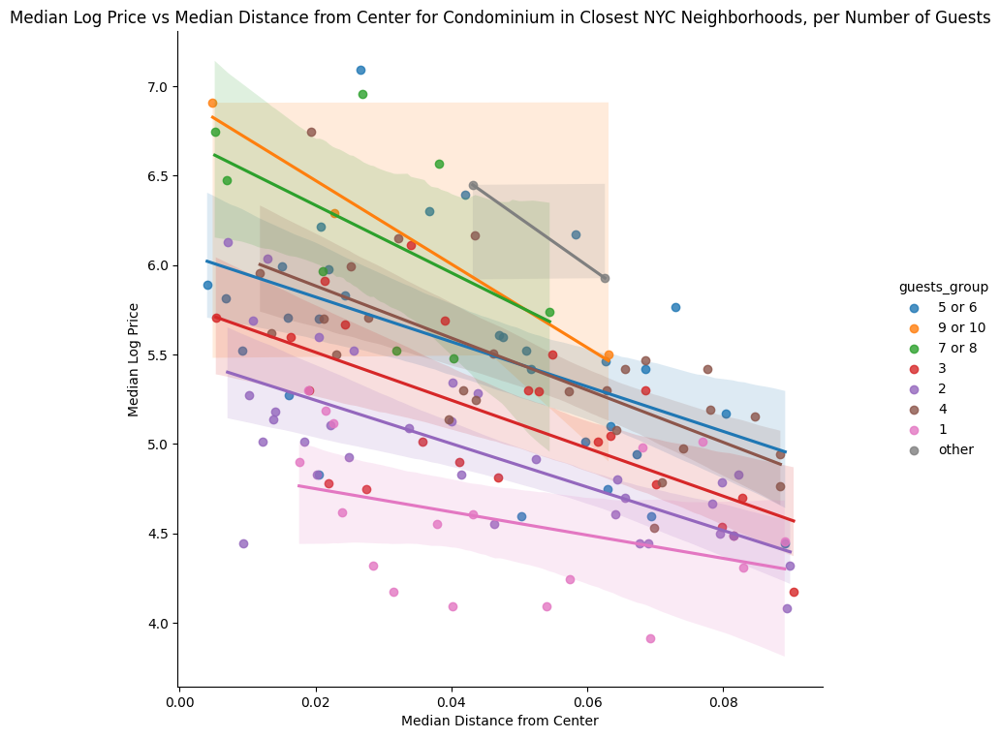

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.36106516094129376
2: -0.7121188843723594
3: -0.6583174475346092
4: -0.7237992416504206
5 or 6: -0.5044950862555183
7 or 8: -0.5516798267536723
9 or 10: -0.9890343404408353
other: -1.0




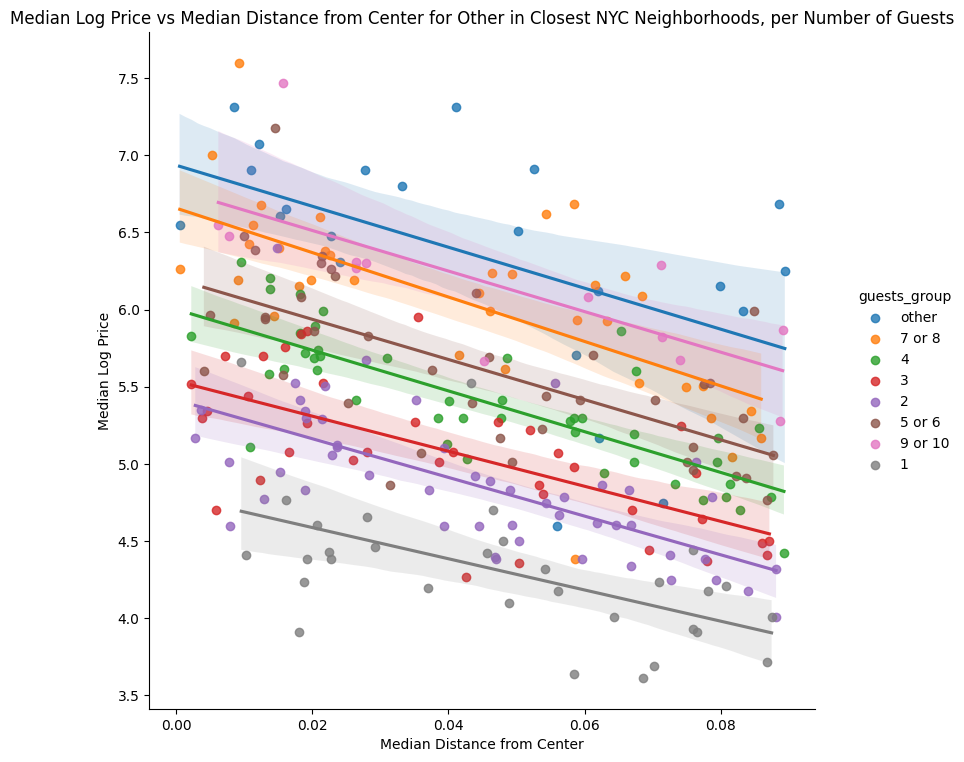

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: -0.5470457248160546
2: -0.6737142093757208
3: -0.6596158753038103
4: -0.7916560763893663
5 or 6: -0.6581060236705467
7 or 8: -0.655643974885587
9 or 10: -0.7382360709256155
other: -0.5071512205955142




In [ ]:
# Calculate distance from center for each house in New York
df_NYC["distance"] = np.sqrt((df_NYC["latitude"] - center_lat) ** 2 + (df_NYC["longitude"] - center_long) ** 2)

# Group property types
df_NYC["property_type_group"] = df_NYC["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_NYC.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest NYC Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")

**Visualize on a map the median price in each neighbourhood, the bigger the circle, th ehigher the price**

In [ ]:
import folium 

# Calculate median price for each neighborhood
df_NYC["price"] = np.exp(df_NYC["log_price"])
median_price_neighbourhood = df_NYC.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_NYC.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
nyc_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(nyc_map)

# Display the map
nyc_map

<ipython-input-23-4b0f63358ed7>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["price"] = np.exp(df_NYC["log_price"])


## Los Angeles 
#### Correlation between median price per accomodates in neighbourhood and median distance from center in neihbourhood

Los Angeles does not seem to have any correlation to the distance from the city center.

In [ ]:
center_lat = 34.0488
center_long = -118.243683

<ipython-input-53-daefb6c29d5b>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)


Correlation is 0.018255236684198595
Correlation for the 50% closest neighborhoods to the center is -0.01936214622110588


<ipython-input-53-daefb6c29d5b>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["distance_group"] = df_LA["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.019362146221105898
Correlation for neighborhoods far from the center is 0.06057034710048627


<ipython-input-53-daefb6c29d5b>:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)
<ipython-input-53-daefb6c29d5b>:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["guests_group"] = df_LA["accommodates"].apply(group_guests)


<Figure size 1200x600 with 0 Axes>

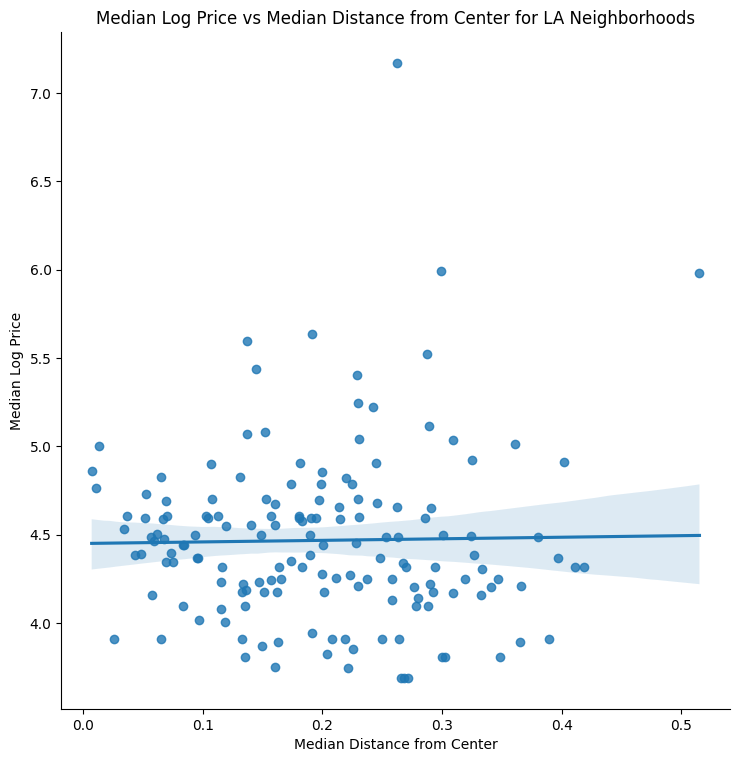

<Figure size 1200x600 with 0 Axes>

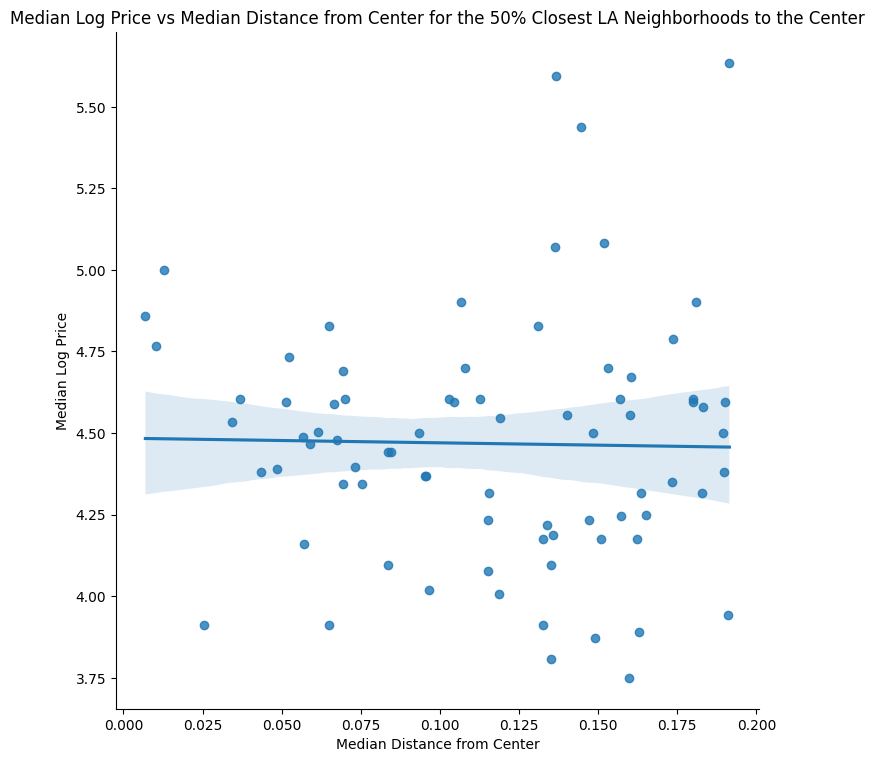

<Figure size 1200x600 with 0 Axes>

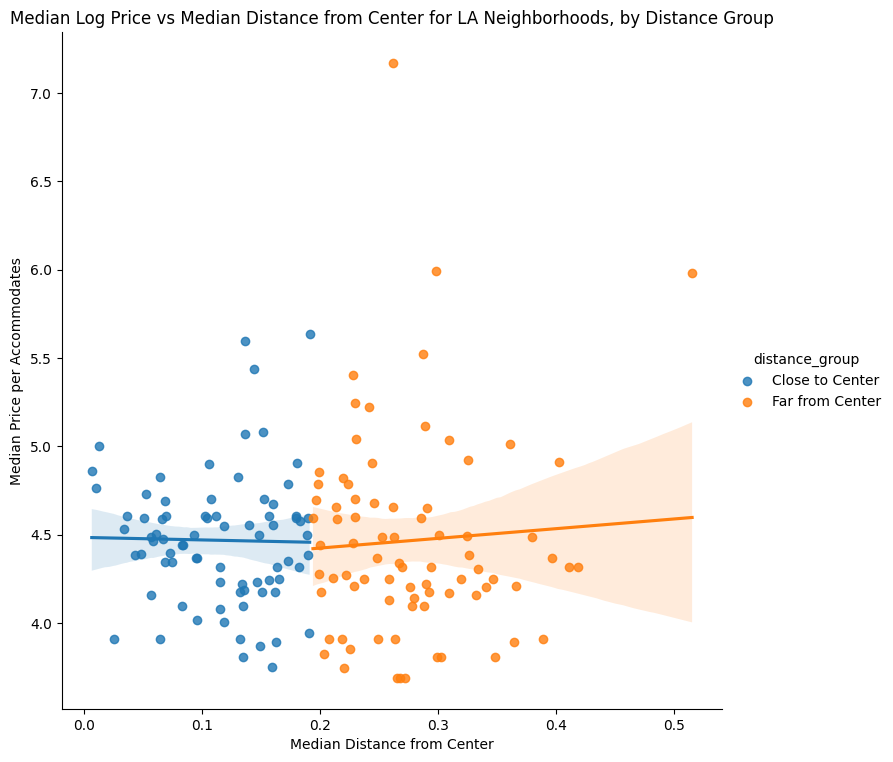

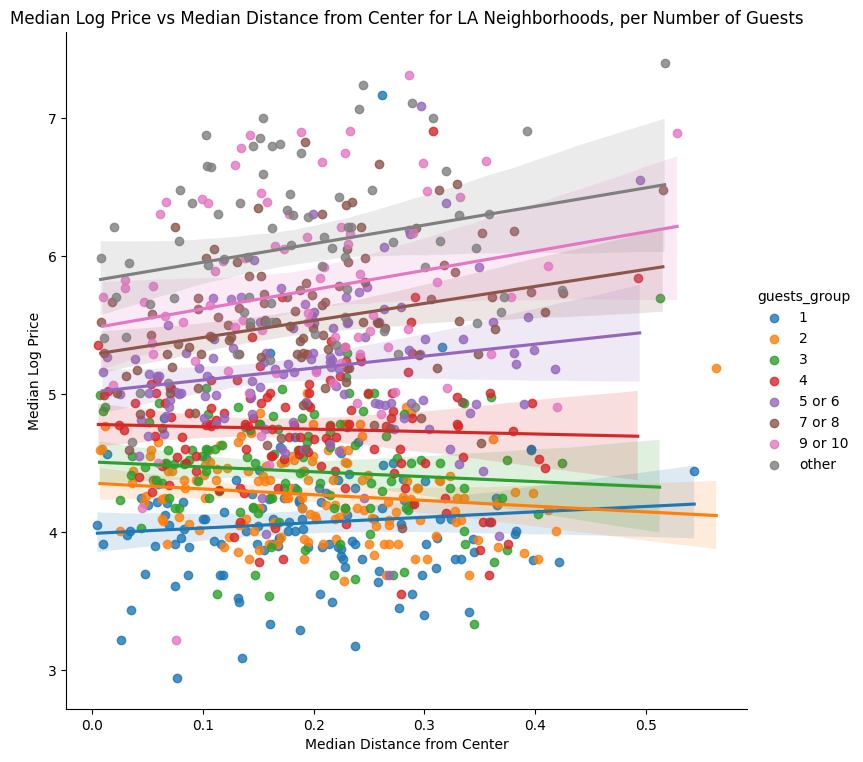

Correlation between Median Price and Median Distance from Center for
1: 0.0844110219549869
2: -0.13947320646988376
3: -0.09001642787843285
4: -0.03863064703084836
5 or 6: 0.17403329628083453
7 or 8: 0.25673564708293506
9 or 10: 0.20300071339463224
other: 0.24375259780158245


<ipython-input-53-daefb6c29d5b>:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["guests_group"] = df_LA["accommodates"].apply(group_guests)


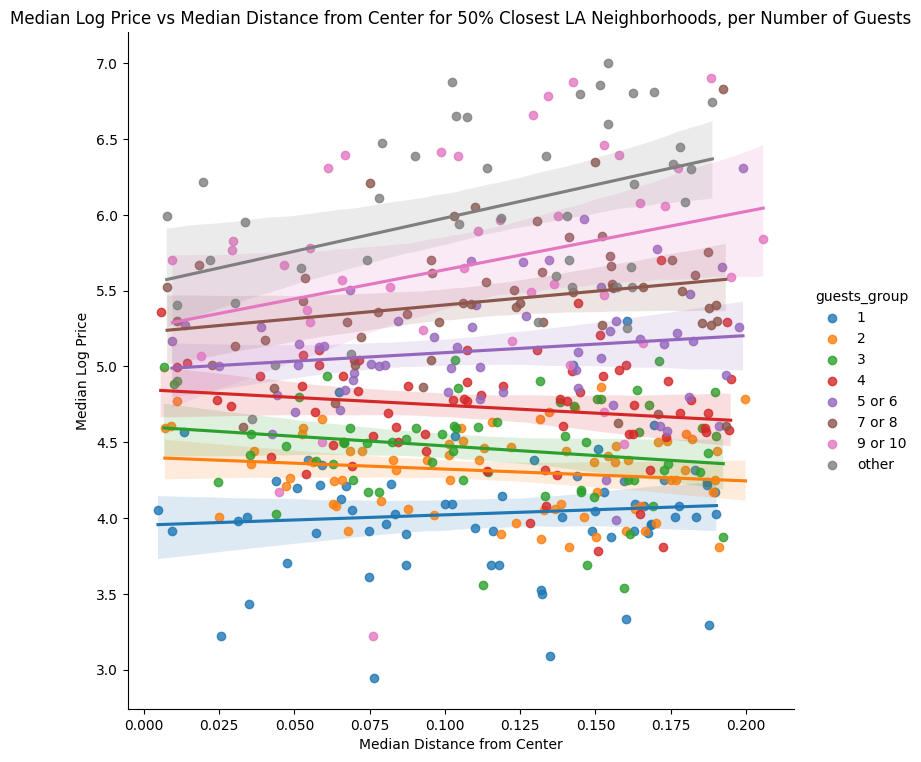

Correlation between Median Price and Median Distance from Center for
1: 0.090464884646486
2: -0.1524885281661835
3: -0.19397753592507908
4: -0.1500304935365083
5 or 6: 0.14867344016483175
7 or 8: 0.2325277741249761
9 or 10: 0.2676859775167609
other: 0.4104259961599108


<ipython-input-53-daefb6c29d5b>:146: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["property_type_group"] = df_LA["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


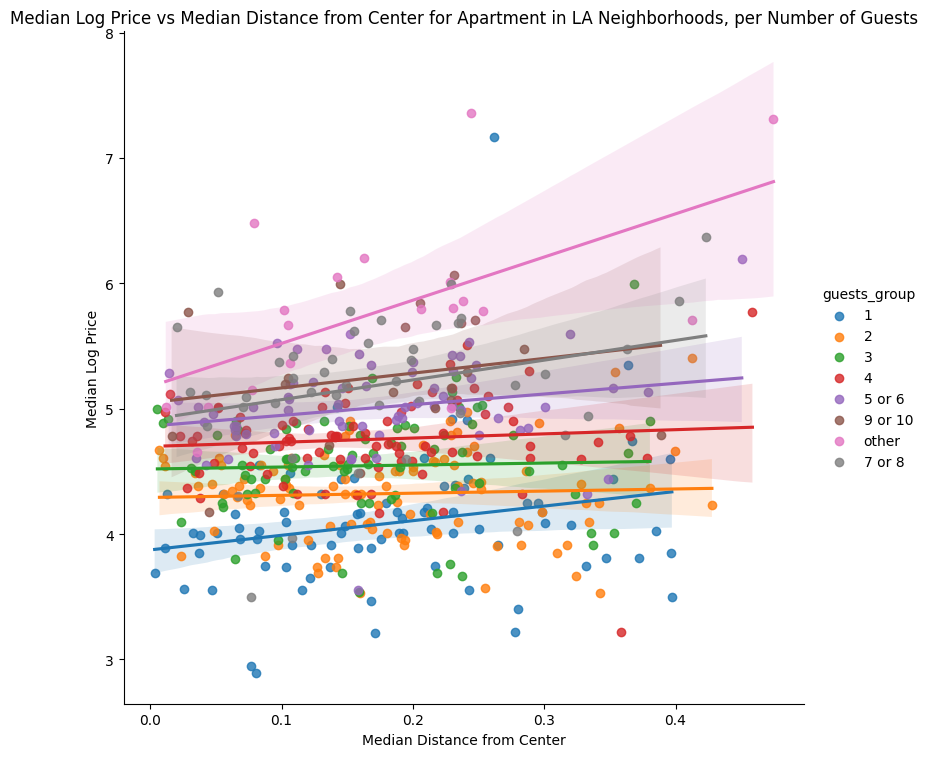

Correlation between Median Price and Median Distance from Center for Apartment
1: 0.22370042578004776
2: 0.04606132210626378
3: 0.036385859725157586
4: 0.09195807859900347
5 or 6: 0.21273069278616896
7 or 8: 0.2805820648145926
9 or 10: 0.20909895180623306
other: 0.5864046983218438




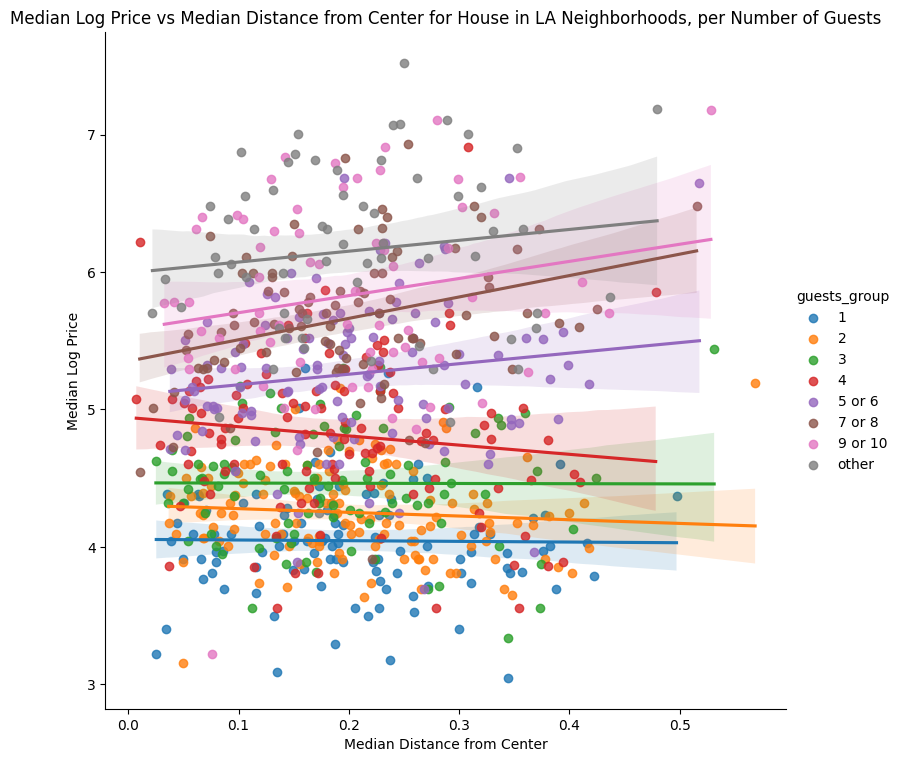

Correlation between Median Price and Median Distance from Center for House
1: -0.012631205538590356
2: -0.07945815275252432
3: -0.0035994533779840077
4: -0.12069646763821336
5 or 6: 0.1408228964791826
7 or 8: 0.30600435605733384
9 or 10: 0.18654795448231132
other: 0.12464528546852964




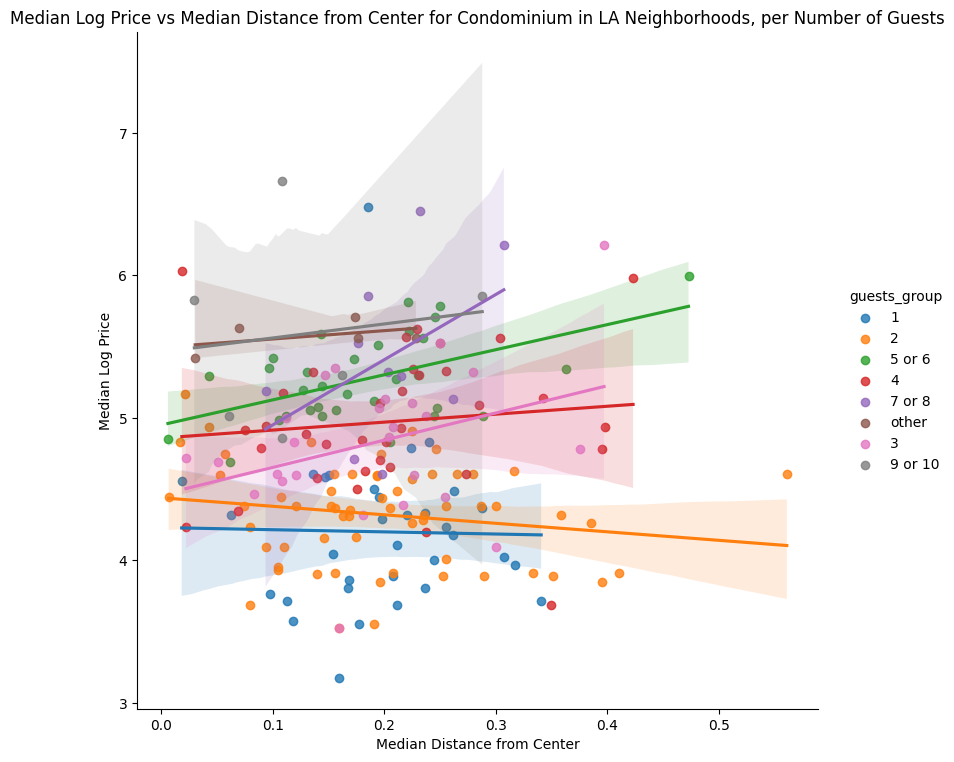

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.019049587556987435
2: -0.17884673841386656
3: 0.3338324068308632
4: 0.11389868060245628
5 or 6: 0.5224930673488385
7 or 8: 0.4356025332069217
9 or 10: 0.134486532770539
other: 0.45123194132991185




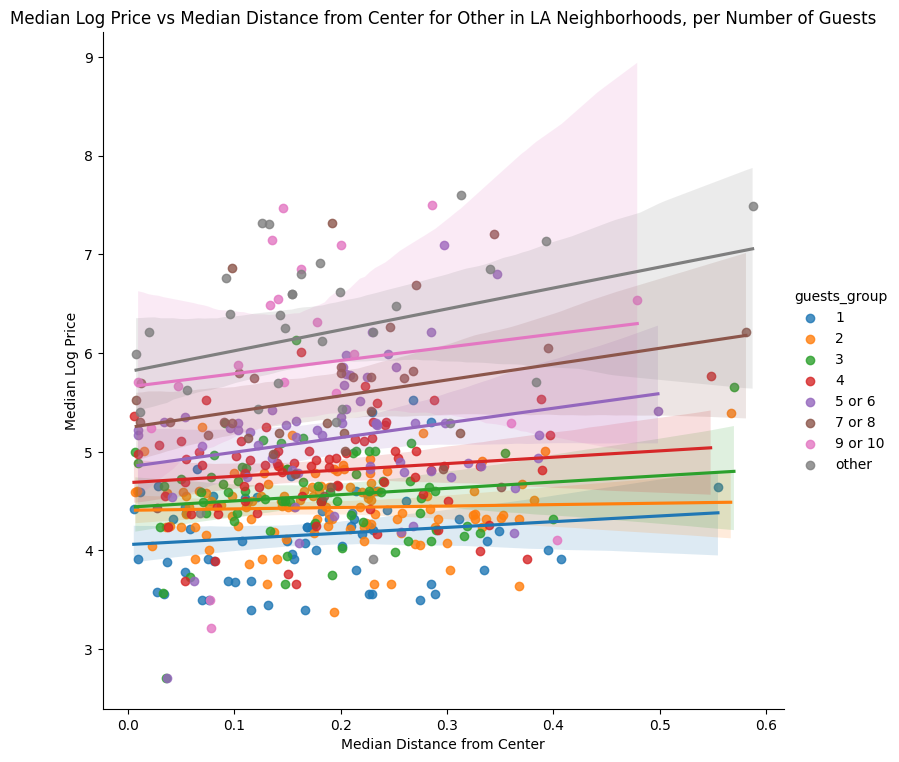

Correlation between Median Price and Median Distance from Center for Other
1: 0.13448494897018487
2: 0.042749113463276596
3: 0.13158860833847943
4: 0.14426557835611942
5 or 6: 0.22041483223490568
7 or 8: 0.2755416271937257
9 or 10: 0.13813266642862565
other: 0.3064849079216344




<ipython-input-53-daefb6c29d5b>:177: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)
<ipython-input-53-daefb6c29d5b>:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["property_type_group"] = df_LA["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")


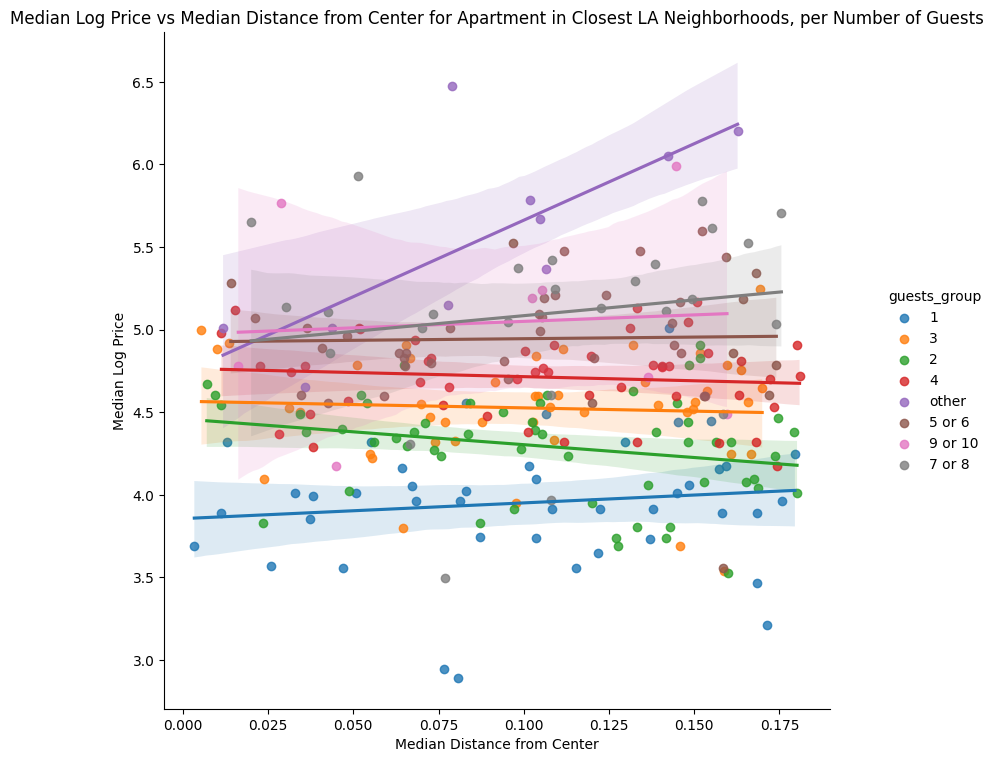

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: 0.12077514059458681
2: -0.2422693847120004
3: -0.05695110449627967
4: -0.10312408616264859
5 or 6: 0.02524892423970955
7 or 8: 0.1597135321001964
9 or 10: 0.06974501396535661
other: 0.7339312735272822




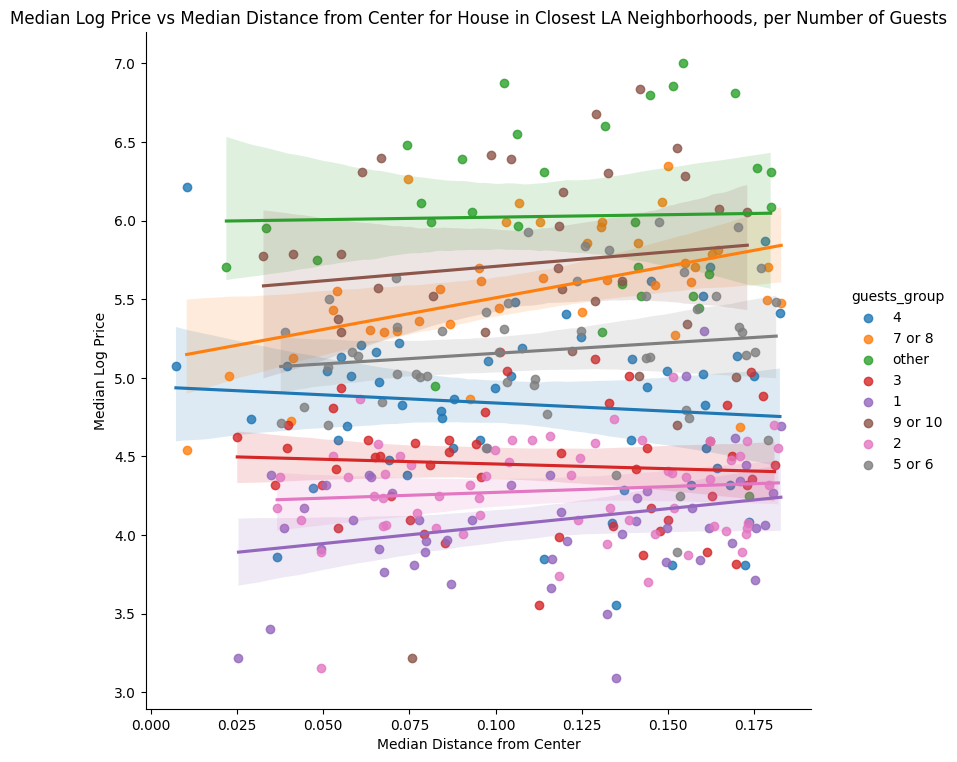

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: 0.2687210061087087
2: 0.1042658681390736
3: -0.0747292156218559
4: -0.09281073990482497
5 or 6: 0.13328999560268895
7 or 8: 0.4460436746777915
9 or 10: 0.1073580810453226
other: 0.022374398499760445




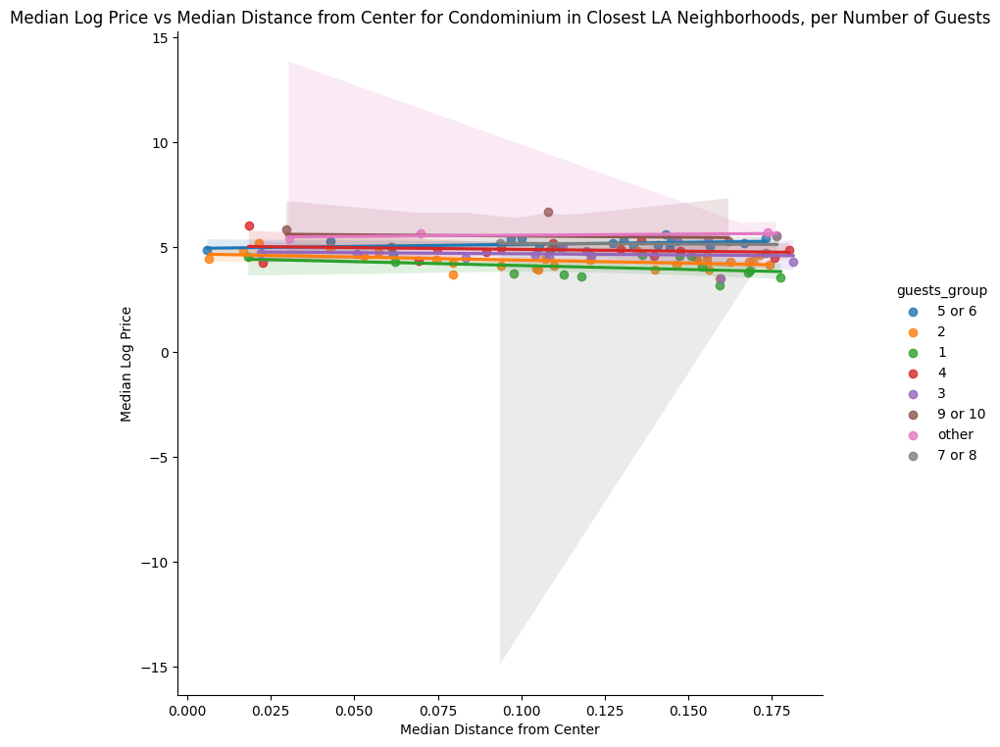

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.36189000374482805
2: -0.40727691730750154
3: -0.10612364598920992
4: -0.19141215297712033
5 or 6: 0.38416435892818457
7 or 8: -0.06499677668978114
9 or 10: -0.08017704954002329
other: 0.6377690294657739




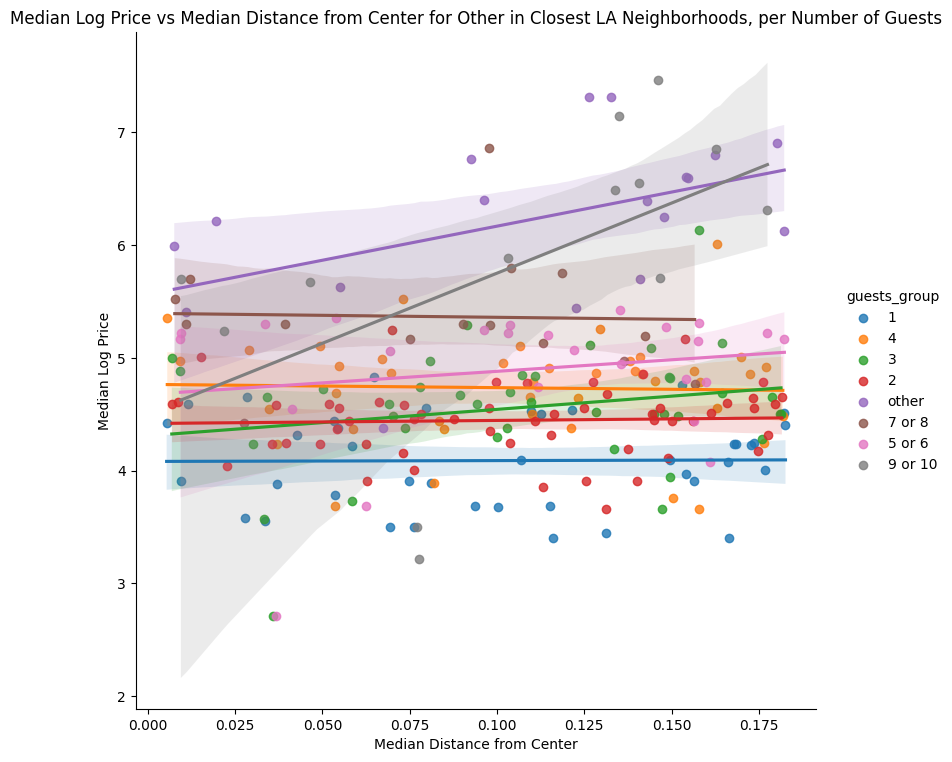

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: 0.010264481833826758
2: 0.04357802492845794
3: 0.21587257362708706
4: -0.030986270507055866
5 or 6: 0.1783086056518855
7 or 8: -0.0323188405269332
9 or 10: 0.5365651725405104
other: 0.4681545763577768




<ipython-input-53-daefb6c29d5b>:219: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["price"] = np.exp(df_LA["log_price"])


In [ ]:
# Filter for LA data
df_LA = air.loc[air.city == "LA"]

# Calculate distance from center for each house in LA
df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_LA.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for LA Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest LA Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_LA["distance_group"] = df_LA["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_LA.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for LA Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)


# Calculate distance from center for each house in LA
df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)

# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_LA["guests_group"] = df_LA["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_LA.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for LA Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




df_LA["guests_group"] = df_LA["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_LA.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the LA center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_LA for the closest neighborhoods
df_LA_closest = df_LA[df_LA["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_LA_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest LA Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




# Group property types
df_LA["property_type_group"] = df_LA["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_LA.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in LA Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




# Calculate distance from center for each house in LA
df_LA["distance"] = np.sqrt((df_LA["latitude"] - center_lat) ** 2 + (df_LA["longitude"] - center_long) ** 2)

# Group property types
df_LA["property_type_group"] = df_LA["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_LA.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest LA Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




import folium 

# Calculate median price for each neighborhood
df_LA["price"] = np.exp(df_LA["log_price"])
median_price_neighbourhood = df_LA.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_LA.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
LA_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opaLA=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(LA_map)

# Display the map
LA_map

## DC

In [ ]:
center_lat = 38.9096
center_long = -77.0296

<ipython-input-51-2e9e03cda2a4>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)


Correlation is -0.3129196870170065
Correlation for the 50% closest neighborhoods to the center is -0.29941086569250036


<ipython-input-51-2e9e03cda2a4>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["distance_group"] = df_DC["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.2994108656925004
Correlation for neighborhoods far from the center is -0.20911833158042603


<ipython-input-51-2e9e03cda2a4>:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)
<ipython-input-51-2e9e03cda2a4>:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["guests_group"] = df_DC["accommodates"].apply(group_guests)


<Figure size 1200x600 with 0 Axes>

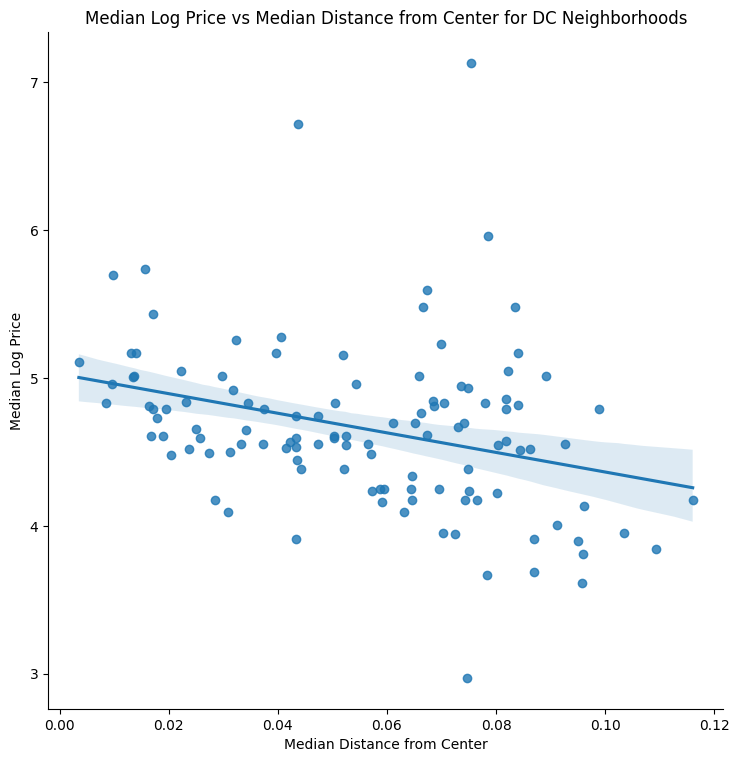

<Figure size 1200x600 with 0 Axes>

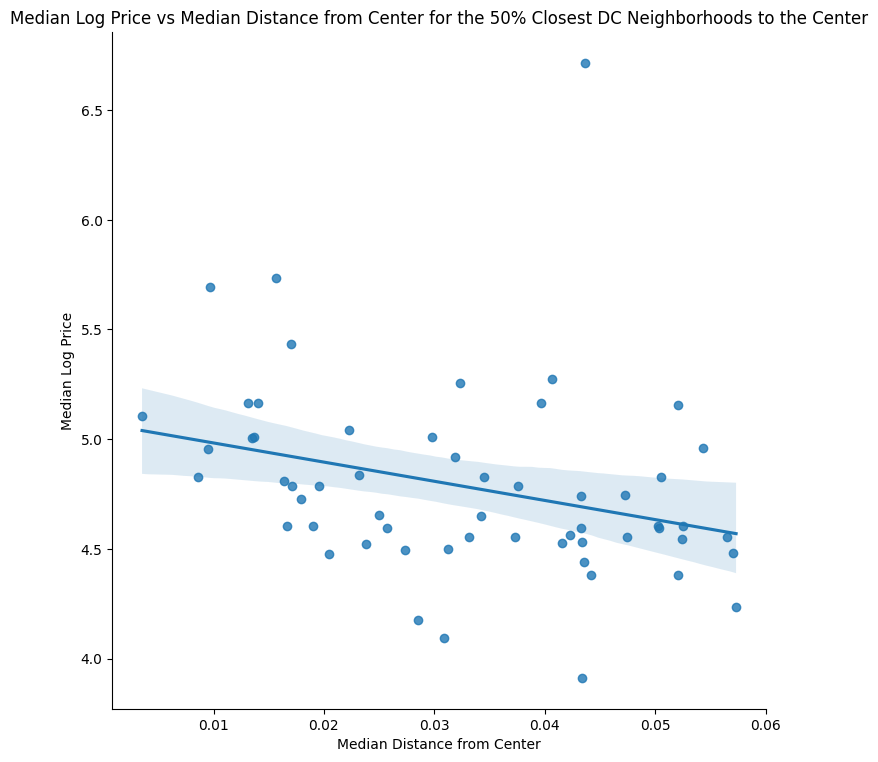

<Figure size 1200x600 with 0 Axes>

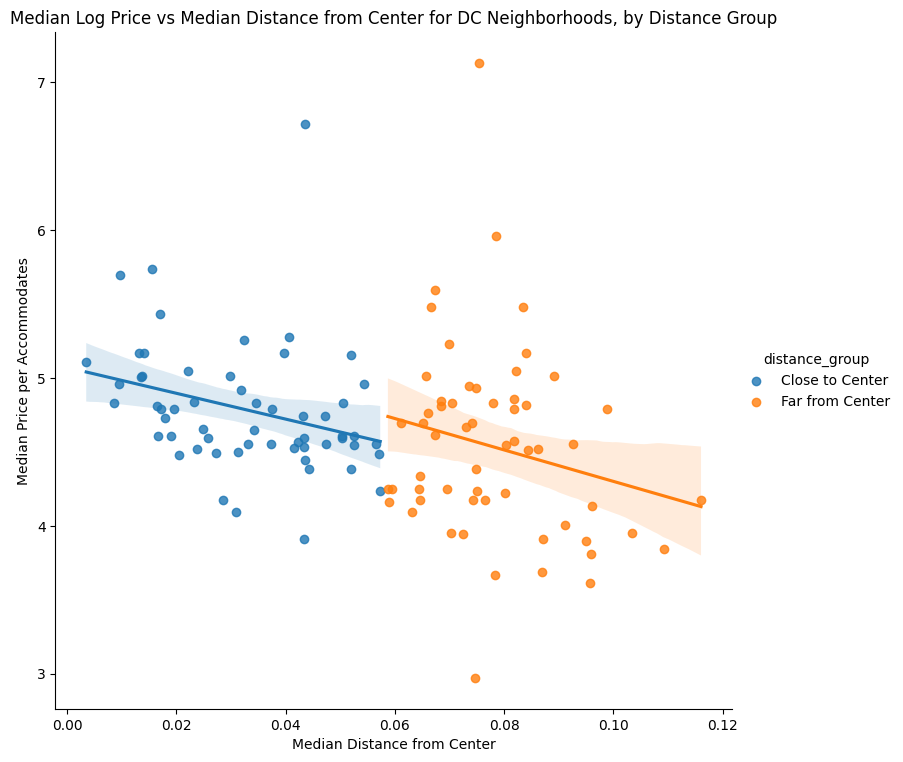

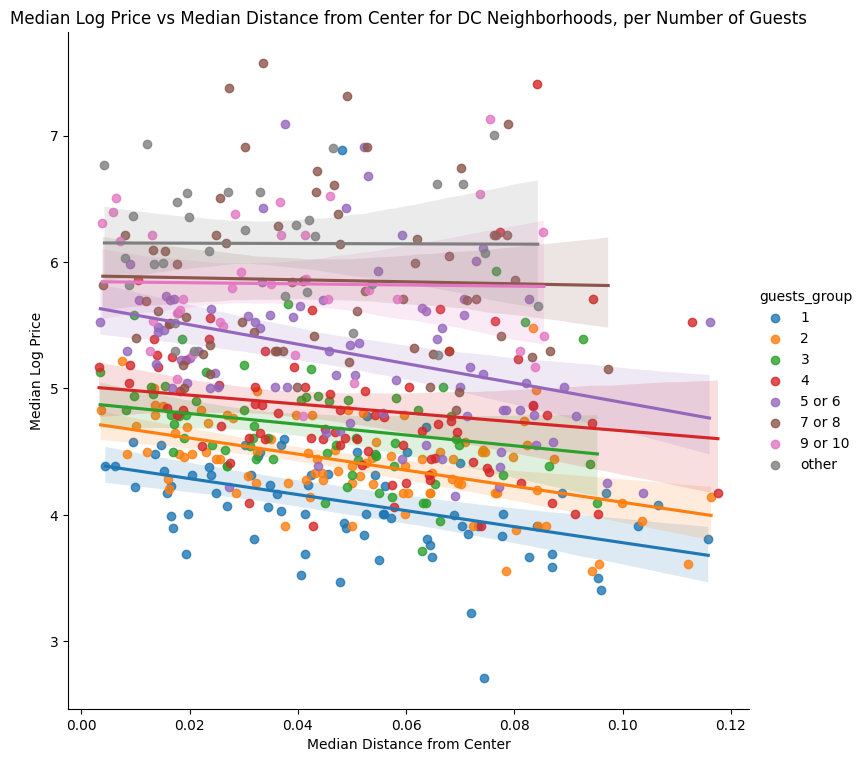

Correlation between Median Price and Median Distance from Center for
1: -0.34604044464722256
2: -0.48862671882692044
3: -0.2297740069010309
4: -0.16756770856525396
5 or 6: -0.3238146063038513
7 or 8: -0.029082137176335062
9 or 10: -0.02076297848169861
other: -0.0056258454690278886


<ipython-input-51-2e9e03cda2a4>:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["guests_group"] = df_DC["accommodates"].apply(group_guests)


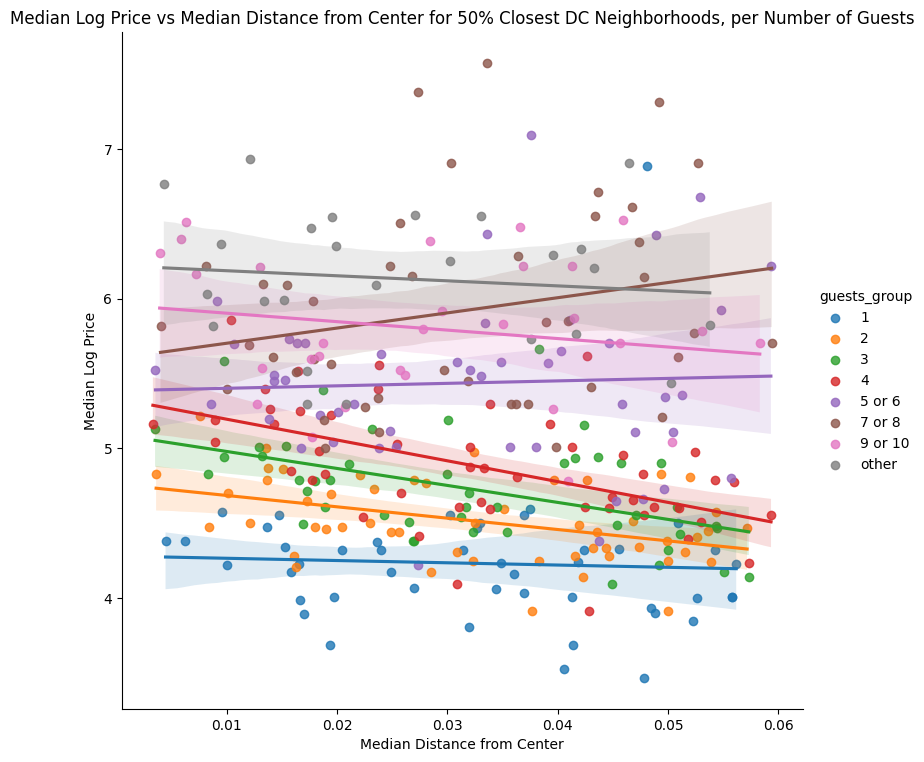

Correlation between Median Price and Median Distance from Center for
1: -0.046351486704313376
2: -0.4242169154750983
3: -0.4794716667776835
4: -0.5373265549873576
5 or 6: 0.04473218191813885
7 or 8: 0.22002407651057532
9 or 10: -0.18180720246398663
other: -0.10529613955360628


<ipython-input-51-2e9e03cda2a4>:146: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["property_type_group"] = df_DC["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


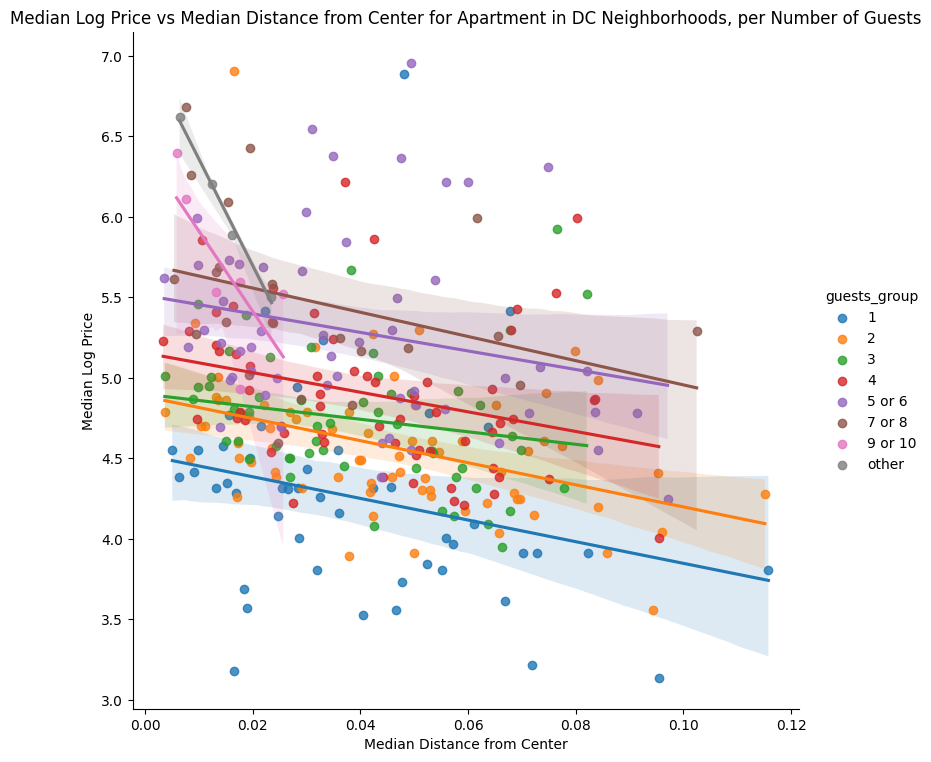

Correlation between Median Price and Median Distance from Center for Apartment
1: -0.25502234125931234
2: -0.3898104556147196
3: -0.19893187458977285
4: -0.2935968062307622
5 or 6: -0.22758276421777465
7 or 8: -0.3440375189256704
9 or 10: -0.710680092284359
other: -0.995111139471541




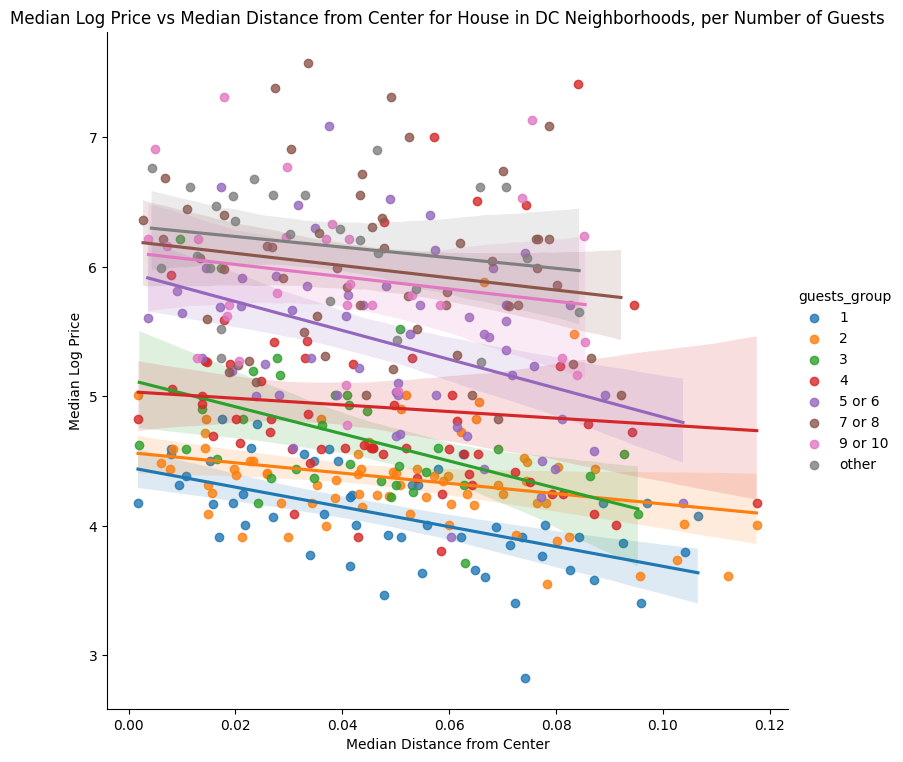

Correlation between Median Price and Median Distance from Center for House
1: -0.5470594683815728
2: -0.275668437863197
3: -0.4635348553938159
4: -0.09312610600060112
5 or 6: -0.4036557216186917
7 or 8: -0.17213501869195694
9 or 10: -0.18843583470076178
other: -0.19797386514361112




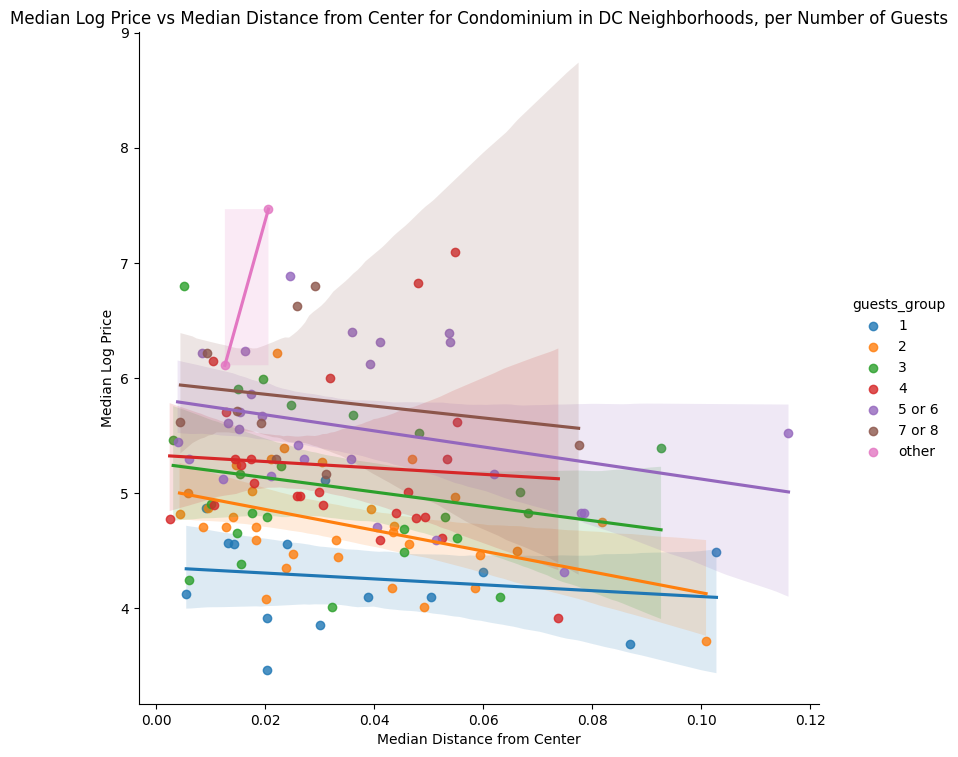

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.1631606912128272
2: -0.4273536944688573
3: -0.22367163097421353
4: -0.07336164904948794
5 or 6: -0.29664521758029166
7 or 8: -0.18707691251489347
other: 0.9999999999999999




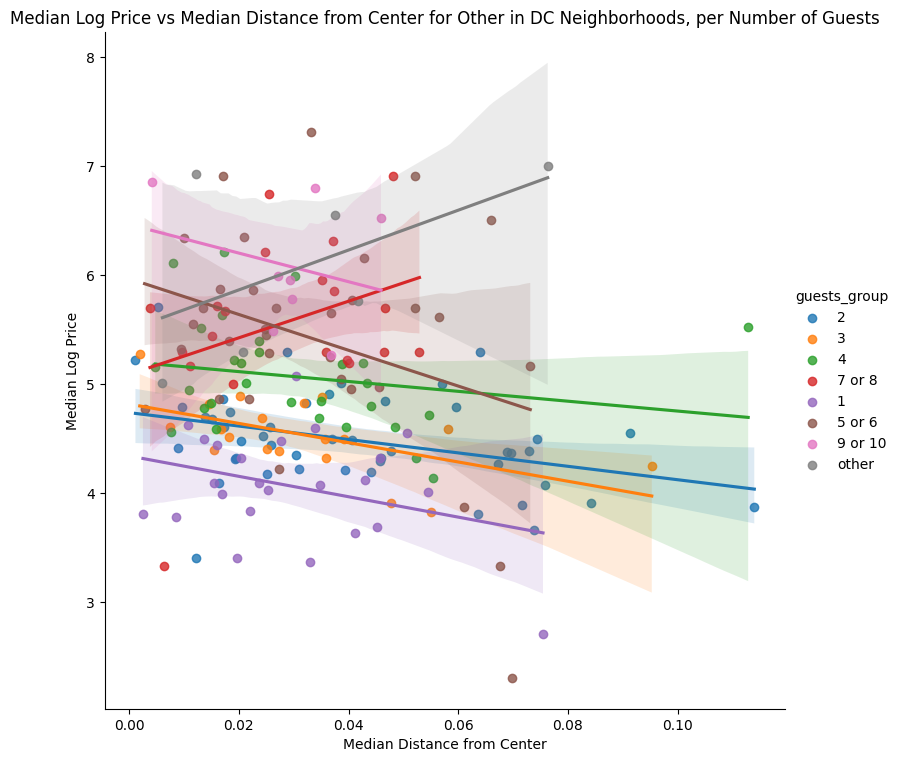

Correlation between Median Price and Median Distance from Center for Other
1: -0.31757695400009556
2: -0.3616900382053613
3: -0.5617494138930609
4: -0.19551075318382194
5 or 6: -0.32054160076842986
7 or 8: 0.34688532582301473
9 or 10: -0.2656936123498577
other: 0.5470357651101426




<ipython-input-51-2e9e03cda2a4>:177: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)
<ipython-input-51-2e9e03cda2a4>:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["property_type_group"] = df_DC["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")


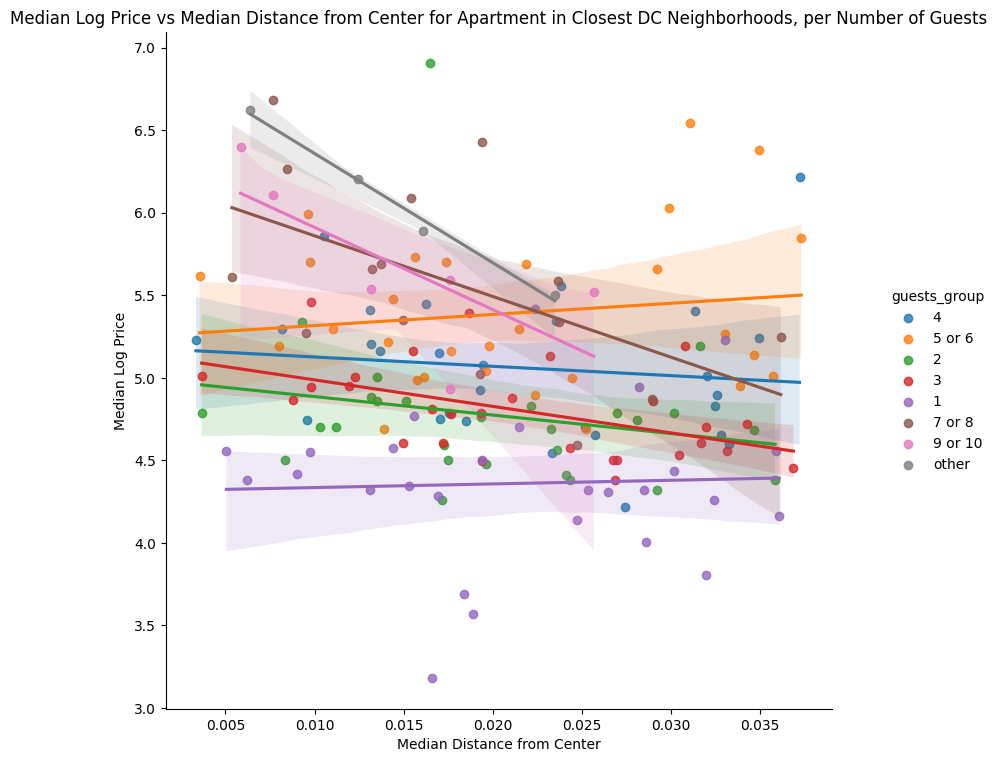

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: 0.04249188782779345
2: -0.18998901385867945
3: -0.5013590360982279
4: -0.12141821788700226
5 or 6: 0.13621936303462265
7 or 8: -0.5437417990363458
9 or 10: -0.7106800922843588
other: -0.995111139471541




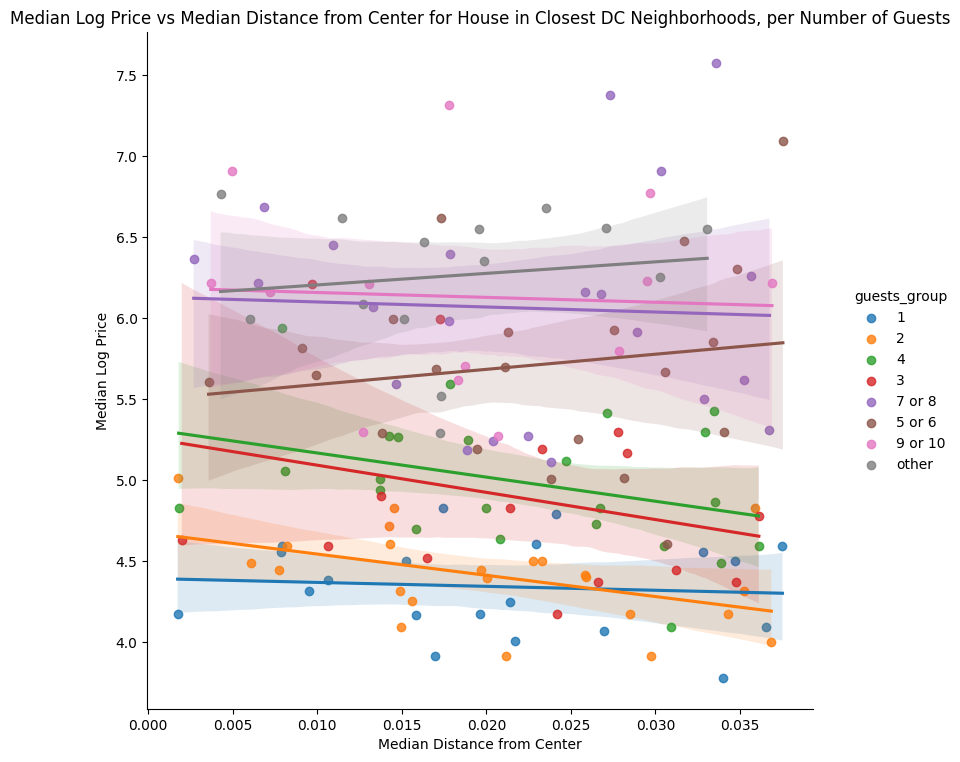

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: -0.0876152317254783
2: -0.4570533290906279
3: -0.27934676279833526
4: -0.3516816182381659
5 or 6: 0.1513528684836045
7 or 8: -0.04606126420675687
9 or 10: -0.05097607305058938
other: 0.1352672531908146




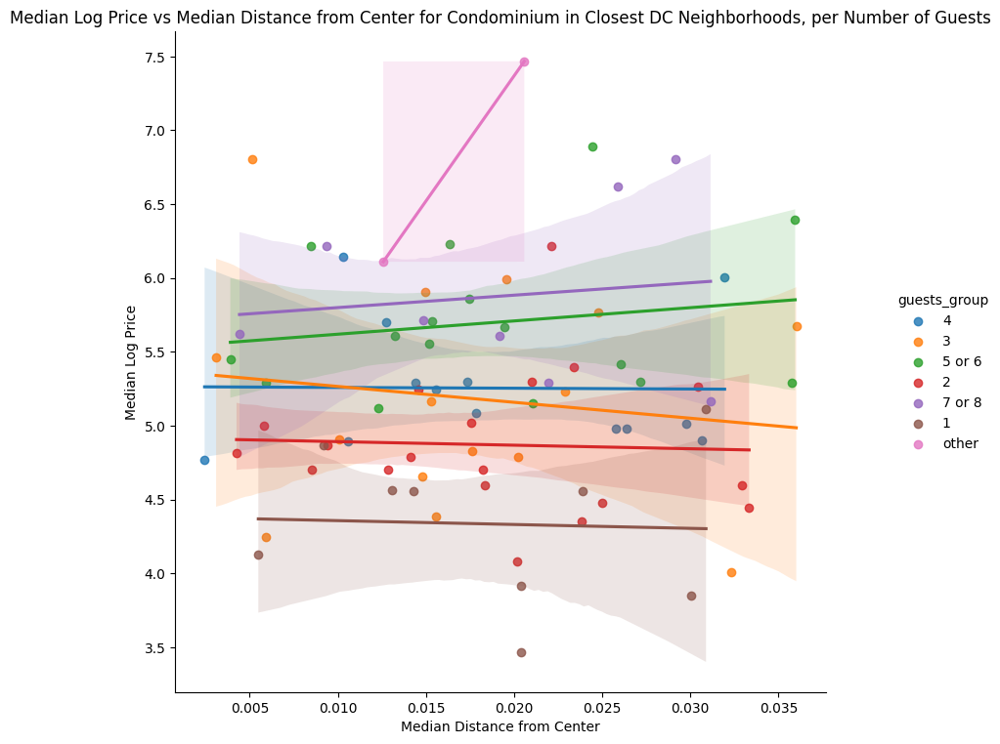

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.043531578200897994
2: -0.04299517889238437
3: -0.13328738477660276
4: -0.011185314059100358
5 or 6: 0.16925391661697456
7 or 8: 0.13205407645761497
other: 1.0




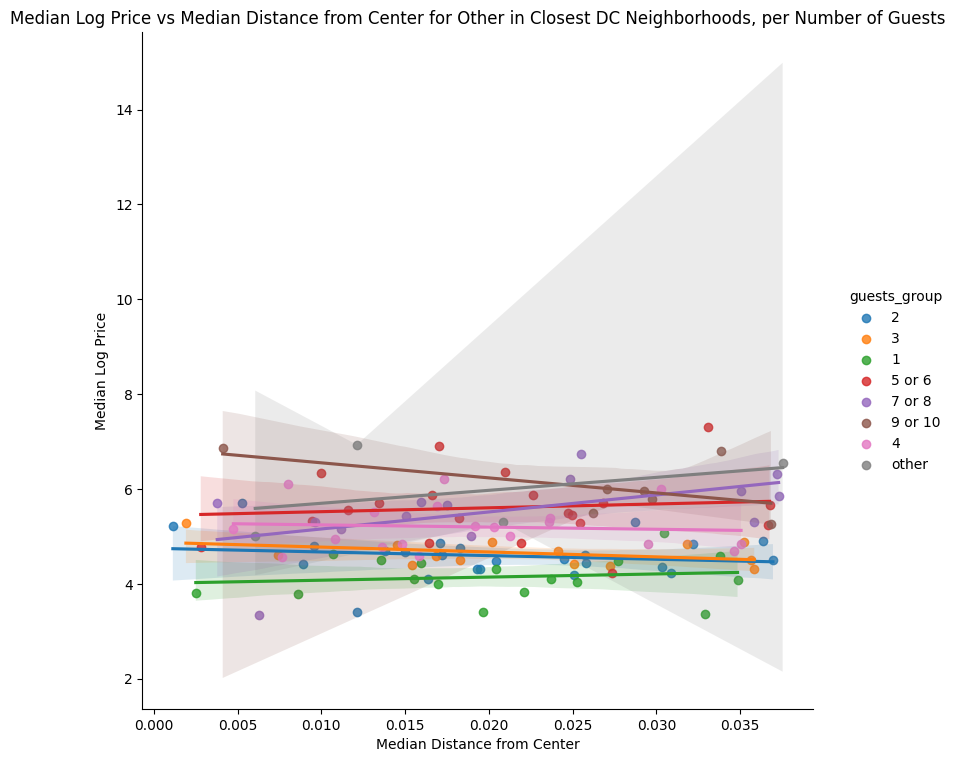

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: 0.13746674872408995
2: -0.161658245033359
3: -0.41059239469274467
4: -0.08146181170007442
5 or 6: 0.1019045378513125
7 or 8: 0.5288355932668848
9 or 10: -0.5546997960990746
other: 0.3984766106584425




<ipython-input-51-2e9e03cda2a4>:219: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_DC["price"] = np.exp(df_DC["log_price"])


In [ ]:
# Filter for DC data
df_DC = air.loc[air.city == "DC"]

# Calculate distance from center for each house in DC
df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_DC.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for DC Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest DC Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_DC["distance_group"] = df_DC["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_DC.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for DC Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)


# Calculate distance from center for each house in DC
df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)

# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_DC["guests_group"] = df_DC["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_DC.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for DC Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




df_DC["guests_group"] = df_DC["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_DC.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the DC center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_DC for the closest neighborhoods
df_DC_closest = df_DC[df_DC["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_DC_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest DC Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




# Group property types
df_DC["property_type_group"] = df_DC["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_DC.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in DC Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




# Calculate distance from center for each house in DC
df_DC["distance"] = np.sqrt((df_DC["latitude"] - center_lat) ** 2 + (df_DC["longitude"] - center_long) ** 2)

# Group property types
df_DC["property_type_group"] = df_DC["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_DC.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest DC Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




import folium 

# Calculate median price for each neighborhood
df_DC["price"] = np.exp(df_DC["log_price"])
median_price_neighbourhood = df_DC.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_DC.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
DC_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opaDC=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(DC_map)

# Display the map
DC_map

## Chicago

In [ ]:
center_lat = 41.881832
center_long = -87.623177

<ipython-input-59-302eb8fcb6b4>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)


Correlation is -0.4904595327216944
Correlation for the 50% closest neighborhoods to the center is -0.526555681740466


<ipython-input-59-302eb8fcb6b4>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["distance_group"] = df_Chicago["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.526555681740466
Correlation for neighborhoods far from the center is 0.008383336168849785


<ipython-input-59-302eb8fcb6b4>:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)
<ipython-input-59-302eb8fcb6b4>:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["guests_group"] = df_Chicago["accommodates"].apply(group_guests)


<Figure size 1200x600 with 0 Axes>

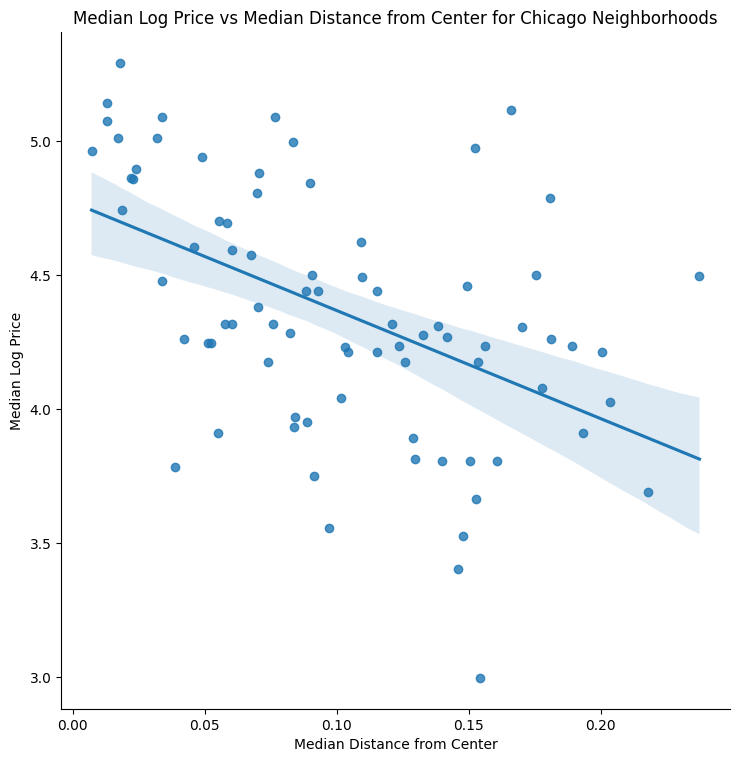

<Figure size 1200x600 with 0 Axes>

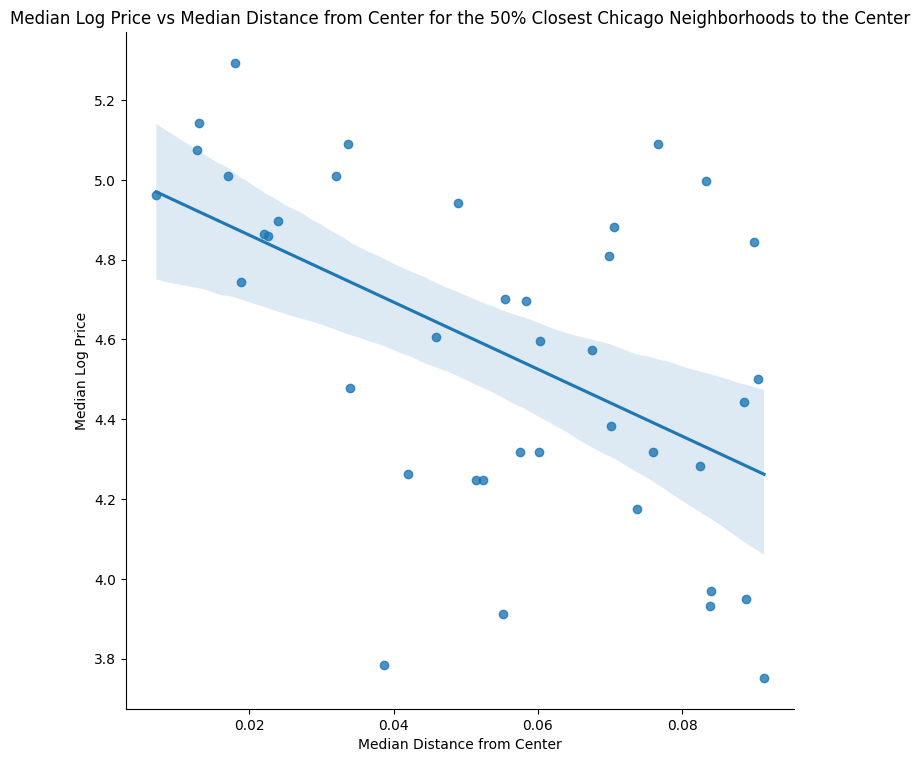

<Figure size 1200x600 with 0 Axes>

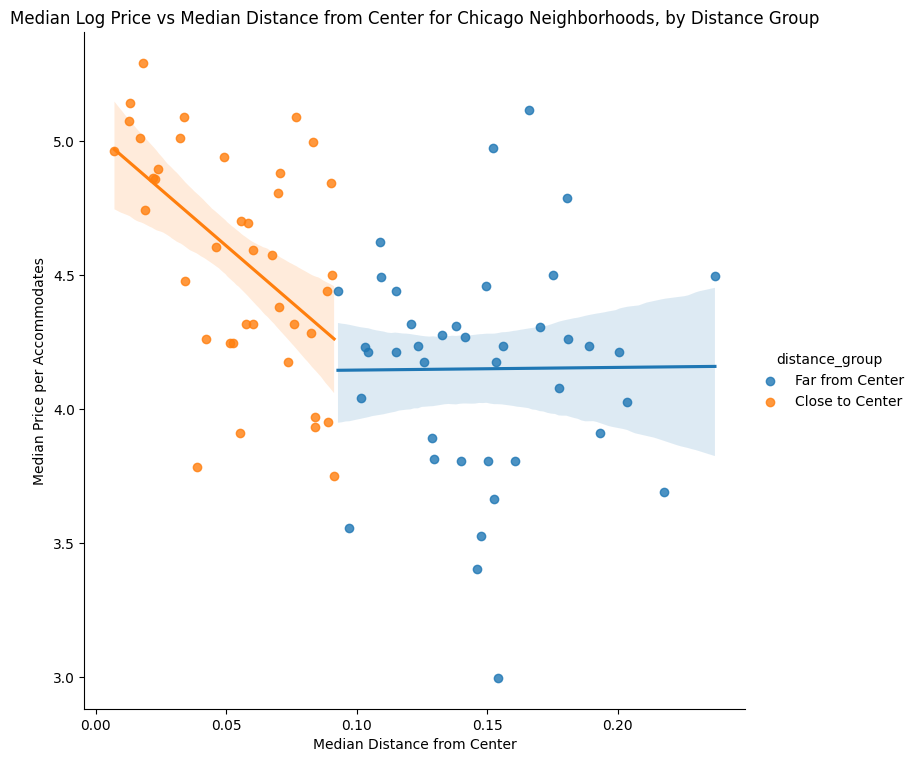

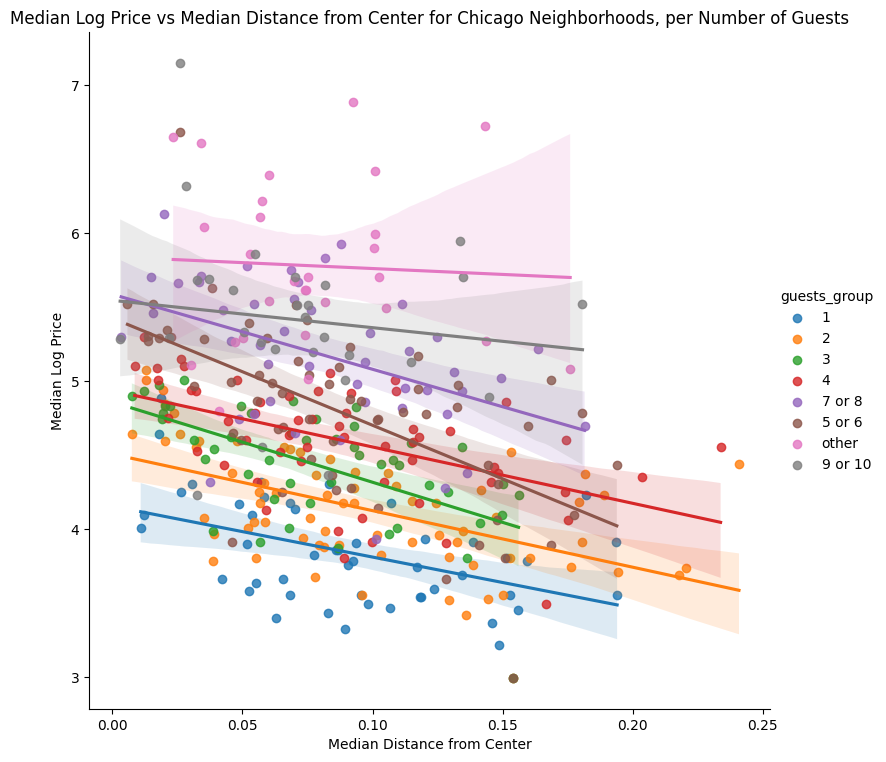

Correlation between Median Price and Median Distance from Center for
1: -0.4642080659901937
2: -0.5355845176036416
3: -0.5949338714397022
4: -0.5112852278800527
5 or 6: -0.6006788637220183
7 or 8: -0.4459169784179645
9 or 10: -0.13292025095056687
other: -0.051497463448495456


<ipython-input-59-302eb8fcb6b4>:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["guests_group"] = df_Chicago["accommodates"].apply(group_guests)


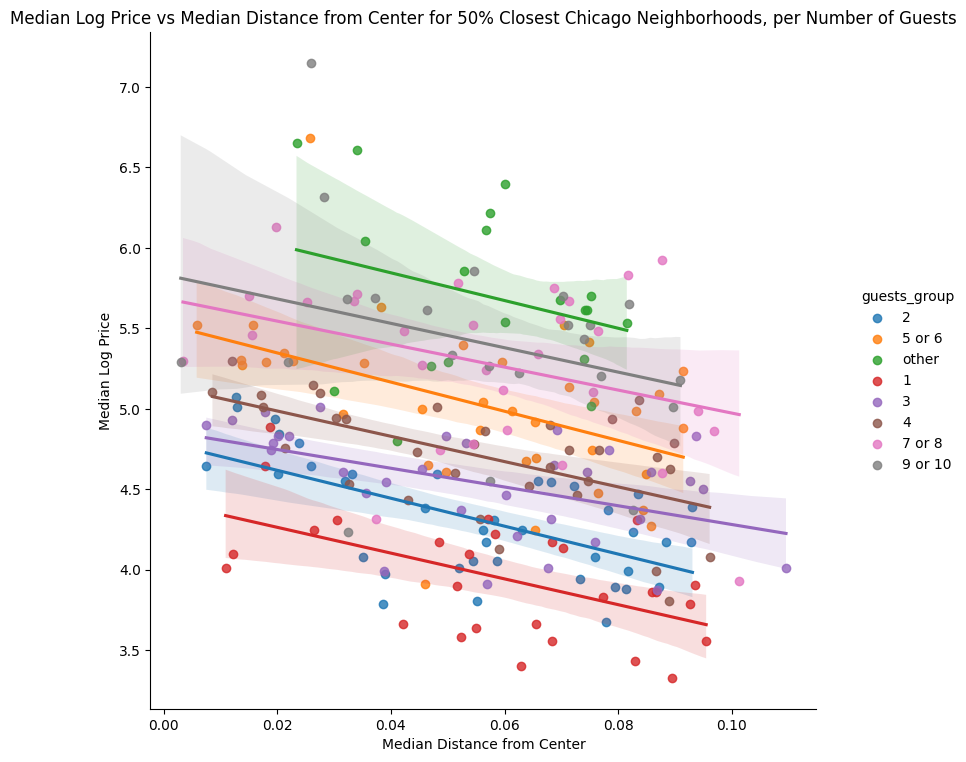

Correlation between Median Price and Median Distance from Center for
1: -0.5532128011851143
2: -0.6116068640861496
3: -0.4955495395872063
4: -0.5827318992515238
5 or 6: -0.4657968517235415
7 or 8: -0.36215114166916296
9 or 10: -0.30121344297214936
other: -0.28868205785148815


<ipython-input-59-302eb8fcb6b4>:146: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["property_type_group"] = df_Chicago["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


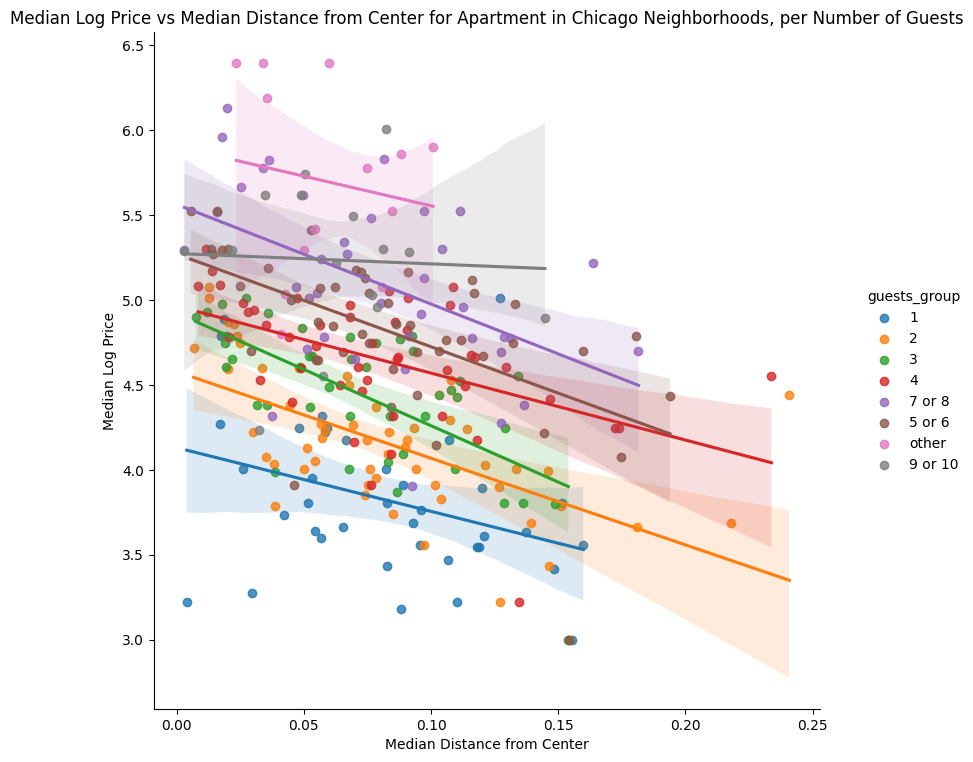

Correlation between Median Price and Median Distance from Center for Apartment
1: -0.34494821157764033
2: -0.6102171155057451
3: -0.6506270667259487
4: -0.4859997636504308
5 or 6: -0.5628734070209556
7 or 8: -0.49210649283364866
9 or 10: -0.04541807652021453
other: -0.15326444460146926




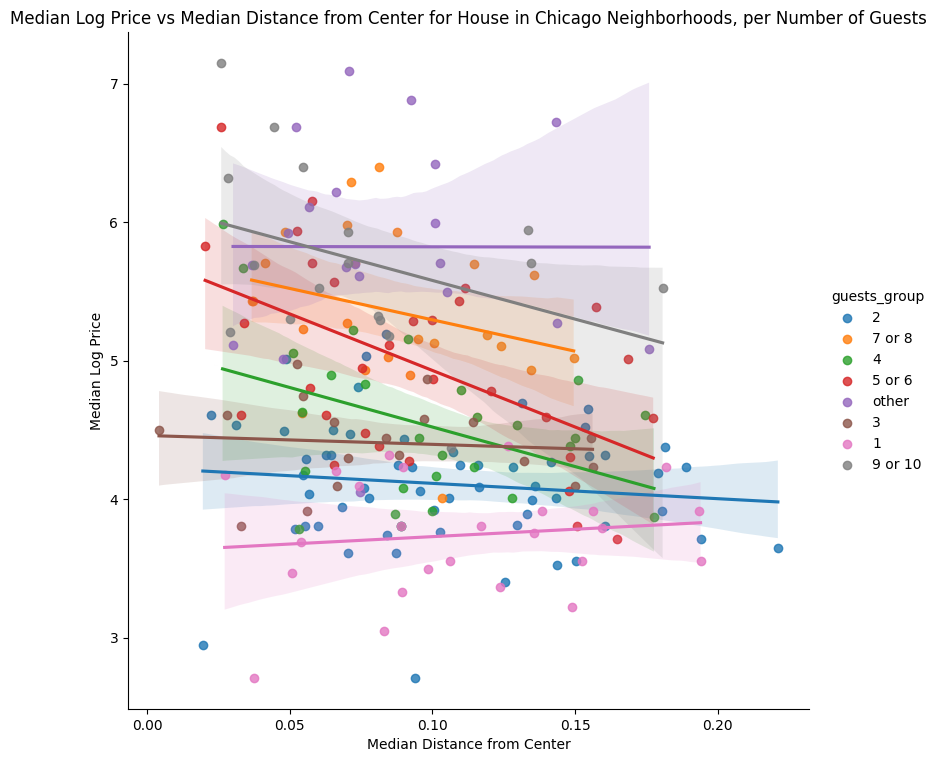

Correlation between Median Price and Median Distance from Center for House
1: 0.12052999324352763
2: -0.11360484411949724
3: -0.09185672826107537
4: -0.4119788339842511
5 or 6: -0.5309023299155464
7 or 8: -0.2698528810422359
9 or 10: -0.3669584037238009
other: -0.0018232259098960003




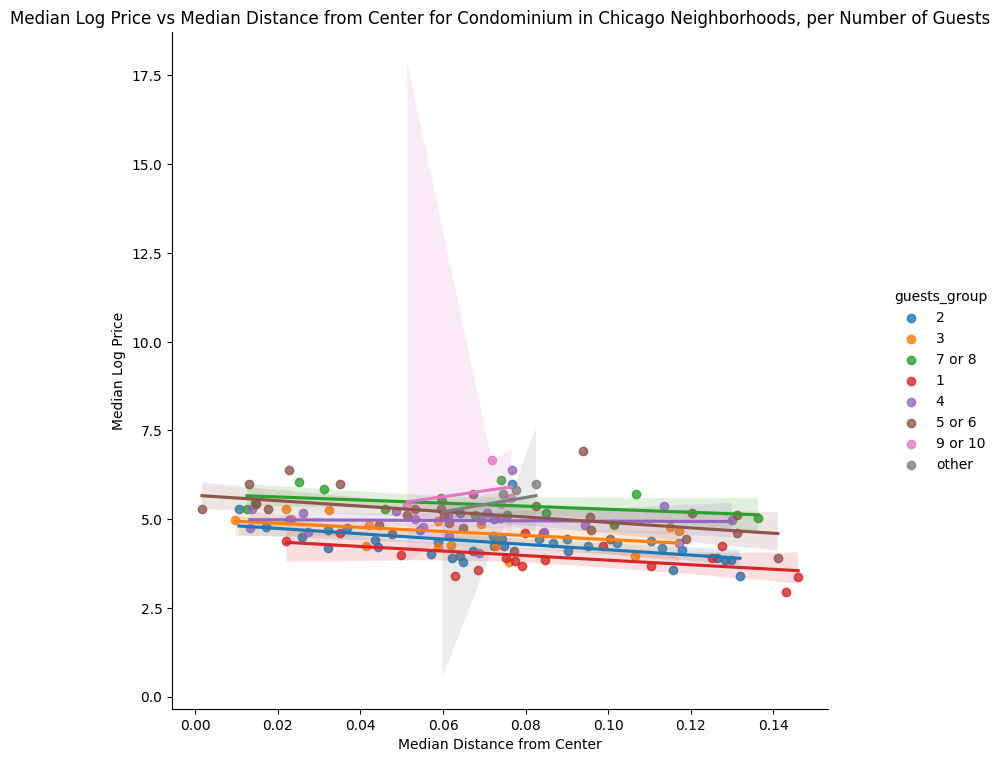

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.47804385278336975
2: -0.5119197067899727
3: -0.4333648829070722
4: -0.03251441095153516
5 or 6: -0.45008145388482107
7 or 8: -0.4072147939382836
9 or 10: 0.314931866971183
other: 0.2699487628447789




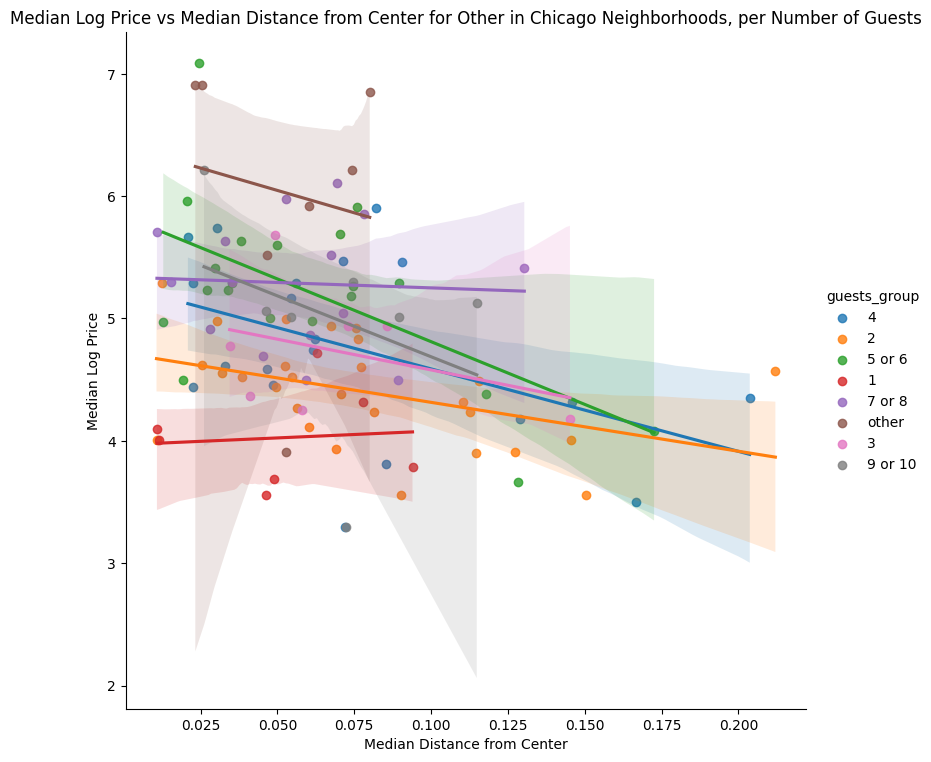

Correlation between Median Price and Median Distance from Center for Other
1: 0.08732793810846623
2: -0.4221769637859474
3: -0.3597808944861563
4: -0.4581246535847293
5 or 6: -0.5829102496913443
7 or 8: -0.05183710261374689
9 or 10: -0.33681592187699994
other: -0.149119474119961




<ipython-input-59-302eb8fcb6b4>:177: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)
<ipython-input-59-302eb8fcb6b4>:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["property_type_group"] = df_Chicago["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")


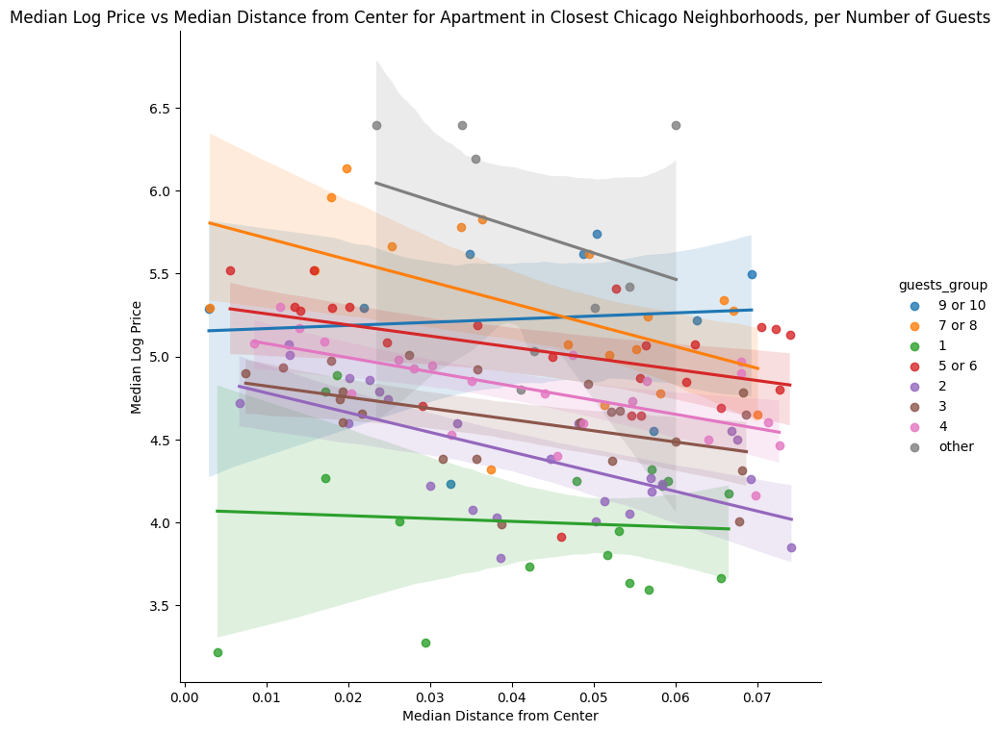

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: -0.07259151146305154
2: -0.6410238679691455
3: -0.4707519233701343
4: -0.6504125893186204
5 or 6: -0.41456715740553546
7 or 8: -0.5214703946972122
9 or 10: 0.0783086616387118
other: -0.2808662915732772




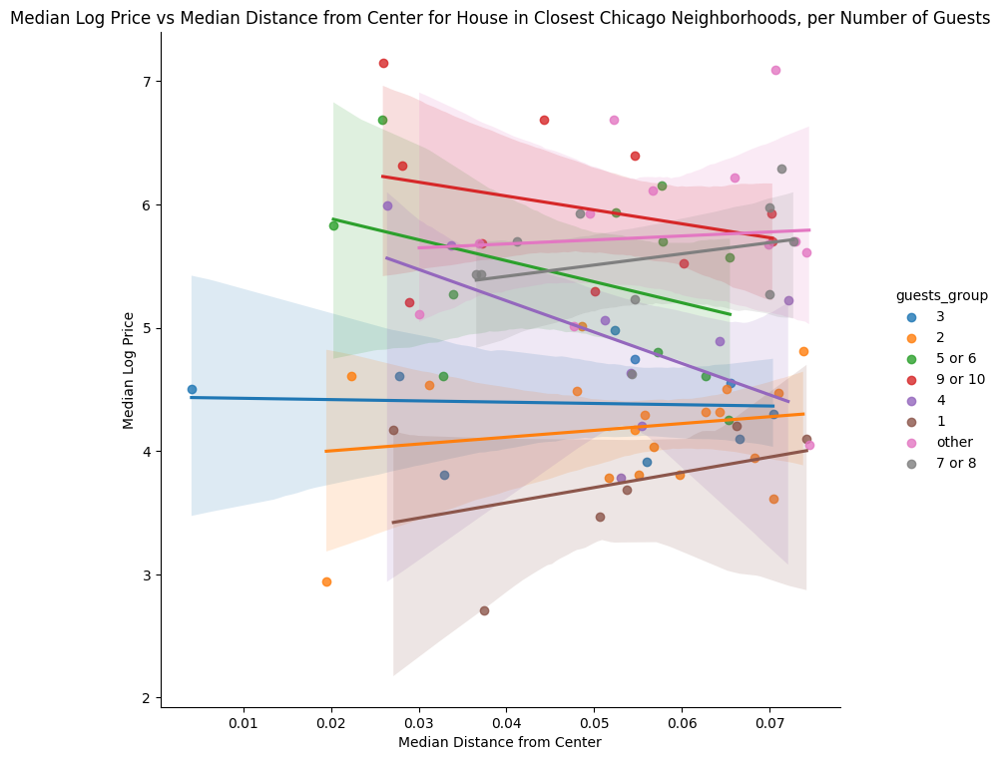

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: 0.37421951032712825
2: 0.1795800193668827
3: -0.05843019574696202
4: -0.5223071254738668
5 or 6: -0.37620427943378776
7 or 8: 0.2826383770217051
9 or 10: -0.3001233074422911
other: 0.06218912748086171




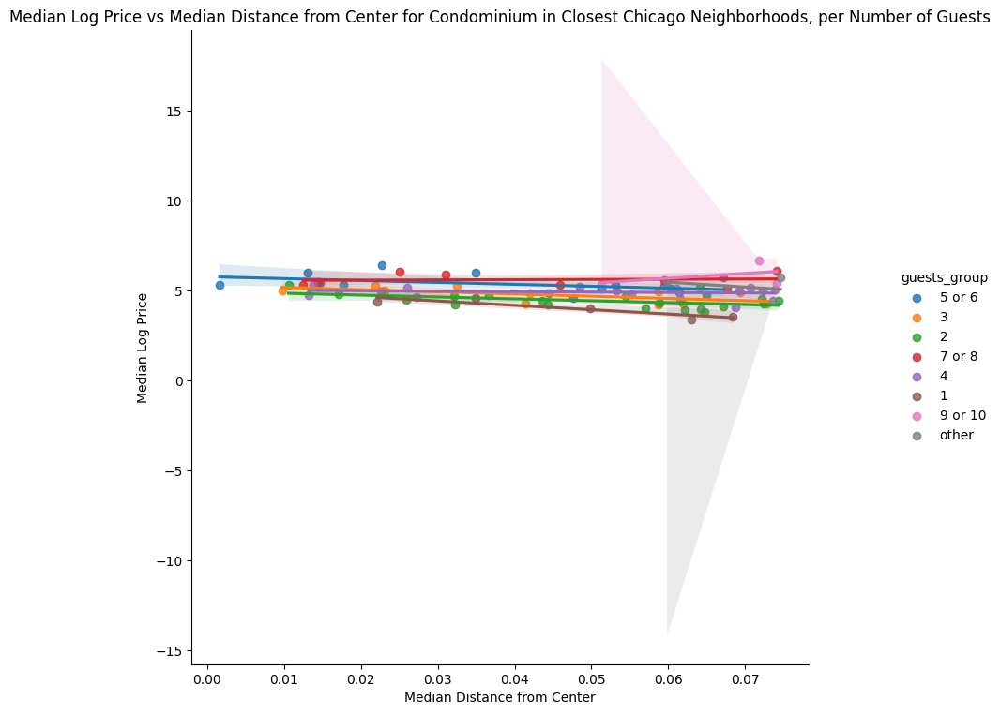

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.901262932051778
2: -0.5002139419171804
3: -0.6230692880091775
4: -0.1677896532152413
5 or 6: -0.4540648011467703
7 or 8: 0.07937769632478048
9 or 10: 0.4577631269674832
other: -0.3206848836507014




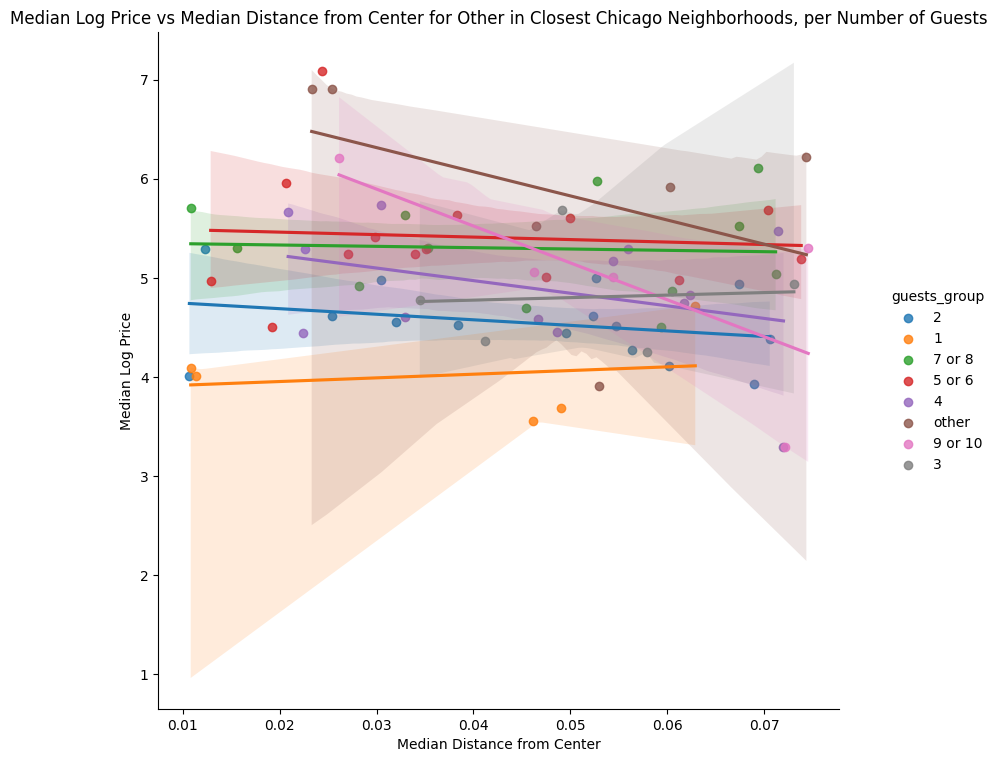

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: 0.1927460259437053
2: -0.2842581433761499
3: 0.06728191656420067
4: -0.3598024792069159
5 or 6: -0.07904227831082153
7 or 8: -0.05551368220531394
9 or 10: -0.7009072529479395
other: -0.43483693505565607




<ipython-input-59-302eb8fcb6b4>:219: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Chicago["price"] = np.exp(df_Chicago["log_price"])


In [ ]:
# Filter for Chicago data
df_Chicago = air.loc[air.city == "Chicago"]

# Calculate distance from center for each house in Chicago
df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_Chicago.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for Chicago Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest Chicago Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_Chicago["distance_group"] = df_Chicago["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_Chicago.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for Chicago Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)


# Calculate distance from center for each house in Chicago
df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)

# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_Chicago["guests_group"] = df_Chicago["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_Chicago.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for Chicago Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




df_Chicago["guests_group"] = df_Chicago["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_Chicago.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the Chicago center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_Chicago for the closest neighborhoods
df_Chicago_closest = df_Chicago[df_Chicago["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_Chicago_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest Chicago Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




# Group property types
df_Chicago["property_type_group"] = df_Chicago["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_Chicago.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Chicago Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




# Calculate distance from center for each house in Chicago
df_Chicago["distance"] = np.sqrt((df_Chicago["latitude"] - center_lat) ** 2 + (df_Chicago["longitude"] - center_long) ** 2)

# Group property types
df_Chicago["property_type_group"] = df_Chicago["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_Chicago.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest Chicago Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




import folium 

# Calculate median price for each neighborhood
df_Chicago["price"] = np.exp(df_Chicago["log_price"])
median_price_neighbourhood = df_Chicago.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_Chicago.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
Chicago_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opaChicago=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(Chicago_map)

# Display the map
Chicago_map

## Boston

<ipython-input-60-94bec986eb84>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)


Correlation is -0.6238330888904897
Correlation for the 50% closest neighborhoods to the center is -0.3675435209807041


<ipython-input-60-94bec986eb84>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["distance_group"] = df_Boston["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.3675435209807041
Correlation for neighborhoods far from the center is -0.40071352752900785


<ipython-input-60-94bec986eb84>:72: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)
<ipython-input-60-94bec986eb84>:93: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["guests_group"] = df_Boston["accommodates"].apply(group_guests)


<Figure size 1200x600 with 0 Axes>

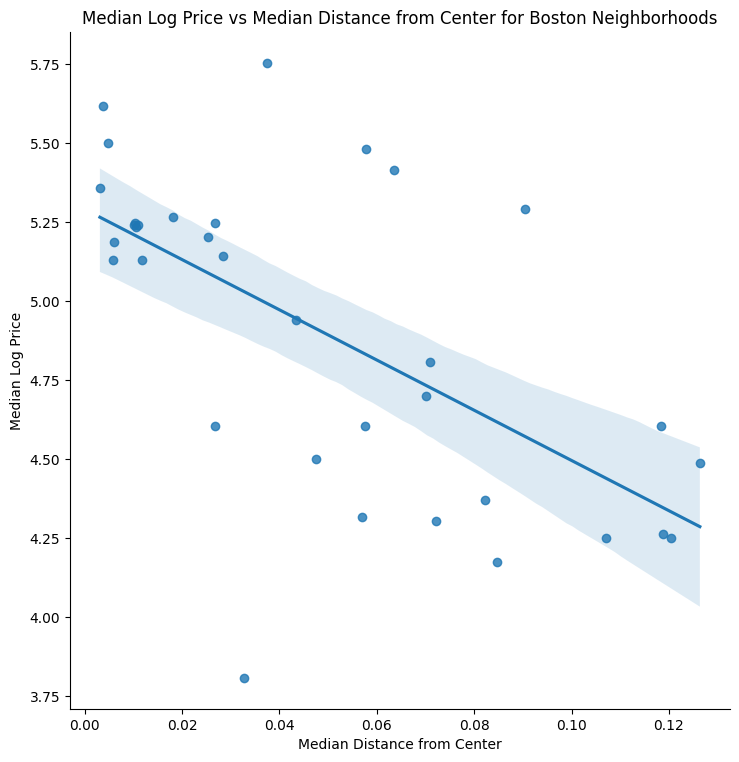

<Figure size 1200x600 with 0 Axes>

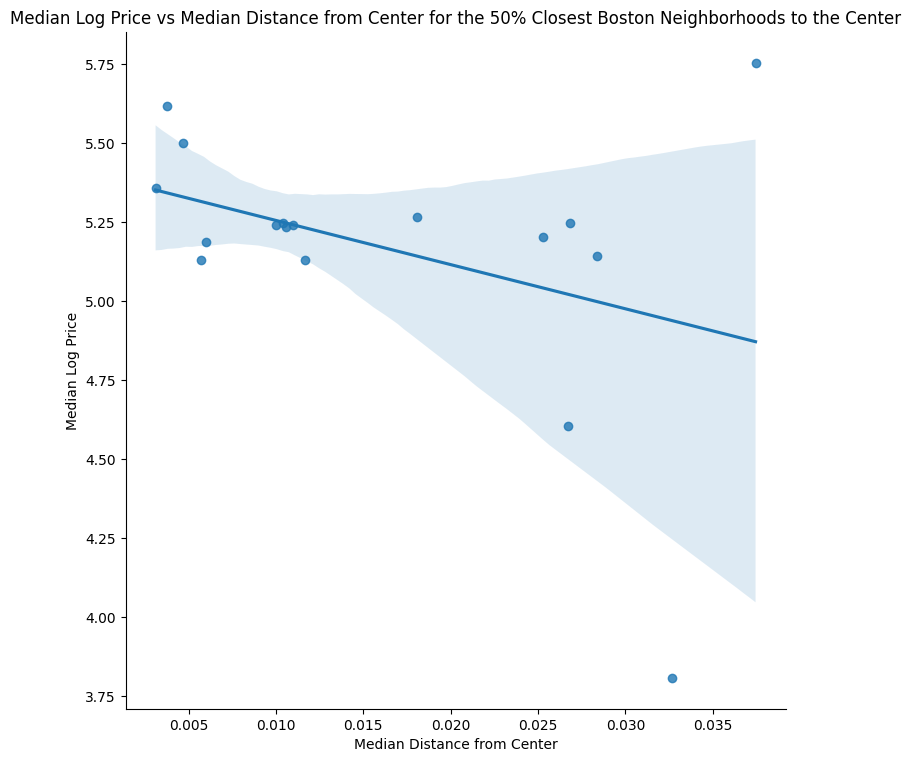

<Figure size 1200x600 with 0 Axes>

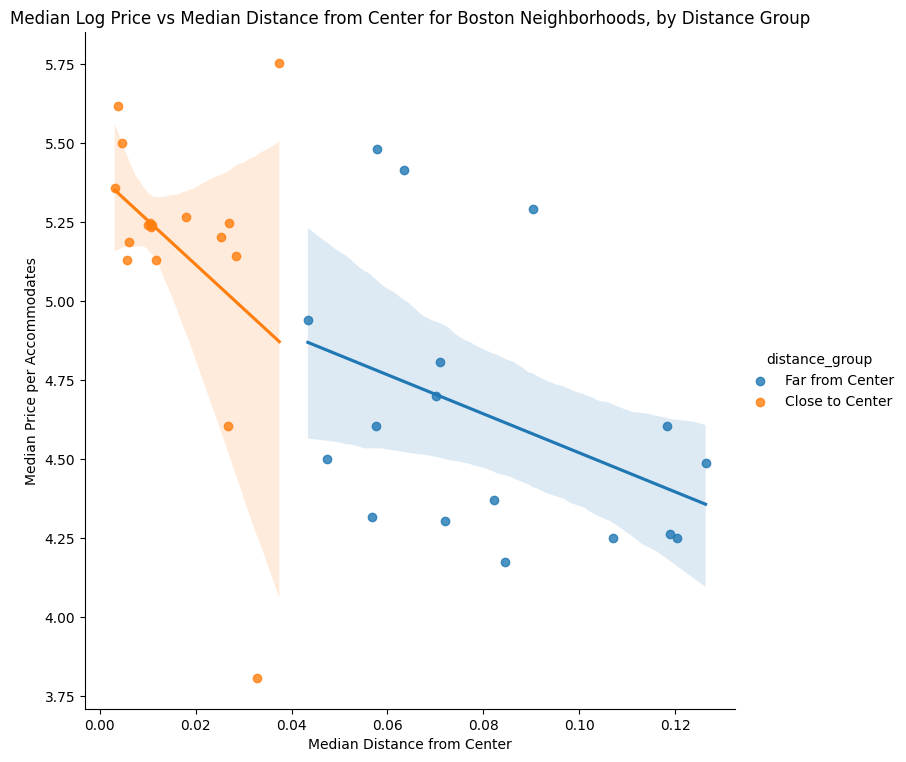

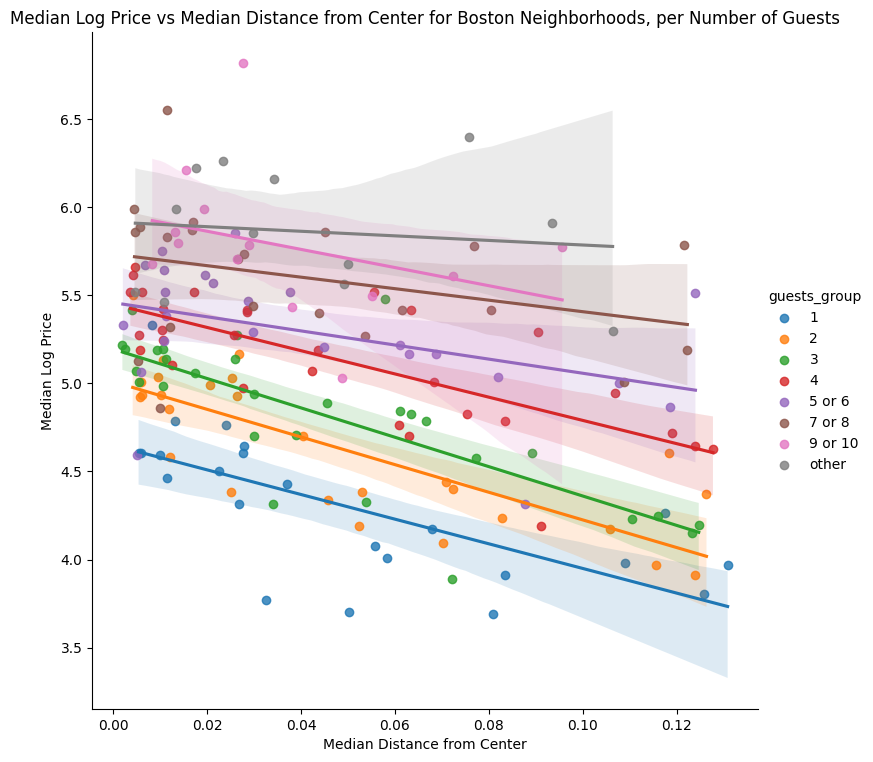

Correlation between Median Price and Median Distance from Center for
1: -0.6792576692626051
2: -0.7819566169874687
3: -0.7677887042946148
4: -0.7383671043630207
5 or 6: -0.42391818213381793
7 or 8: -0.3244908099935529
9 or 10: -0.3181993987378363
other: -0.12197661827346824


<ipython-input-60-94bec986eb84>:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["guests_group"] = df_Boston["accommodates"].apply(group_guests)


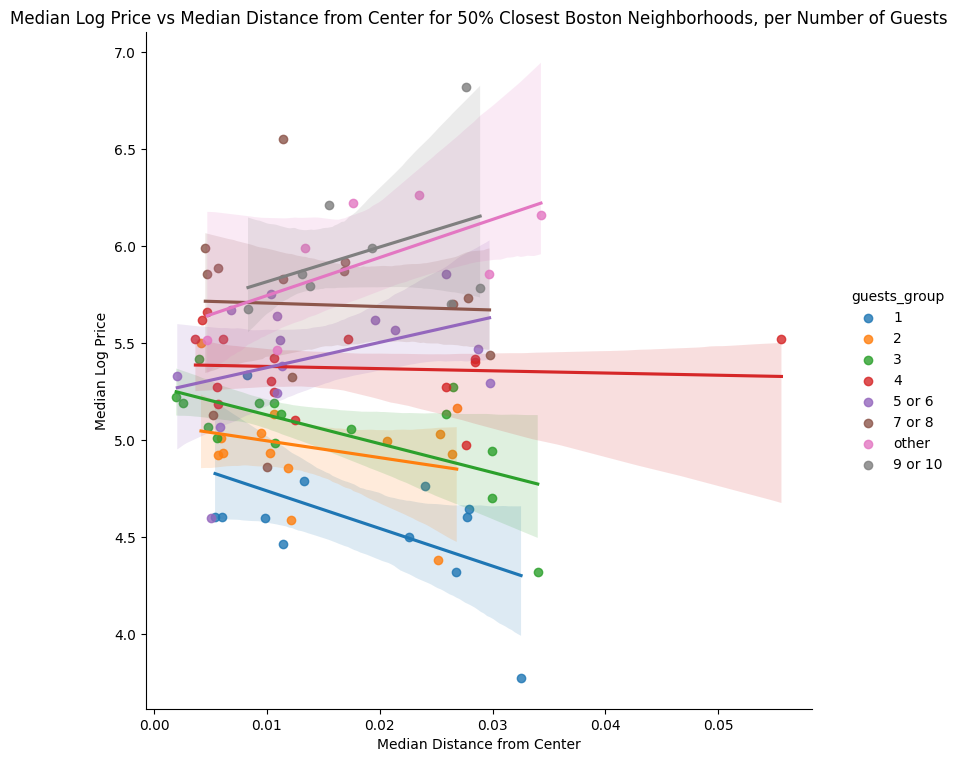

Correlation between Median Price and Median Distance from Center for
1: -0.5373974555768537
2: -0.2880648489438612
3: -0.6396537225729332
4: -0.08345895745506532
5 or 6: 0.36851350764437824
7 or 8: -0.037278245467451565
9 or 10: 0.3608955702550829
other: 0.6328780816491298


<ipython-input-60-94bec986eb84>:149: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["property_type_group"] = df_Boston["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


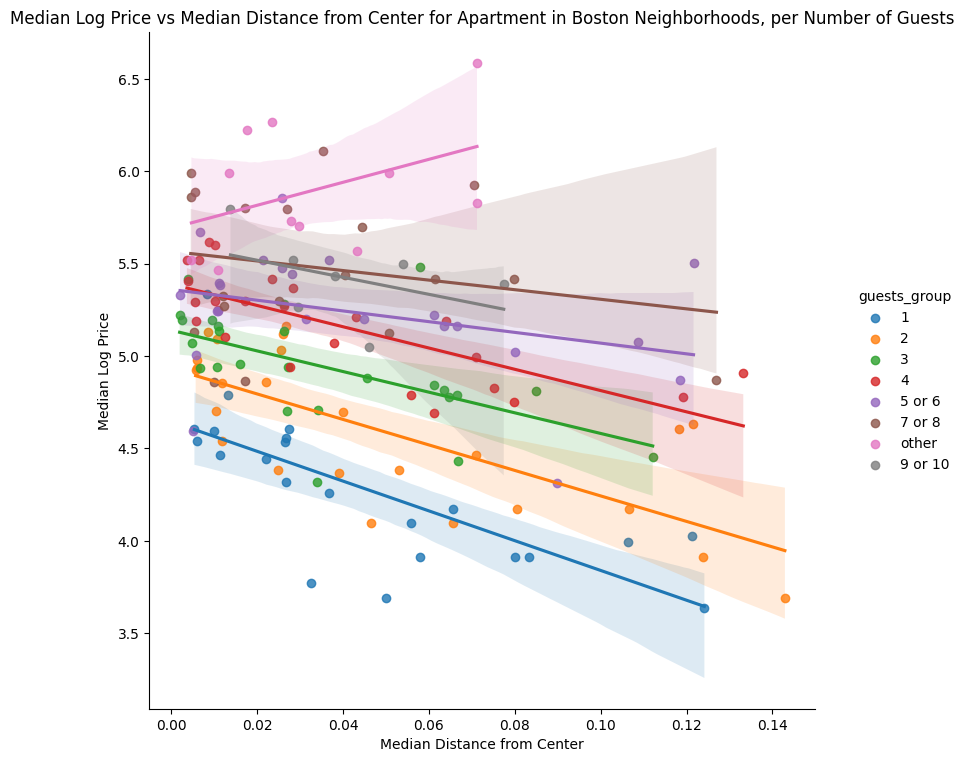

Correlation between Median Price and Median Distance from Center for Apartment
1: -0.7289016566725417
2: -0.7222922662199908
3: -0.5655861092894391
4: -0.7537989974485299
5 or 6: -0.3303868929068091
7 or 8: -0.20861772950726976
9 or 10: -0.4122964353327539
other: 0.4087674437089381




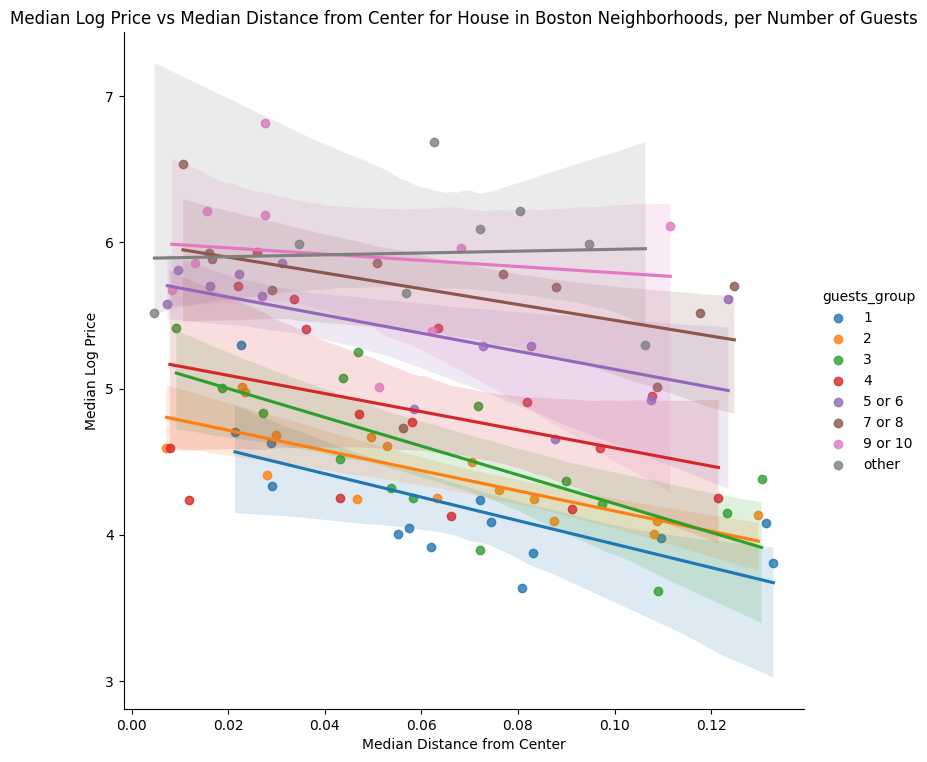

Correlation between Median Price and Median Distance from Center for House
1: -0.6871736378378736
2: -0.7961982833625211
3: -0.7142239346754883
4: -0.36219691310536334
5 or 6: -0.6077114610136227
7 or 8: -0.4840363079550254
9 or 10: -0.13768141125096808
other: 0.04754429484850635




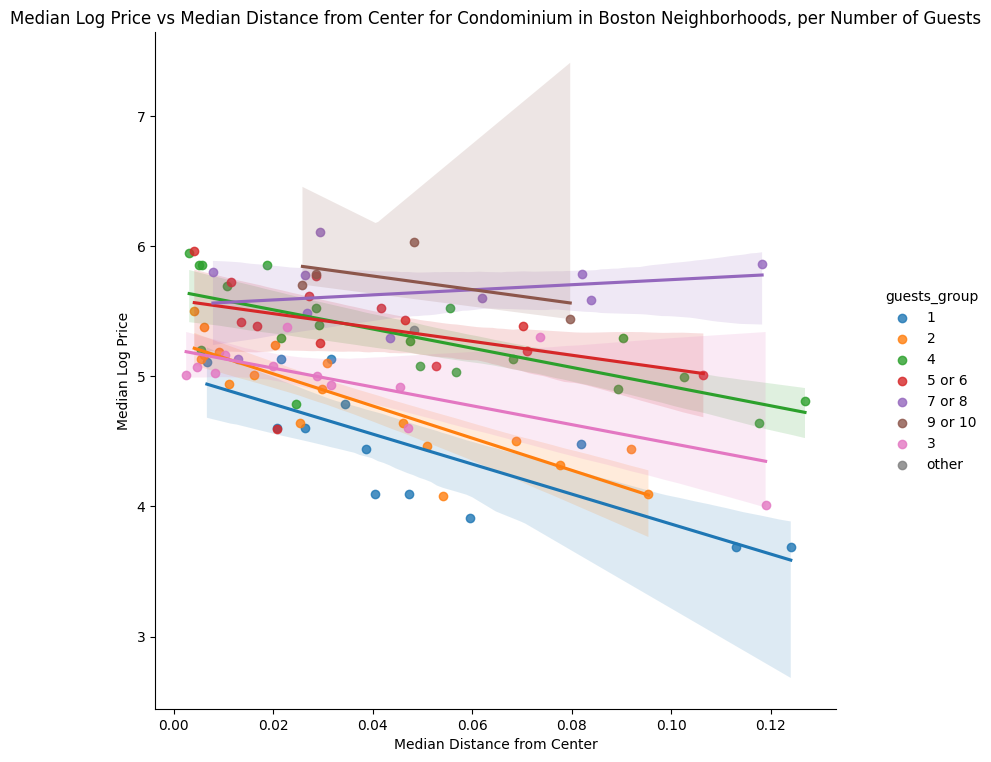

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.7969785787934038
2: -0.8729613919827068
3: -0.6837223060742096
4: -0.7394485538179177
5 or 6: -0.434855659138514
7 or 8: 0.24406504224926945
9 or 10: -0.527531883660012
other: nan




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)


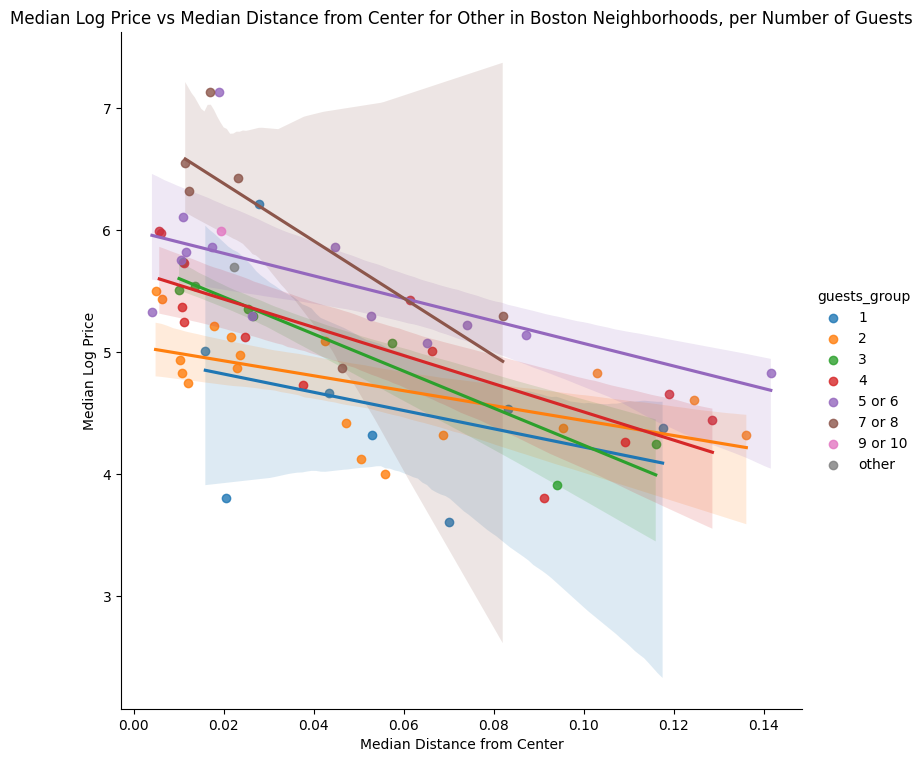

Correlation between Median Price and Median Distance from Center for Other
1: -0.32521202219175116
2: -0.5919779979306389
3: -0.9472559763129451
4: -0.8045083559398174
5 or 6: -0.6198318063451019
7 or 8: -0.7670191827177163
9 or 10: nan
other: nan




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
<ipython-input-60-94bec986eb84>:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)
<ipython-input-60-94bec986eb84>:183: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://

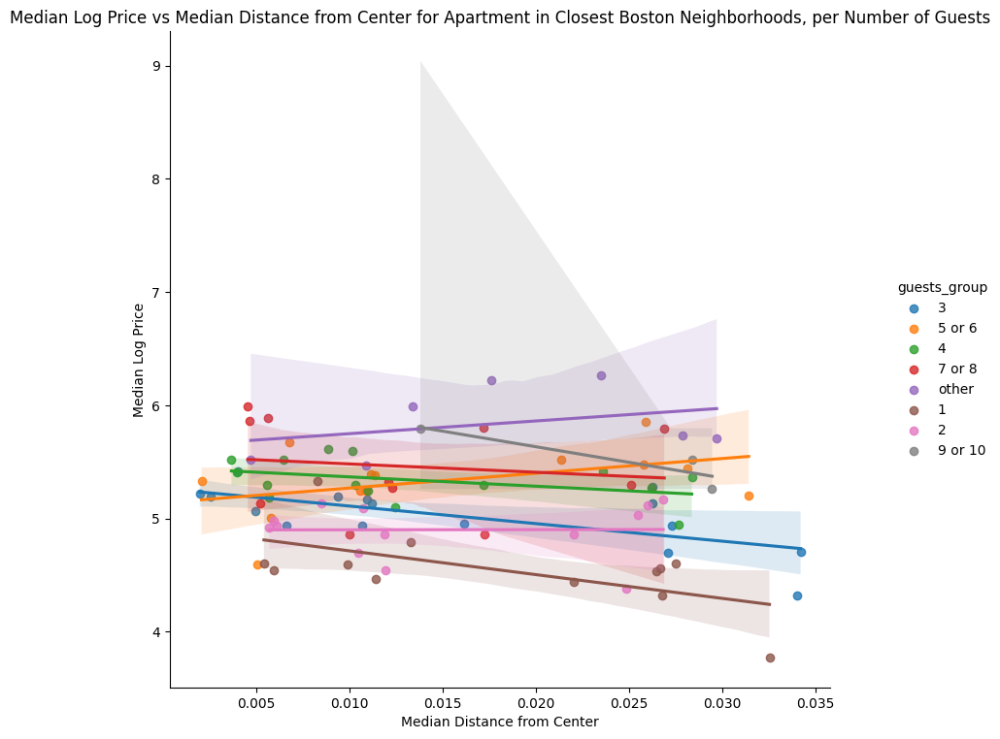

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: -0.590065263707584
2: 0.005996297797763597
3: -0.6579861141058425
4: -0.39721372283768386
5 or 6: 0.42141023642655184
7 or 8: -0.14047237594104256
9 or 10: -0.9025544648235383
other: 0.32228536733071517




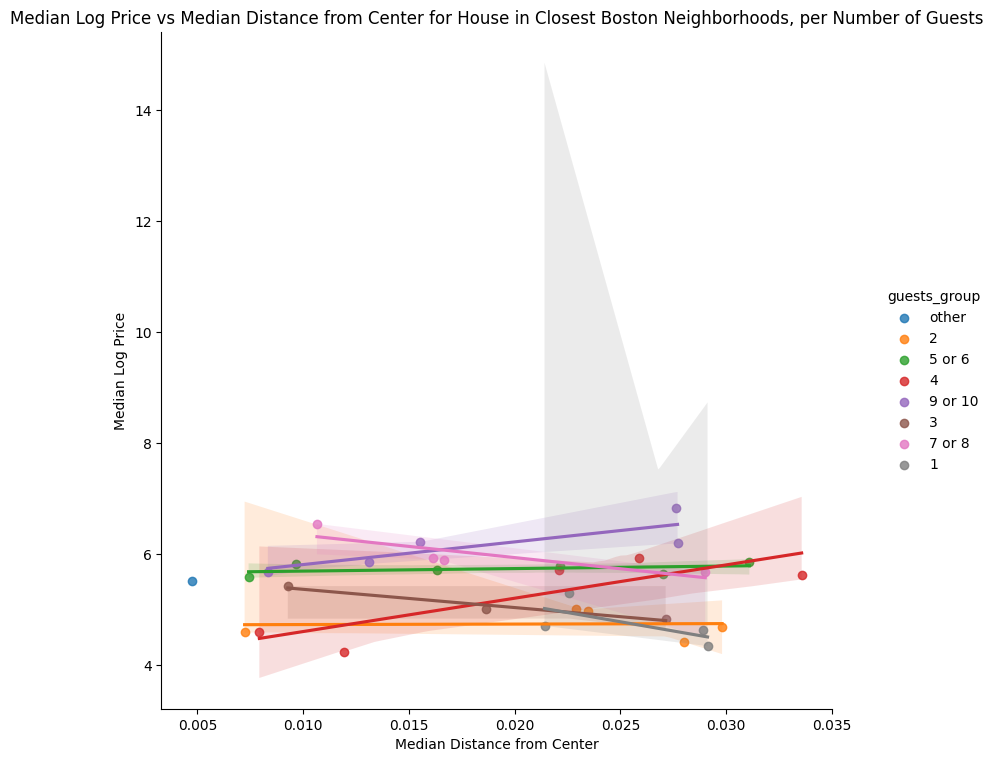

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: -0.6714571731930261
2: 0.029663116967180263
3: -0.9790385522234808
4: 0.832706931172929
5 or 6: 0.3956848277086223
7 or 8: -0.839757360820342
9 or 10: 0.8219123495197568
other: nan




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)


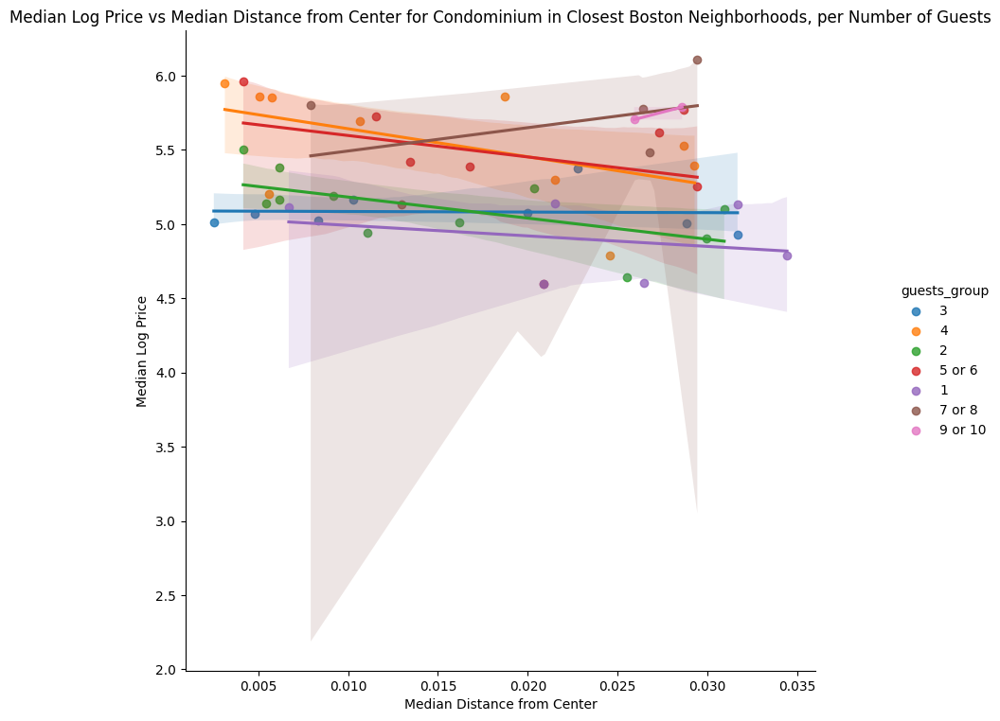

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.26693041721523386
2: -0.6139226558316426
3: -0.032132962141165566
4: -0.5255217193402698
5 or 6: -0.3142872867351584
7 or 8: 0.40724917317613174
9 or 10: 1.0




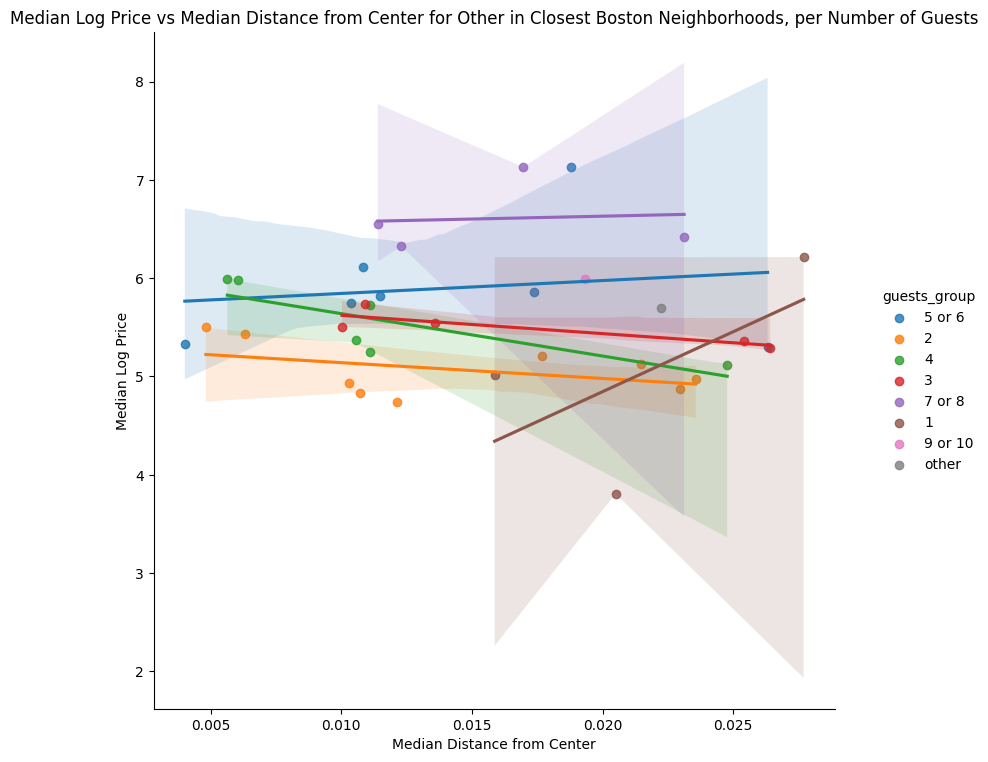

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: 0.6040328792104401
2: -0.4310720159892389
3: -0.8541328422815646
4: -0.7927600298832833
5 or 6: 0.15453519301254925
7 or 8: 0.08687124421536008
9 or 10: nan
other: nan




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
<ipython-input-60-94bec986eb84>:222: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Boston["price"] = np.exp(df_Boston["log_price"])


In [ ]:
center_lat = 42.360954
center_long = -71.057596

# Filter for Boston data
df_Boston = air.loc[air.city == "Boston"]

# Calculate distance from center for each house in Boston
df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_Boston.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for Boston Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest Boston Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_Boston["distance_group"] = df_Boston["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_Boston.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for Boston Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)


# Calculate distance from center for each house in Boston
df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)

# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_Boston["guests_group"] = df_Boston["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_Boston.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for Boston Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




df_Boston["guests_group"] = df_Boston["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_Boston.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the Boston center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_Boston for the closest neighborhoods
df_Boston_closest = df_Boston[df_Boston["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_Boston_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest Boston Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




# Group property types
df_Boston["property_type_group"] = df_Boston["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_Boston.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Boston Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




# Calculate distance from center for each house in Boston
df_Boston["distance"] = np.sqrt((df_Boston["latitude"] - center_lat) ** 2 + (df_Boston["longitude"] - center_long) ** 2)

# Group property types
df_Boston["property_type_group"] = df_Boston["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_Boston.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest Boston Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




import folium 

# Calculate median price for each neighborhood
df_Boston["price"] = np.exp(df_Boston["log_price"])
median_price_neighbourhood = df_Boston.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_Boston.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
Boston_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opaBoston=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(Boston_map)

# Display the map
Boston_map

## San Francisco

<ipython-input-4-724c71d65de3>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)


Correlation is -0.5818575891685737
Correlation for the 50% closest neighborhoods to the center is -0.44326099338438324


<ipython-input-4-724c71d65de3>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["distance_group"] = df_SANF["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


Correlation for neighborhoods close to the center is -0.4432609933843834
Correlation for neighborhoods far from the center is -0.6713383551575267


<ipython-input-4-724c71d65de3>:72: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)
<ipython-input-4-724c71d65de3>:93: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["guests_group"] = df_SANF["accommodates"].apply(group_guests)


<Figure size 1200x600 with 0 Axes>

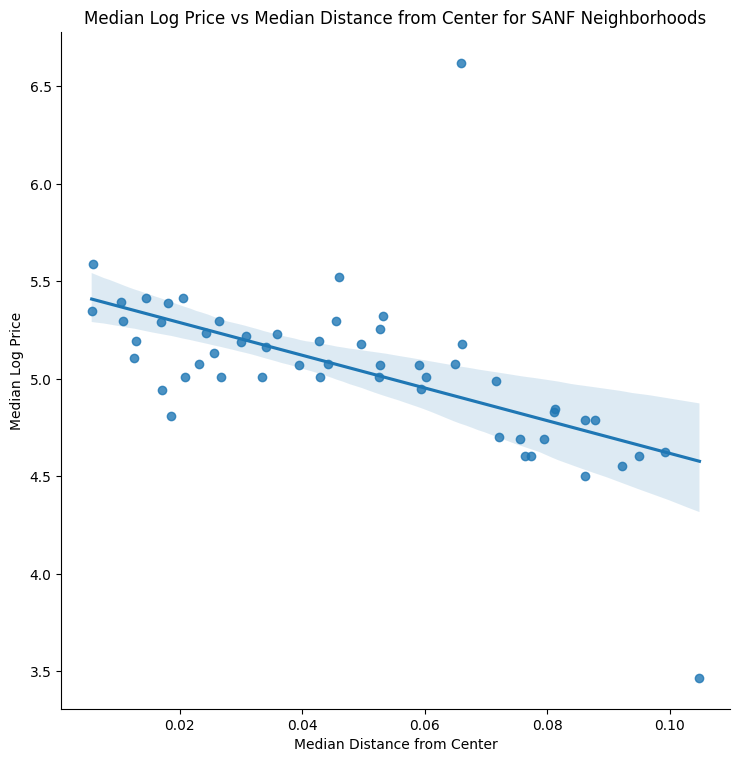

<Figure size 1200x600 with 0 Axes>

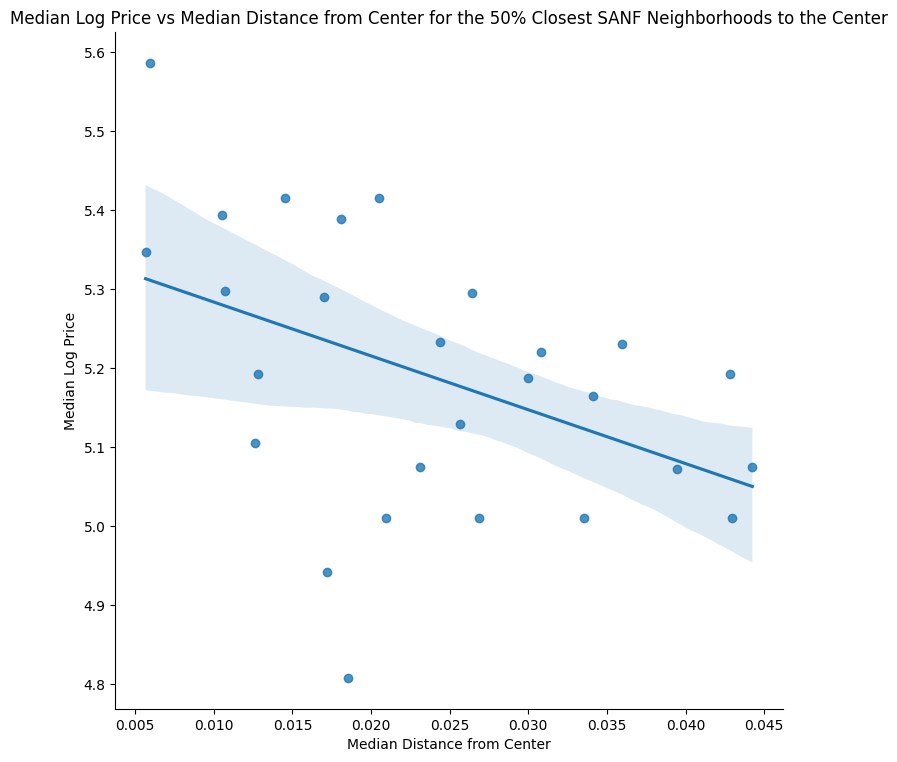

<Figure size 1200x600 with 0 Axes>

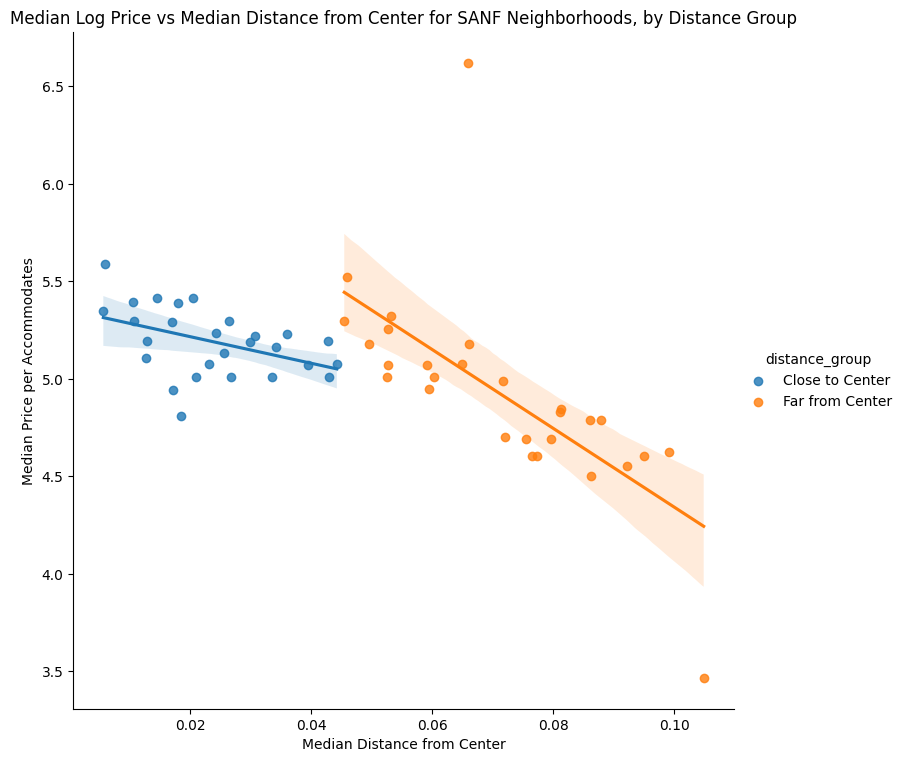

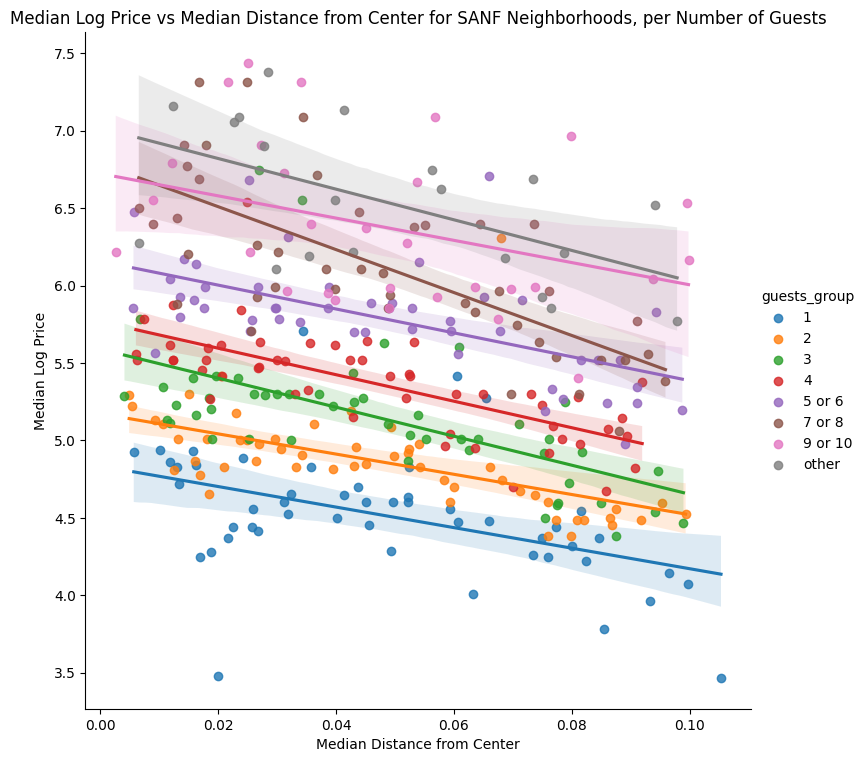

Correlation between Median Price and Median Distance from Center for
1: -0.4430229389971876
2: -0.554469561091409
3: -0.5849489807013675
4: -0.704188390125266
5 or 6: -0.6053371982691573
7 or 8: -0.7052100642986798
9 or 10: -0.3634122913340584
other: -0.5593599416788221


<ipython-input-4-724c71d65de3>:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["guests_group"] = df_SANF["accommodates"].apply(group_guests)


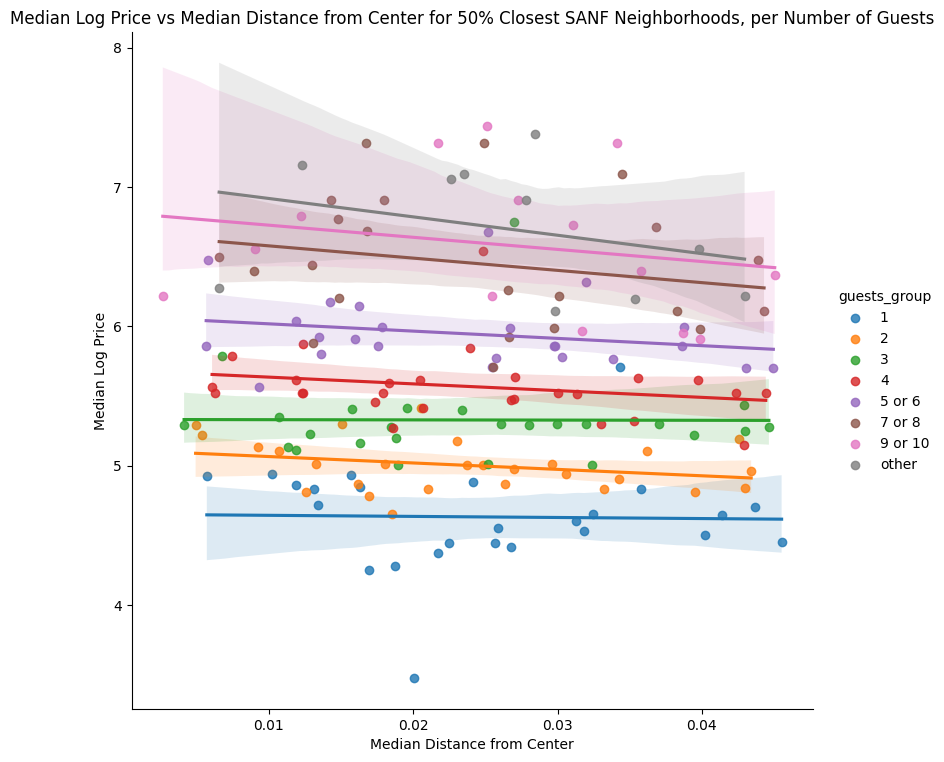

Correlation between Median Price and Median Distance from Center for
1: -0.02246337751610336
2: -0.28533363120314953
3: -0.005094251433148104
4: -0.2219898156902667
5 or 6: -0.2331693115458864
7 or 8: -0.21865536882797942
9 or 10: -0.20426452260101954
other: -0.3160172481266559


<ipython-input-4-724c71d65de3>:149: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["property_type_group"] = df_SANF["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")


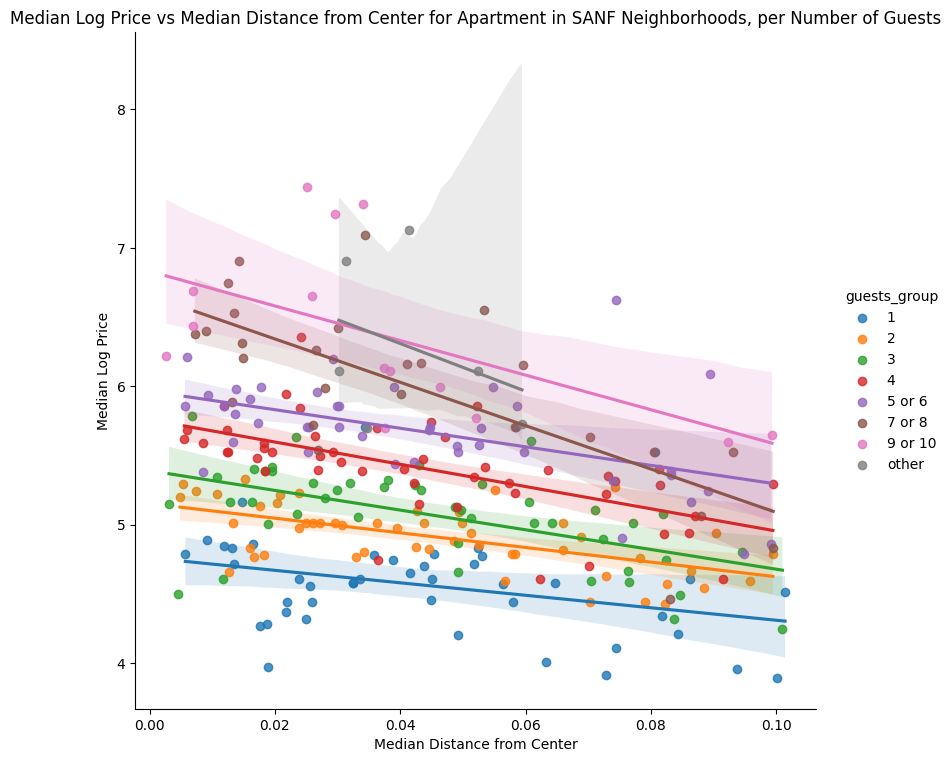

Correlation between Median Price and Median Distance from Center for Apartment
1: -0.3199197336415292
2: -0.599537562924209
3: -0.5542499197952612
4: -0.6142677600199772
5 or 6: -0.512026210612711
7 or 8: -0.7344169330702167
9 or 10: -0.5636079299670256
other: -0.34220859882895693




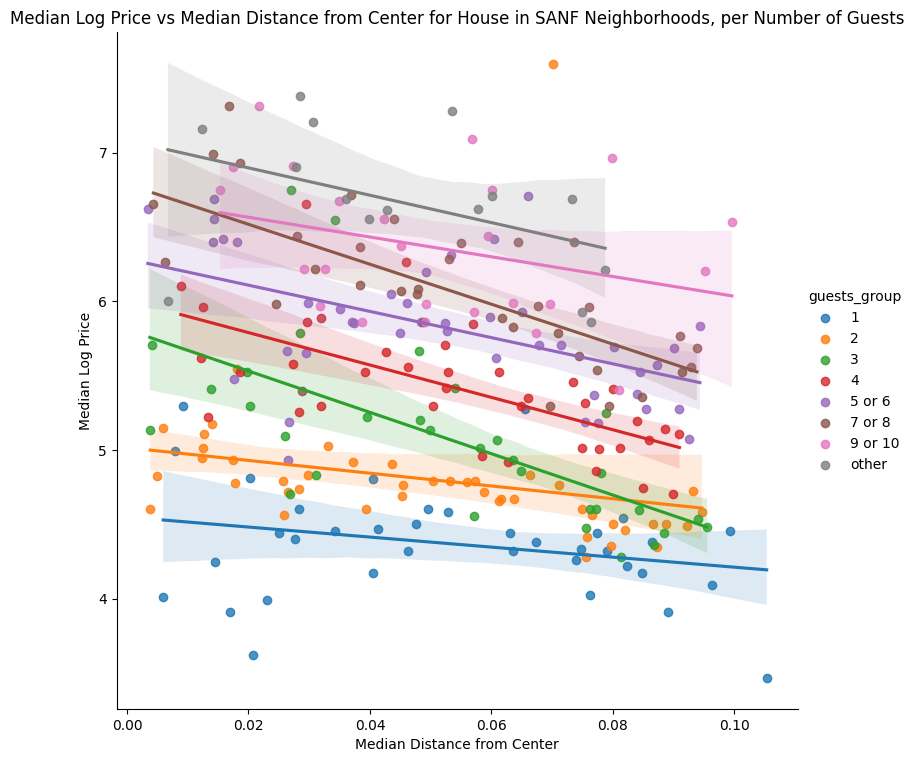

Correlation between Median Price and Median Distance from Center for House
1: -0.2592015662762499
2: -0.2472480343889403
3: -0.65177804937287
4: -0.6489812087700972
5 or 6: -0.5101876714293322
7 or 8: -0.7010764500410591
9 or 10: -0.3189277176744657
other: -0.44123978948323955




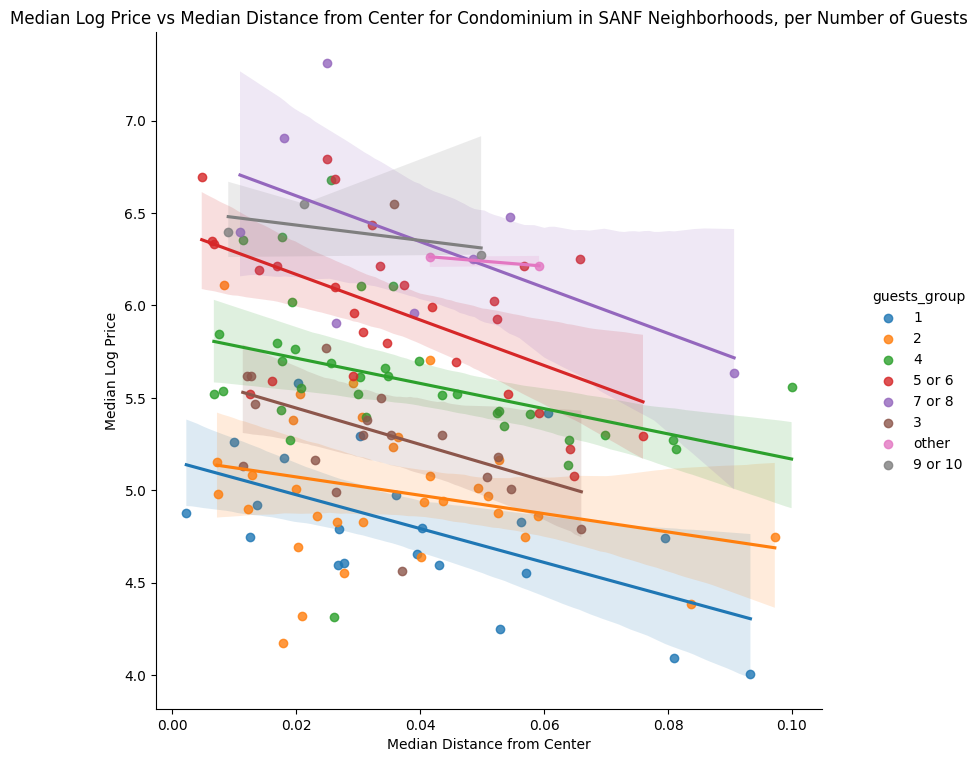

Correlation between Median Price and Median Distance from Center for Condominium
1: -0.5655323296828301
2: -0.25732995695877253
3: -0.36377884741948713
4: -0.3808919452106352
5 or 6: -0.5533991327257884
7 or 8: -0.5761190846289094
9 or 10: -0.6268917419964829
other: -0.9999999999999999




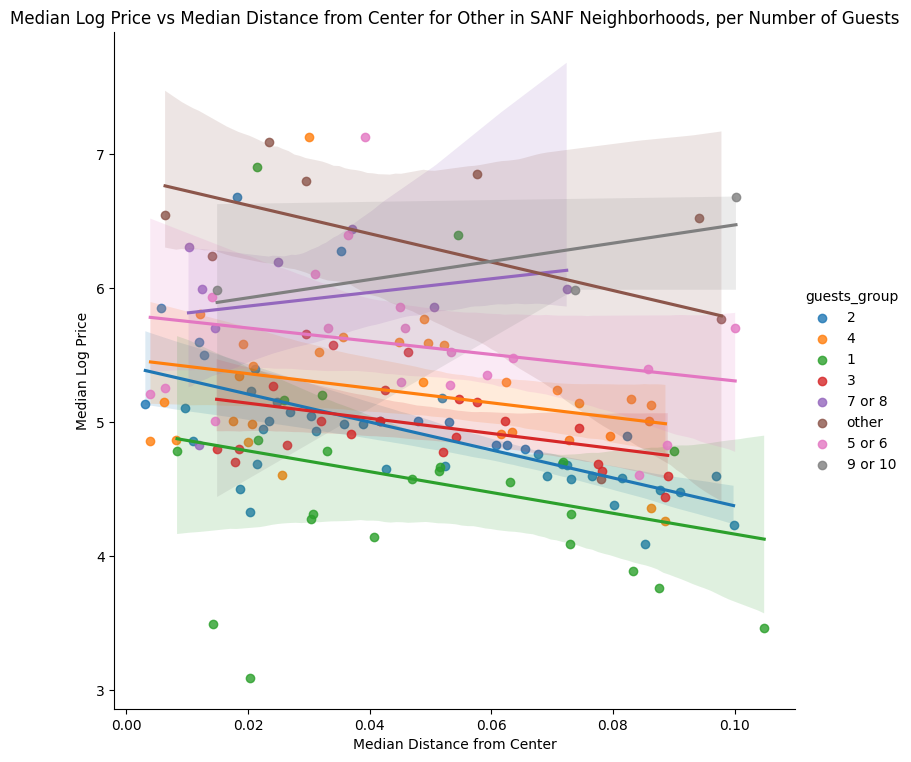

Correlation between Median Price and Median Distance from Center for Other
1: -0.24782442632032892
2: -0.599210155876129
3: -0.40136328444465297
4: -0.2908265241341206
5 or 6: -0.24158248438511862
7 or 8: 0.22996751294614595
9 or 10: 0.7389193426987181
other: -0.4814981567956704




<ipython-input-4-724c71d65de3>:180: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)
<ipython-input-4-724c71d65de3>:183: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["property_type_group"] = df_SANF["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")


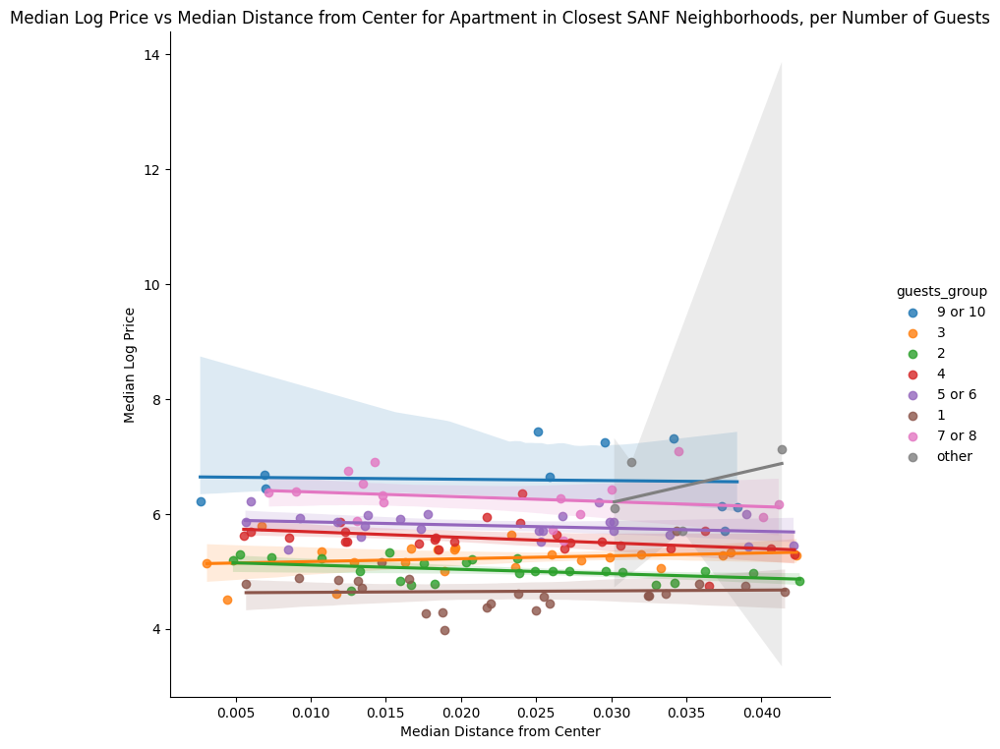

Correlation between Median Price and Median Distance from Center for Apartment in Closest Neighborhoods
1: 0.03715927836506497
2: -0.4171150937895517
3: 0.19570866861368497
4: -0.3667671071895235
5 or 6: -0.27079477899372073
7 or 8: -0.22336455185721826
9 or 10: -0.0556774149697487
other: 0.4480528789195865




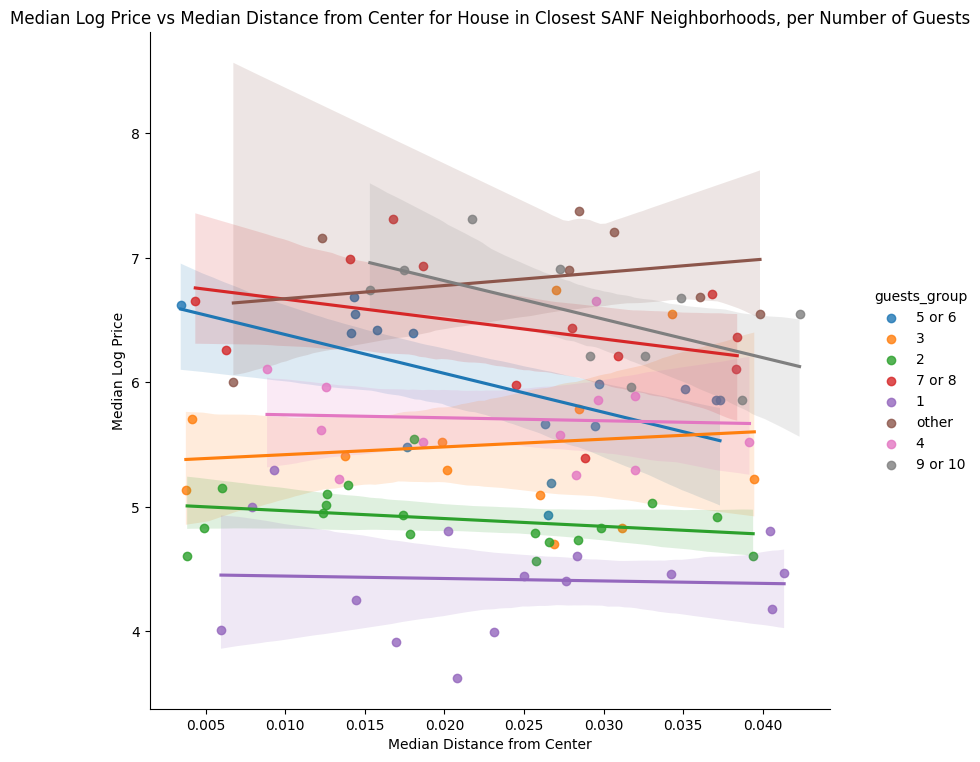

Correlation between Median Price and Median Distance from Center for House in Closest Neighborhoods
1: -0.051992068788488464
2: -0.28115606888412903
3: 0.11082310466493984
4: -0.057832572612833165
5 or 6: -0.5837810961189827
7 or 8: -0.36656293178611704
9 or 10: -0.5888278576718053
other: 0.27151277570438115




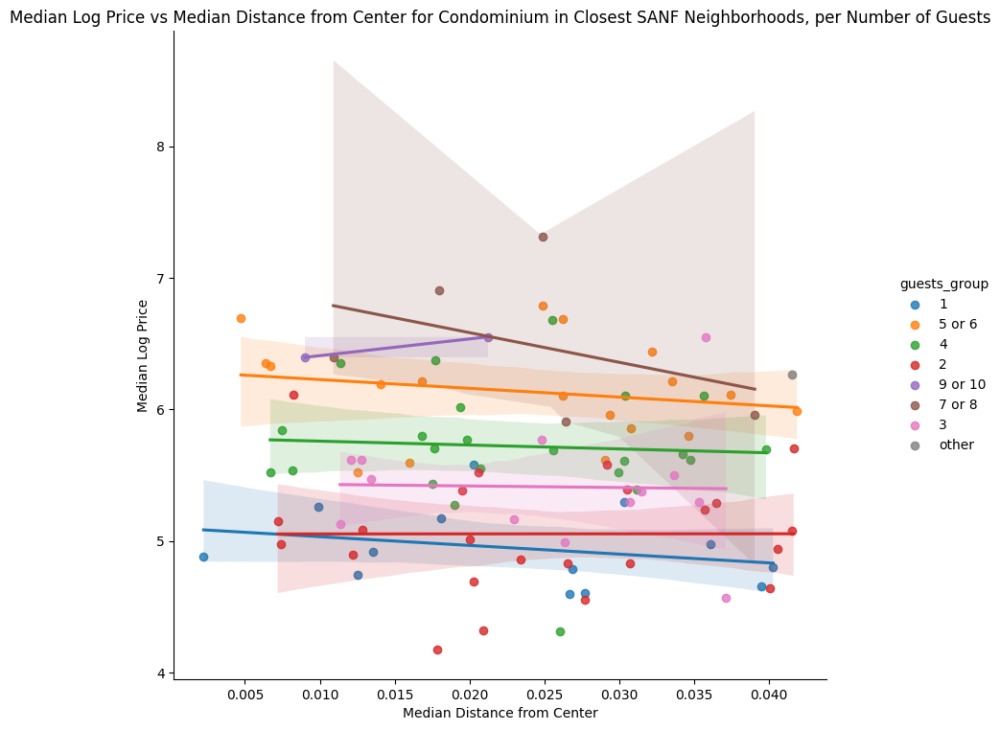

Correlation between Median Price and Median Distance from Center for Condominium in Closest Neighborhoods
1: -0.2603848648418998
2: 0.0011300968218521086
3: -0.02550582188246462
4: -0.06072713796295419
5 or 6: -0.201164932507264
7 or 8: -0.3887354207217993
9 or 10: 1.0
other: nan




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)


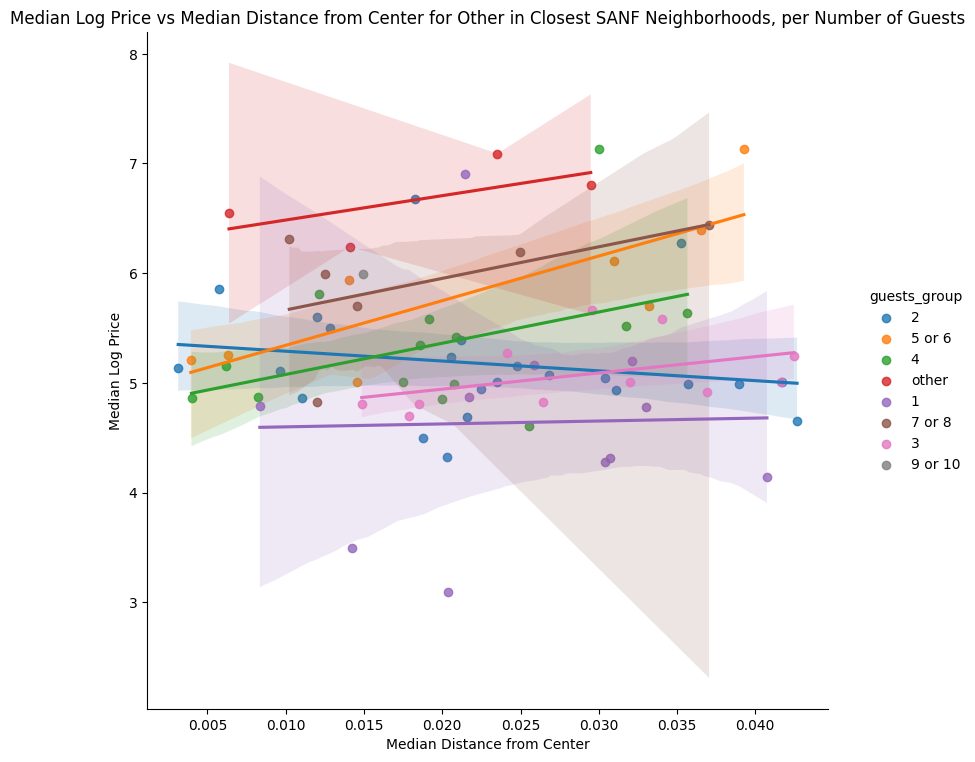

Correlation between Median Price and Median Distance from Center for Other in Closest Neighborhoods
1: 0.024628984558025833
2: -0.18620944007314486
3: 0.4342619255846392
4: 0.4296099547361436
5 or 6: 0.8152434619113138
7 or 8: 0.5105154797418274
9 or 10: nan
other: 0.6247702736905096




/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2821: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.9/dist-packages/numpy/lib/function_base.py:2680: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
<ipython-input-4-724c71d65de3>:222: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SANF["price"] = np.exp(df_SANF["log_price"])


In [ ]:
center_lat = 37.801308
center_long = -122.424502

# Filter for SANF data
df_SANF = air.loc[air.city == "SF"]

# Calculate distance from center for each house in SANF
df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)

# Calculate median distance and price per accommodates for each neighborhood
median_values_neighbourhood = df_SANF.groupby(["neighbourhood"])[["distance", "log_price"]].median().reset_index()

# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for SANF Neighborhoods")

# Calculate correlation
correlation = median_values_neighbourhood["distance"].corr(median_values_neighbourhood["log_price"])
print("Correlation is", correlation)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Visualize the relationship between median price per accommodates and median distance from the center for the 50% closest neighborhoods
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_closest, height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for the 50% Closest SANF Neighborhoods to the Center")

# Calculate correlation for the 50% closest neighborhoods to the center
correlation_closest = median_values_neighbourhood_closest["distance"].corr(median_values_neighbourhood_closest["log_price"])
print("Correlation for the 50% closest neighborhoods to the center is", correlation_closest)



# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Assign the "Close to Center" and "Far from Center" labels based on the closest neighborhoods
df_SANF["distance_group"] = df_SANF["neighbourhood"].apply(lambda x: "Close to Center" if x in median_values_neighbourhood_closest["neighbourhood"].values else "Far from Center")


# Calculate median distance and price per accommodates for each neighborhood group
median_values_neighbourhood_group = df_SANF.groupby(["neighbourhood", "distance_group"])[["distance", "log_price"]].median().reset_index()
# Visualize the relationship between median price per accommodates and median distance from the center for each neighborhood group
plt.figure(figsize=(12, 6))
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood_group, hue="distance_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Price per Accommodates")
plt.title("Median Log Price vs Median Distance from Center for SANF Neighborhoods, by Distance Group")

# Calculate correlation for each group
correlation_close = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Close to Center"]["log_price"])
correlation_far = median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["distance"].corr(median_values_neighbourhood_group[median_values_neighbourhood_group["distance_group"] == "Far from Center"]["log_price"])
print("Correlation for neighborhoods close to the center is", correlation_close)
print("Correlation for neighborhoods far from the center is", correlation_far)


# Calculate distance from center for each house in SANF
df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)

# Group houses based on number of guests
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5 or 6"
    elif x == 7 or x == 8:
        return "7 or 8"
    elif x == 9 or x == 10:
      return "9 or 10"
    else:
        return "other"

df_SANF["guests_group"] = df_SANF["accommodates"].apply(group_guests)

# Calculate median distance and price for each neighborhood and guests group
median_values_neighbourhood = df_SANF.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for SANF Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




df_SANF["guests_group"] = df_SANF["accommodates"].apply(group_guests)

# Calculate median distance for each neighborhood
median_distance_neighbourhood = df_SANF.groupby("neighbourhood")["distance"].median().reset_index()

# Filter 50% closest neighborhoods to the SANF center
closest_neighbourhoods = median_distance_neighbourhood.nsmallest(len(median_distance_neighbourhood) // 2, "distance")["neighbourhood"]

# Filter df_SANF for the closest neighborhoods
df_SANF_closest = df_SANF[df_SANF["neighbourhood"].isin(closest_neighbourhoods)]

# Calculate median distance and log_price for each closest neighborhood and guests group
median_values_neighbourhood = df_SANF_closest.groupby(["neighbourhood", "guests_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplot with hue for guests groups
sns.lmplot(x="distance", y="log_price", data=median_values_neighbourhood, hue="guests_group", height=7.5, aspect=1)
plt.xlabel("Median Distance from Center")
plt.ylabel("Median Log Price")
plt.title("Median Log Price vs Median Distance from Center for 50% Closest SANF Neighborhoods, per Number of Guests")
plt.show()

# Group median_values_neighbourhood by guests_group and calculate correlation for each group
grouped = median_values_neighbourhood.groupby("guests_group")
print("Correlation between Median Price and Median Distance from Center for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["distance"])
    print(f"{guests_group}: {correlation}")




# Group property types
df_SANF["property_type_group"] = df_SANF["property_type"].apply(lambda x: x if x in ["Apartment", "Condominium", "House"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_SANF.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Plot the lmplots and print correlations for each property type group
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood[median_values_neighbourhood["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in SANF Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type}")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




# Calculate distance from center for each house in SANF
df_SANF["distance"] = np.sqrt((df_SANF["latitude"] - center_lat) ** 2 + (df_SANF["longitude"] - center_long) ** 2)

# Group property types
df_SANF["property_type_group"] = df_SANF["property_type"].apply(lambda x: x if x in ["House", "Condominium", "Apartment"] else "Other")

# Calculate median distance and price for each neighborhood, guests group, and property type group
median_values_neighbourhood = df_SANF.groupby(["neighbourhood", "guests_group", "property_type_group"])[["distance", "log_price"]].median().reset_index()

# Sort the median_values_neighbourhood dataframe by distance
median_values_neighbourhood_sorted = median_values_neighbourhood.sort_values(by="distance")

# Filter the 50% closest neighborhoods to the center
median_values_neighbourhood_closest = median_values_neighbourhood_sorted.head(int(len(median_values_neighbourhood_sorted)/2))

# Plot the lmplots and print correlations for each property type group in the closest neighborhoods
property_types = ["Apartment", "House", "Condominium", "Other"]
for property_type in property_types:
    # Filter dataset for the current property type
    plot_data = median_values_neighbourhood_closest[median_values_neighbourhood_closest["property_type_group"] == property_type]

    # Plot the lmplot with hue for guests groups
    sns.lmplot(x="distance", y="log_price", data=plot_data, hue="guests_group", height=7.5, aspect=1)
    plt.xlabel("Median Distance from Center")
    plt.ylabel("Median Log Price")
    plt.title(f"Median Log Price vs Median Distance from Center for {property_type} in Closest SANF Neighborhoods, per Number of Guests")
    plt.show()

    # Group median_values_neighbourhood_closest by guests_group and calculate correlation for each group
    grouped = plot_data.groupby("guests_group")
    print(f"Correlation between Median Price and Median Distance from Center for {property_type} in Closest Neighborhoods")

    for guests_group, group in grouped:
        correlation = group["log_price"].corr(group["distance"])
        print(f"{guests_group}: {correlation}")
    print("\n")




import folium 

# Calculate median price for each neighborhood
df_SANF["price"] = np.exp(df_SANF["log_price"])
median_price_neighbourhood = df_SANF.groupby(["neighbourhood"])["price"].median().reset_index()

# Calculate mean latitude and longitude for each neighborhood
mean_lat_long_neighbourhood = df_SANF.groupby(["neighbourhood"])[["latitude", "longitude"]].mean().reset_index()

# Merge the two dataframes
median_price_lat_long_neighbourhood = pd.merge(median_price_neighbourhood, mean_lat_long_neighbourhood, on="neighbourhood")

# Create a map centered on the Flat Iron Building
SANF_map = folium.Map(location=[center_lat, center_long], zoom_start=12)

# Add circles for each neighborhood
for i, row in median_price_lat_long_neighbourhood.iterrows():
    folium.Circle(
        location=[row["latitude"], row["longitude"]],
        radius=(row["price"]*2),
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opaSANF=0.2,
        tooltip=row["neighbourhood"] + " median price: " + str(round(row["price"], 2))
    ).add_to(SANF_map)

# Display the map
SANF_map

# Vicinity to Train Stations - LA and NYC

Using public data from the municipalities of LA and NYC, we downloaded a list of all metro stations of both LA and NYC. We then computed the euclidean distance between each property and each train station. Then, for each house we found the distance to the nearest metro.

To visualize the correlation, we first used a scatterplot. However, since the data was too dense, we binned the property based on the distance to the nearesr metro.

For NYC, the closeness to the metro seems to be relevant for houses with an entire apartment as property_type. In LA, the nearest the metro to the property, the lower the price. 

**Train Stations of NYC**

In [ ]:
NYC_station_df = pd.read_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/NYC Subway.csv")
coordinates = NYC_station_df["the_geom"]

longitude_array = np.array([])
latitude_array = np.array([])
for coordinate in coordinates: 
  coordinate_array = coordinate.translate(str.maketrans("", "", "()")).split(" ")
  longitude_array = np.append(longitude_array, np.float128(coordinate_array[1]))
  latitude_array = np.append(latitude_array, np.float128(coordinate_array[2]))
  
stations_array = np.c_[latitude_array, longitude_array]

df_NYC = air[air.city == "NYC"]

#distances = np.empty(shape=(len(df_NYC), len(stations_array)), dtype = np.float128)
distances = []

for i, house in df_NYC.iterrows():
  distances_for_station = []
  for j, station in enumerate(stations_array):
  
    distance = math.sqrt((house["latitude"]-station[0])**2+(house["longitude"]-station[1])**2)
    distances_for_station.append(distance)
  
  distances.append(distances_for_station)
    

pd.DataFrame(distances).to_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/NYC Subway distances.csv")


<ipython-input-4-8ae2d3247020>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["Min_dist_metro_bins"] = min_distances
<ipython-input-4-8ae2d3247020>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NYC["Min_dist_metro_bins"] = min_dist_metro_bins
<ipython-input-4-8ae2d3247020>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

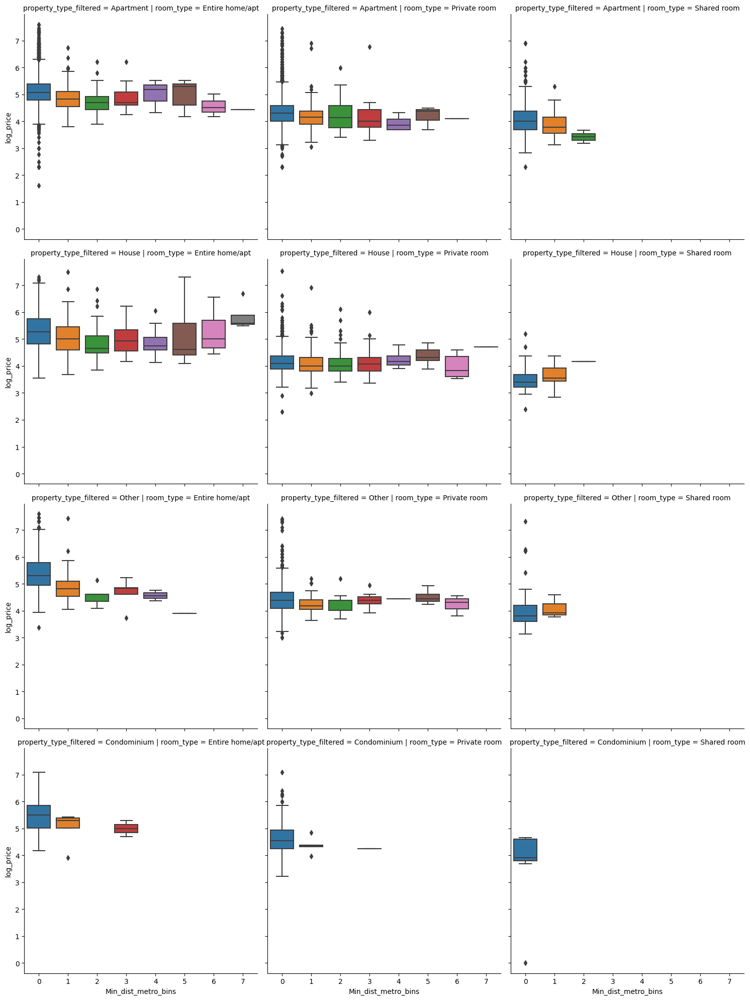

In [ ]:
distances = pd.read_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/NYC Subway distances.csv").to_numpy()

min_distances = []

for distance_array in distances:

  min_distances.append(min(distance_array))

df_NYC = air[air.city == "NYC"]
df_NYC["Min_dist_metro_bins"] = min_distances

bins = [0.01, 0.03, 0.05,0.07, 0.09, 0.12,  0.2, 0.3]
min_dist_metro_bins = np.digitize(df_NYC["Min_dist_metro_bins"], bins)
df_NYC["Min_dist_metro_bins"] = min_dist_metro_bins
df_NYC["property_type_filtered"] = df_NYC["property_type"].apply(lambda x: x if x in [ "Apartment","Condominium", "House"] else "Other")

sns.catplot(data = df_NYC, x = "Min_dist_metro_bins", y = "log_price", kind = "box", col = "room_type", row = "property_type_filtered")

**Train Stations of LA**

In [ ]:
LA_station_df = pd.read_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/LA Subway.csv")

LA_stations_array = np.c_[LA_station_df["latitude"], LA_station_df["longitude"]]

df_LA = air.loc[air.city == "LA"].copy()

LA_distances = []

for _, house in df_LA.iterrows():
  distances_for_station = []
  for _, station in enumerate(LA_stations_array):
  
    distance = math.sqrt((house["latitude"]-station[0])**2+(house["longitude"]-station[1])**2)
    distances_for_station.append(distance)
  
  LA_distances.append(distances_for_station)
    

pd.DataFrame(LA_distances).to_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/LA Subway distances.csv")

<ipython-input-5-4d203f5a2510>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["Min_dist_metro"] = min_distances
<ipython-input-5-4d203f5a2510>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_LA["Min_dist_metro_bins"] = min_dist_metro_bins
<ipython-input-5-4d203f5a2510>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

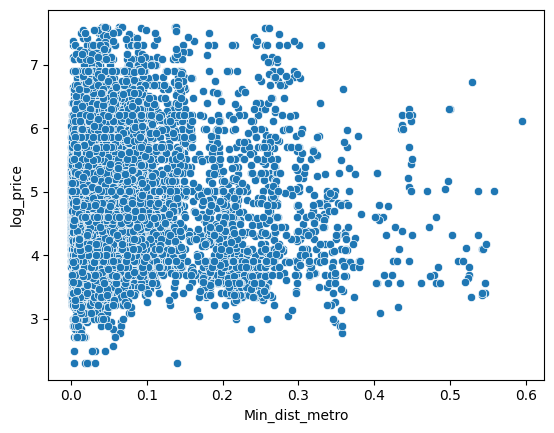

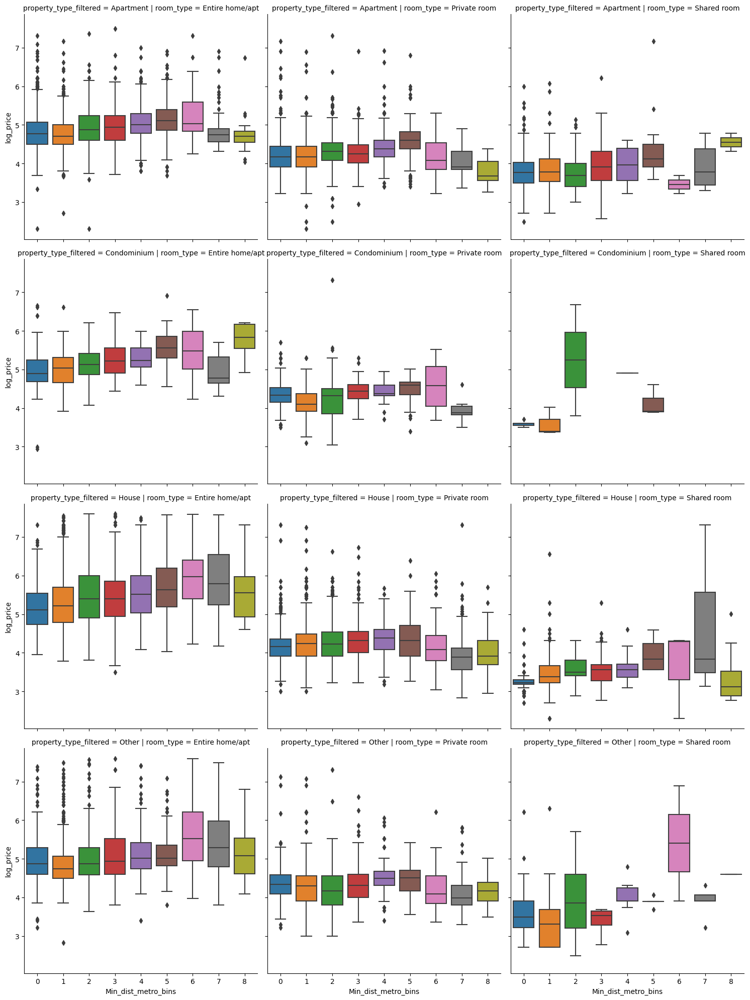

In [ ]:
distances = pd.read_csv("/content/drive/MyDrive/Stats Project/Subway Stations Analysis/LA Subway distances.csv").to_numpy()

df_LA = air[air.city == "LA"]
min_distances = []

for distance_array in distances:

  #closest_2 = sum(np.sort(distance_array)[:2])

  min_distances.append(min(distance_array))

df_LA["Min_dist_metro"] = min_distances

sns.scatterplot(data = df_LA, x = "Min_dist_metro", y = "log_price")

bins = [0.01, 0.03, 0.05,0.07, 0.09, 0.12,  0.2, 0.3]
min_dist_metro_bins = np.digitize(df_LA["Min_dist_metro"], bins)
df_LA["Min_dist_metro_bins"] = min_dist_metro_bins
df_LA["property_type_filtered"] = df_LA["property_type"].apply(lambda x: x if x in [ "Apartment","Condominium", "House"] else "Other")

sns.catplot(data = df_LA, x = "Min_dist_metro_bins", y = "log_price", col = "room_type", row = "property_type_filtered", kind = "box")

**Direct Comparison between LA and NYC**

In [ ]:
LA_NYC_DF = pd.concat([df_LA, df_NYC])

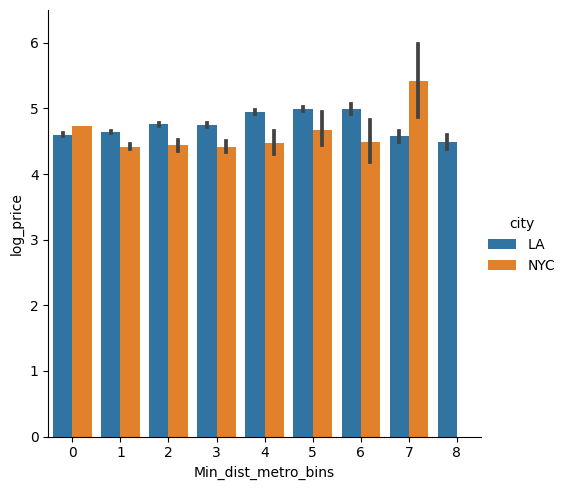

In [ ]:
sns.catplot(data = LA_NYC_DF, x = "Min_dist_metro_bins", y = "log_price", hue = "city",  kind = "bar").set(ylim = (0,6.5))

# Vicinity to Tourist Attractions

The goal is to analyze the relationship between the number and popularity of tourist attraction nearby a property and the price of that property. To do this, we leverage the Google Maps nearby search API, which receives as input some GPS coordinate and returns the number of places of interest (tourist attraction, airport, bus stop, bar; etc. ) in a given radius around that coordinate. Since the API is relatively costly (it would have cost us 2200$, per place of interest, to do the analysis on the whole dataset), we only choose one place of interest (tourist attracions) and run the analysis on a random sample of 1000 property per city.

The goal of this analysis is to obtain a weighted tourist attraction vicinity index. This index has to be proportional to: 


1.   The number of tourist attraction a property has within 1.5 km
2.   The rating (1-5) of each tourist attraction
3.   The number of reviews each tourist attraction has (a proxy of popularity)



**Correlations found for number of tourist attraction (weighed by popularity) and price**

0.44 for Boston

0.35 for NYC

0.31 for Chicago

0.17 for LA

0.12 for SF

0.22 for DC

In [ ]:
import requests
air = pd.read_csv("/content/drive/MyDrive/Stats Project/AirBB Dataset.csv")

**Function to interact with API**

In [ ]:
def send_req(lat, long, type, radius = 1500): #search within 1.5 km of the property. #This returns a list of the places of category "type", e.g airport, within the radius of the AIRBB listing
  lat_long_str = f"{lat},{long}"
  API_Key = "API-KEY-FROM-Google-MAPS" #This it the API-key associated with our Google Maps developer account
  url = f"https://maps.googleapis.com/maps/api/place/nearbysearch/json?location={lat_long_str}&radius={radius}&type={type}&key={API_Key}&rankby=prominence"
  payload={}
  headers ={}
  response = requests.request("GET", url, headers=headers, data=payload)

  #parsing response
  places_parsed = []
  for result in  response.json()["results"]:
    place = {
        "place_id": result["place_id"],
        "name" : result["name"] if "name" in result else "N.D",
        "rating": result["rating"] if "rating" in result else "N.D",
        "user_ratings_total": result["user_ratings_total"] if "user_ratings_total" in result else "N.D"
    }
    places_parsed.append(place)

  return places_parsed

##Analysis on DC

**Finding the tourist attractions**

For each property, there are on average 20 rows, one for each tourist attraction found within 1.5 km. Each row also has the rating (1-5) given by users to that attraction as well as the number of rating that attraction has.

In [ ]:
df_DC = air.loc[air.city == "DC"].sample(n=1000)
df_places_DC = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in df_DC.iterrows():
  print("fetching places for property ", i)
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_DC= df_places_DC.append(new_row, ignore_index = True)

In [ ]:
df_places_DC.drop(df_places_DC[(df_places_DC.rating == "N.D") | (df_places_DC.user_ratings_total == "N.D")].index, inplace = True, axis = 0) #We drop the columns containing N.D
df_places_DC.to_csv("/content/drive/MyDrive/Stats Project/places_DC_temp.csv") #Save the dataset for future use

In [ ]:
df_places_DC = pd.read_csv("/content/drive/MyDrive/Stats Project/places_DC_temp.csv")

**Calculating a weighted index**

For each tourist attraction of each property, we calculate a weigthed index, considering the factors explained in the first paragraph of the notebook. 

Firstly, for each tourist attraction we calculate the weighted rating, by multiplying the rating by the number of user ratings. Despite this not being ideal, we could not find any other method. Note that what we are most interested in is the the number of reviews, as that is the real proxy of popularity. The rating for a tourist attraction is not as much informative

In [ ]:
WR_array = []
for i, row in df_places_DC.iterrows():
  WR_array.append(row["rating"]*row["user_ratings_total"])

df_places_DC["weighted_ratings"] = WR_array

**Creating the dataset with log price**

In [ ]:
df_places_DC.rating = df_places_DC.rating.astype(float)
df_places_DC.user_ratings_total = df_places_DC.user_ratings_total.astype(float)

df_houses_DC = df_places_DC.groupby("property_id").sum() #For each property, we sum all the weighted rating of the nearby tourist attraction

log_price_array = []

for i, house in df_houses_DC.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses_DC["log_price"] = log_price_array
df_houses_DC["weighted_ratings_log"] = np.log(df_houses_DC["user_ratings_total"])

**Analyzing the correlation**

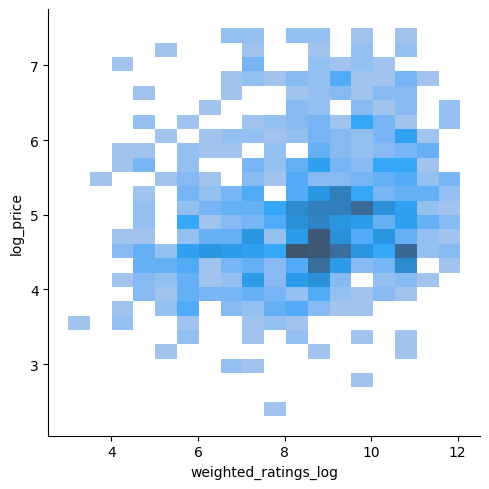

In [ ]:
sns.displot(data = df_houses_DC, x = "weighted_ratings_log", y = "log_price")

In [ ]:
np.corrcoef(df_houses_DC["weighted_ratings_log"], df_houses_DC["log_price"])

array([[1.        , 0.22241888],
       [0.22241888, 1.        ]])

##Analysis on San Francisco

In [ ]:
df_SF = air.loc[air.city == "SF"].sample(n=1000)
df_places_SF = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in df_SF.iterrows():
  print("fetching places for property ", i)
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_SF= df_places_SF.append(new_row, ignore_index = True)

In [ ]:
df_places_SF.drop(df_places_SF[(df_places_SF.rating == "N.D") | (df_places_SF.user_ratings_total == "N.D")].index, inplace = True, axis = 0)
df_places_SF.to_csv("/content/drive/MyDrive/Stats Project/places_SF_temp.csv")

In [ ]:
df_places_SF = pd.read_csv("/content/drive/MyDrive/Stats Project/places_SF_temp.csv")

In [ ]:
WR_array = []
for i, row in df_places_SF.iterrows():
  #WR_array.append(find_WR(W, R, row["rating"], row["user_ratings_total"]))
  WR_array.append(row["rating"]*row["user_ratings_total"]) #I am trying to calculate the index by simply multiplying the rating score times the number of reviews

df_places_SF["weighted_ratings"] = WR_array

In [ ]:
df_places_SF.rating = df_places_SF.rating.astype(float)
df_places_SF.user_ratings_total = df_places_SF.user_ratings_total.astype(float)

df_houses_SF = df_places_SF.groupby("property_id").sum()

log_price_array = []

for i, house in df_houses_SF.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses_SF["log_price"] = log_price_array
df_houses_SF["weighted_ratings_log"] = np.log(df_houses_SF["user_ratings_total"])

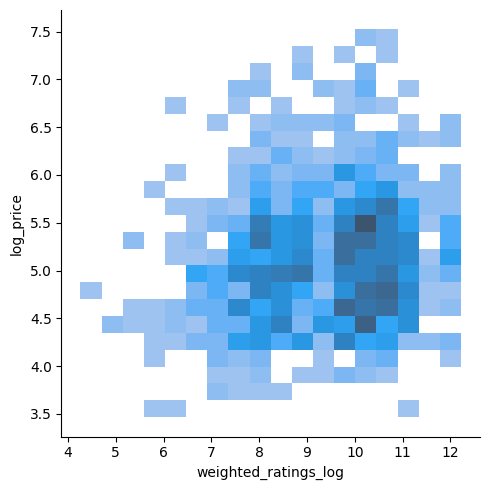

In [ ]:
sns.displot(data = df_houses_SF, x = "weighted_ratings_log", y = "log_price")

In [ ]:
np.corrcoef(df_houses_SF["weighted_ratings_log"], df_houses_SF["log_price"])

array([[1.        , 0.12982425],
       [0.12982425, 1.        ]])

## Analysis on Chicago

In [ ]:
df_Chicago = air.loc[air.city == "Chicago"].sample(n=1000)
df_places_Chicago = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in df_Chicago.iterrows():
  print("fetching places for property ", i)
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_Chicago = df_places_Chicago.append(new_row, ignore_index = True)

In [ ]:
df_places_Chicago.drop(df_places_Chicago[(df_places_Chicago.rating == "N.D") | (df_places_Chicago.user_ratings_total == "N.D")].index, inplace = True, axis = 0)
df_places_Chicago.to_csv("/content/drive/MyDrive/Stats Project/places_Chicago_temp.csv")

In [ ]:
df_places_Chicago = pd.read_csv("/content/drive/MyDrive/Stats Project/places_Chicago_temp.csv")

In [ ]:
WR_array = []
for i, row in df_places_Chicago.iterrows():
  #WR_array.append(find_WR(W, R, row["rating"], row["user_ratings_total"]))
  WR_array.append(row["rating"]*row["user_ratings_total"]) #I am trying to calculate the index by simply multiplying the rating score times the number of reviews

df_places_Chicago["weighted_ratings"] = WR_array

In [ ]:
df_places_Chicago.rating = df_places_Chicago.rating.astype(float)
df_places_Chicago.user_ratings_total = df_places_Chicago.user_ratings_total.astype(float)

df_houses_Chicago = df_places_Chicago.groupby("property_id").sum()

log_price_array = []

for i, house in df_houses_Chicago.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses_Chicago["log_price"] = log_price_array
df_houses_Chicago["user_ratings_total_log"] = np.log(df_houses_Chicago["user_ratings_total"])
df_houses_Chicago["weighted_ratings_log"] = np.log(df_houses_Chicago["user_ratings_total"])

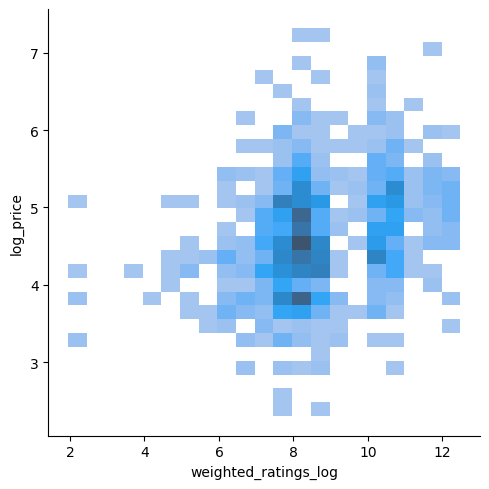

In [ ]:
sns.displot(data = df_houses_Chicago, x = "weighted_ratings_log", y = "log_price")

In [ ]:
np.corrcoef(df_houses_Chicago["weighted_ratings_log"], df_houses_Chicago["log_price"])

array([[1.        , 0.31165434],
       [0.31165434, 1.        ]])

##Analysis on LA

In [ ]:
df_LA = air.loc[air.city == "LA"].sample(n=1000)
df_places_LA = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in df_LA.iterrows():
  print("fetching places for property ", i)
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_LA = df_places_LA.append(new_row, ignore_index = True)

In [ ]:
df_places_LA.drop(df_places_LA[(df_places_LA.rating == "N.D") | (df_places_LA.user_ratings_total == "N.D")].index, inplace = True, axis = 0)
df_places_LA.to_csv("/content/drive/MyDrive/Stats Project/places_LA_temp.csv")

In [ ]:
df_places_LA = pd.read_csv("/content/drive/MyDrive/Stats Project/places_LA_temp.csv")

In [ ]:
WR_array = []
for i, row in df_places_LA.iterrows():
  #WR_array.append(find_WR(W, R, row["rating"], row["user_ratings_total"]))
  WR_array.append(row["rating"]*row["user_ratings_total"]) #I am trying to calculate the index by simply multiplying the rating score times the number of reviews

df_places_LA["weighted_ratings"] = WR_array

In [ ]:
df_places_LA.rating = df_places_LA.rating.astype(float)
df_places_LA.user_ratings_total = df_places_LA.user_ratings_total.astype(float)

df_houses_LA = df_places_LA.groupby("property_id").sum()

log_price_array = []

for i, house in df_houses_LA.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses_LA["log_price"] = log_price_array
df_houses_LA["weighted_ratings_log"] = np.log(df_houses_LA["user_ratings_total"])

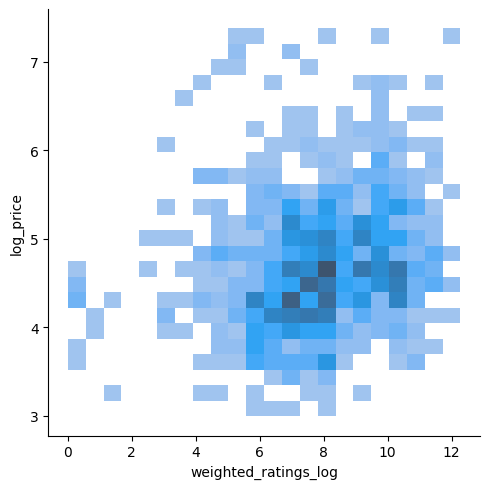

In [ ]:
sns.displot(data = df_houses_LA, x = "weighted_ratings_log", y = "log_price")

In [ ]:
np.corrcoef(df_houses_LA["weighted_ratings_log"], df_houses_LA["log_price"])

array([[1.        , 0.17755933],
       [0.17755933, 1.        ]])

## Analysis of Boston

In [ ]:
df_boston = air.loc[air.city == "Boston"].sample(n=1000)
df_places_Boston = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in df_boston.iterrows():
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_Boston = df_places_Boston.append(new_row, ignore_index = True)

In [ ]:
df_places_Boston.drop(df_places_Boston[(df_places_Boston.rating == "N.D") | (df_places_Boston.user_ratings_total == "N.D")].index, inplace = True, axis = 0)

In [ ]:
df_places_Boston.to_csv("/content/drive/MyDrive/Stats Project/places_Boston_temp.csv")

In [ ]:
df_places_Boston = pd.read_csv("/content/drive/MyDrive/Stats Project/places_Boston_temp.csv")
WR_array = []
for i, row in df_places_Boston.iterrows():
  WR_array.append(row["rating"]*row["user_ratings_total"]) 

df_places_Boston["weighted_ratings"] = WR_array

In [ ]:
df_places_Boston.rating = df_places_Boston.rating.astype(float)
df_places_Boston.user_ratings_total = df_places_Boston.user_ratings_total.astype(float)

df_houses_Boston = df_places_Boston.groupby("property_id").sum()

log_price_array = []

for i, house in df_houses_Boston.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses_Boston["log_price"] = log_price_array

In [ ]:
df_houses_Boston["user_ratings_total_log"] = np.log(df_houses_Boston["user_ratings_total"])
df_houses_Boston["weighted_ratings_log"] = np.log(df_houses_Boston["user_ratings_total"])

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

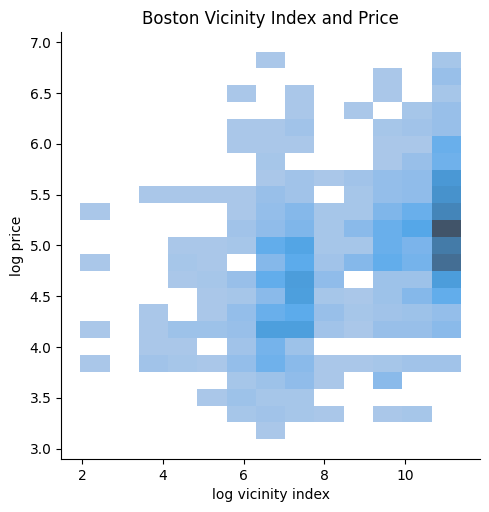

In [ ]:
ax = sns.displot(data = df_houses_Boston, x = "weighted_ratings_log", y = "log_price")
ax.set(xlabel='log vicinity index', ylabel='log price', title = "Boston Vicinity Index and Price")

 

In [ ]:
np.corrcoef(df_houses_Boston["weighted_ratings_log"], df_houses_Boston["log_price"])

array([[1.        , 0.44531129],
       [0.44531129, 1.        ]])



##Analysis of NYC

In [ ]:
df_places_NYC = pd.DataFrame(columns = ["property_id", "place_id", "name", "rating", "user_ratings_total"])
for i, house in air.loc[air.city == "NYC"].iterrows():
  print("fetching places for property ", i)
  for place in send_req(house["latitude"], house["longitude"], "tourist_attraction"):
    new_row = {
        "property_id": house["id"], 
        "place_id": place["place_id"], 
        "name": place["name"],
        "rating": place["rating"],
        "user_ratings_total": place["user_ratings_total"]
    }
    df_places_NYC = df_places_NYC.append(new_row, ignore_index = True)



In [ ]:
#drop N.D values
df_places_NYC.drop(df_places_NYC[(df_places_NYC.rating == "N.D") | (df_places_NYC.user_ratings_total == "N.D")].index, inplace = True, axis = 0)
df_places_NYC.to_csv("/content/drive/MyDrive/Stats Project/places_NYC_temp.csv")


In [ ]:
df_places_NYC = pd.read_csv("/content/drive/MyDrive/Stats Project/places_NYC_temp.csv")

In [ ]:
df_places_NYC.user_ratings_total = df_places_NYC.user_ratings_total.astype(float)
df_houses = df_places_NYC.groupby("property_id").sum()
log_price_array = []

for i, house in df_houses.iterrows():

  log_price_array.append(air.loc[air.id == i].log_price.values[0])

df_houses["log_price"] = log_price_array
df_houses["user_ratings_total_log"] = np.log(df_houses["user_ratings_total"])
df_houses["weighted_ratings_total_log"] = np.log(df_houses["user_ratings_total"])

<Axes: xlabel='weighted_ratings_log', ylabel='log_price'>

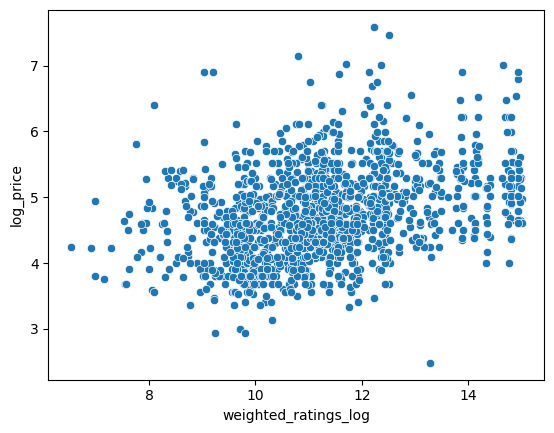

In [ ]:
sns.scatterplot(data = df_houses, x = "weighted_ratings_log", y = "log_price")

In [ ]:
np.corrcoef(df_houses["user_ratings_total_log"], df_houses["log_price"])

array([[1.        , 0.35338594],
       [0.35338594, 1.        ]])

# Host/Platform Analysis

In [ ]:
### SETUP Host/Reviews Analysis

# transforming the log price in normal price 
air["price"] = air.apply(lambda row: np.exp(row["log_price"]), axis = 1)

# grouping the groups of people to lower down the possible values that the variable can take
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5-6"
    elif x == 7 or x == 8:
        return "7-8"
    elif x == 9 or x == 10:
        return "9-10"
    else:
        return ">10"
air["guests_group"] = air["accommodates"].apply(group_guests)

##Host Verification analysis for each city and type of property




**General analysis:** the price of properties with non-verified hosts is on average higher compared to the verified, why? Quite different from intuition 

### General

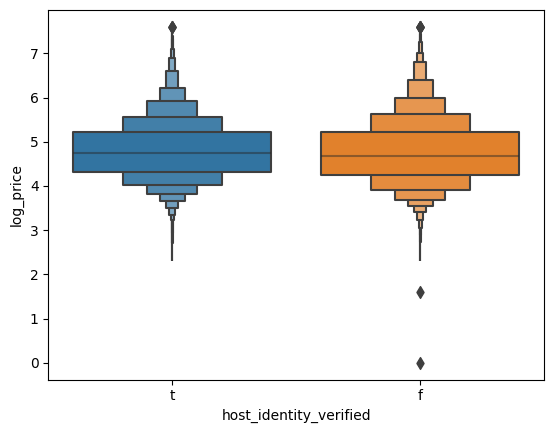

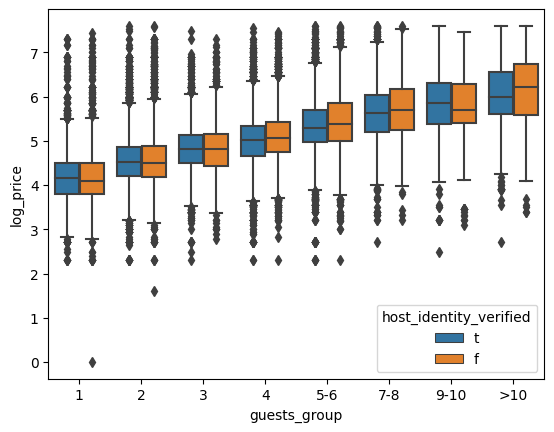

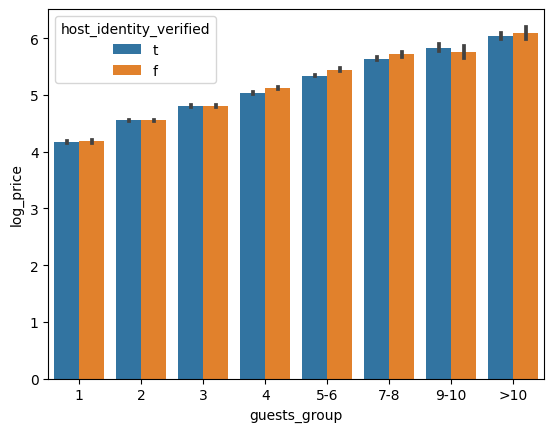

In [ ]:
# see the distribution of prices in verified and non-verified hosts
sns.boxenplot(data = air, x = "host_identity_verified", y = "log_price", order = ["t", "f"])
plt.show()
print('')
# median price of the verified is slightly higher, nothing remarkable

# let's see now if we divide into guests groups what happens
sns.boxplot(data = air, x = "guests_group", y = "log_price", hue = "host_identity_verified", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"])
plt.show()
print('')
# even here inconclusive analysis, we have slightly different medians for each category

# what if instead we considered the mean?
sns.barplot(data = air, x = "guests_group", y = "log_price", hue = "host_identity_verified", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"])
plt.show()
print('')
# nothing significant here either

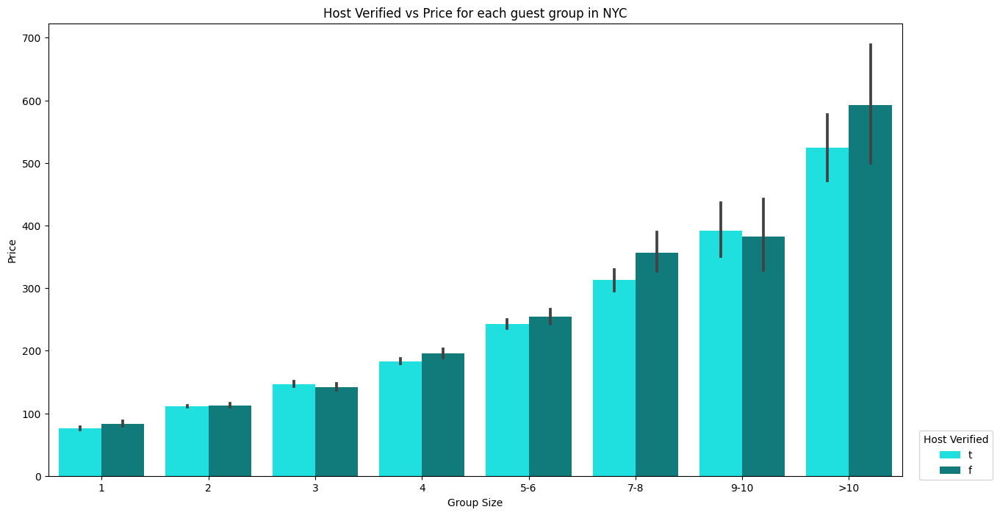

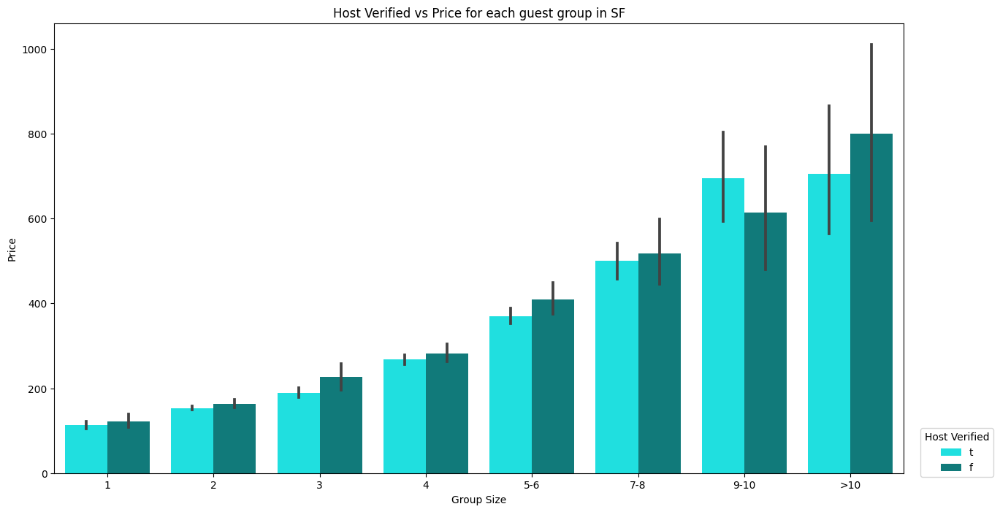

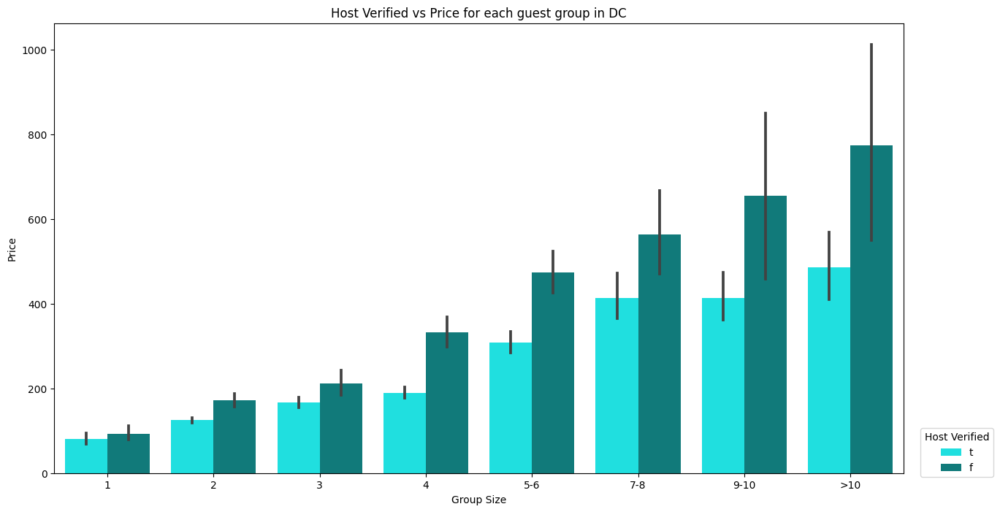

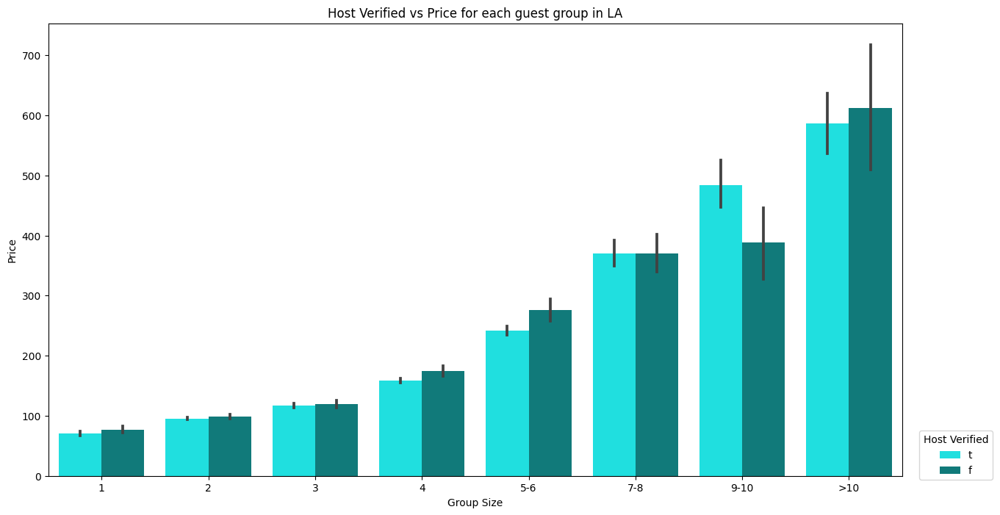

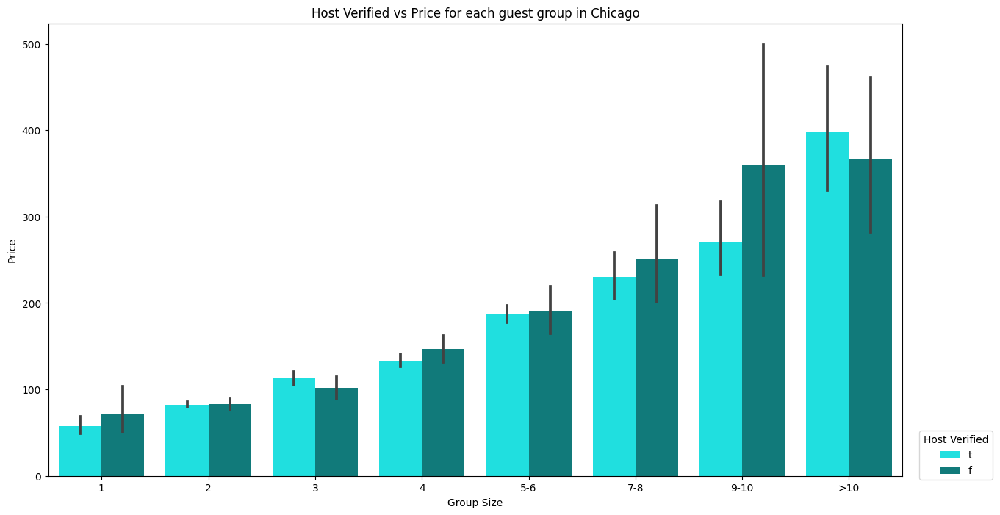

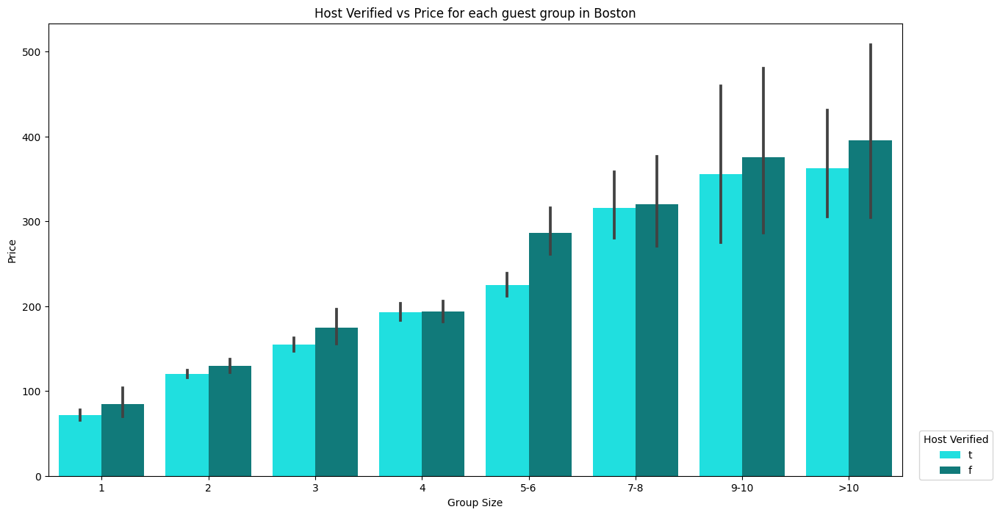

In [ ]:
# now let's make plots per each city and see what are the results (comparing means and displaying the confidence interval)
cities = air["city"].unique()
my_palette = {"t": "cyan", "f": "darkcyan"}

for city in cities:
  plt.figure(figsize = (15,8))
  g = sns.barplot(data = air[air.city == city], x = "guests_group", y = "price", hue = "host_identity_verified", palette=my_palette, order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"], hue_order = ["t","f"])
  plt.title(f"Host Verified vs Price for each guest group in {city}")
  plt.xlabel("Group Size")
  plt.ylabel("Price")
  plt.legend(bbox_to_anchor=(1.02, 0.1), loc='upper left', borderaxespad=0, title = "Host Verified")
  plt.show()
  print('')

# we can see in this case that there is a slight tendency of the price to be higher in the non-verified hosts

### More detailed analysis of the previous finding

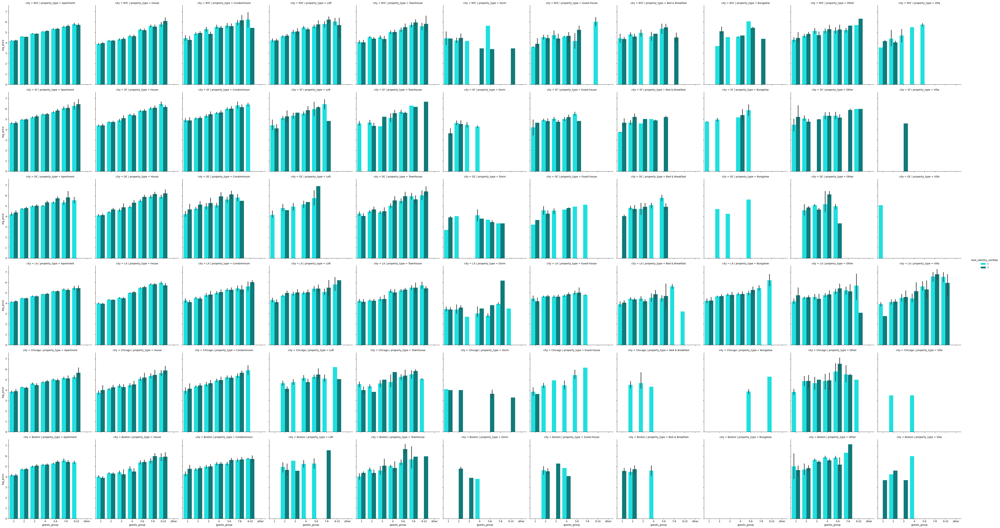

In [ ]:
# We can well see in this case that is not actually a general tendency, but can be seen in specific situations. For example DC|House, or DC|apartment. In quite some cases is the complete opposite. (""Simpson's Paradox"")
sns.catplot(data = air, col = "property_type", row = "city", hue = "host_identity_verified", x = "guests_group", y = "log_price", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", "other"], palette=my_palette, kind = "bar")
plt.show()

All types of properties are quite dominated by the non-verified hosts

### Insights

In [ ]:
#host_verified_pct = 100 * sum(air["host_identity_verified"]) / len(air)
air["host_identity_verified"] = air["host_identity_verified"].replace({"f": 0, "t": 1})
host_verified_pct = 100 * sum(air["host_identity_verified"]) / len(air)
x = 100 * sum(air.loc[air["log_price"].quantile(0.9) <= air["log_price"], "host_identity_verified"]) / sum(air["host_identity_verified"])

print(f"{round(host_verified_pct, 1)}% of properties have a verified host, and only {round(x, 1)}% of those is in the top 10% most expensive properties")

67.3% of properties have a verified host, and only 9.8% of those is in the top 10% most expensive properties


## Host response rate 




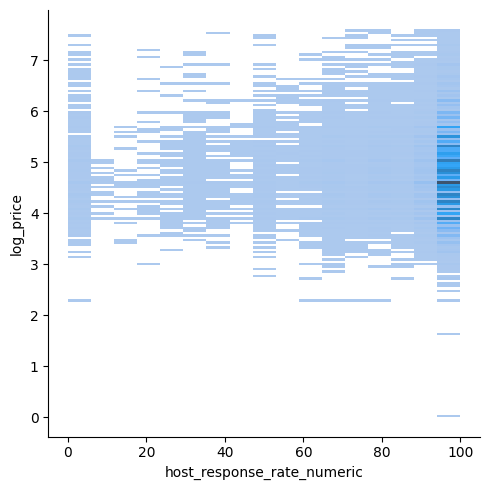

In [ ]:
# plot to have an idea of the concentration of the price per host response rate and try to find a pattern
sns.displot(data = air, x = "host_response_rate_numeric", y = "log_price") 

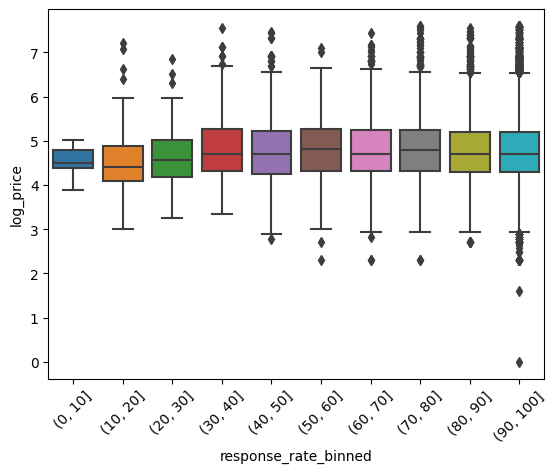

In [ ]:
# plot boxplots of the price for each host response rate bin
sns.boxplot(data = air, x = "response_rate_binned", y = "log_price", order = ["(0, 10]", "(10, 20]","(20, 30]","(30, 40]","(40, 50]","(50, 60]","(60, 70]","(70, 80]", "(80, 90]", "(90, 100]"]) 
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)

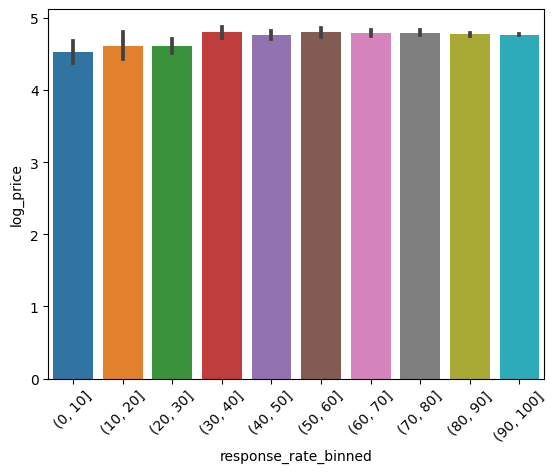

In [ ]:
# same plot but now with barplot
sns.barplot(data = air, x = "response_rate_binned", y = "log_price", order = ["(0, 10]", "(10, 20]","(20, 30]","(30, 40]","(40, 50]","(50, 60]","(60, 70]","(70, 80]", "(80, 90]", "(90, 100]"]) 
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)
# not significant pattern

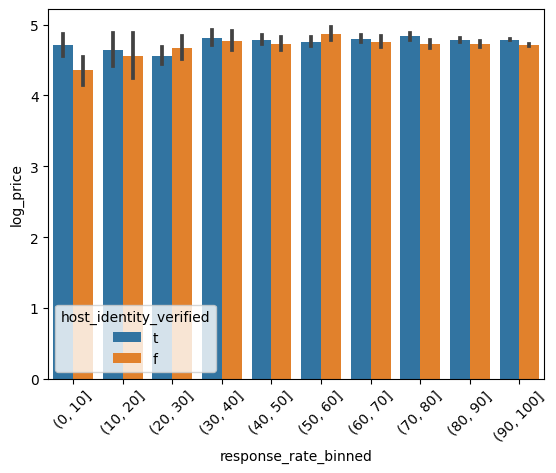

In [ ]:
# barplot to see differences adding the variable host verification
sns.barplot(data = air, x = "response_rate_binned", y = "log_price", order = ["(0, 10]", "(10, 20]","(20, 30]","(30, 40]","(40, 50]","(50, 60]","(60, 70]","(70, 80]", "(80, 90]", "(90, 100]"], hue = "host_identity_verified") 
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)
# tendency of the price to be higher in verified hosts when looking at high response rates

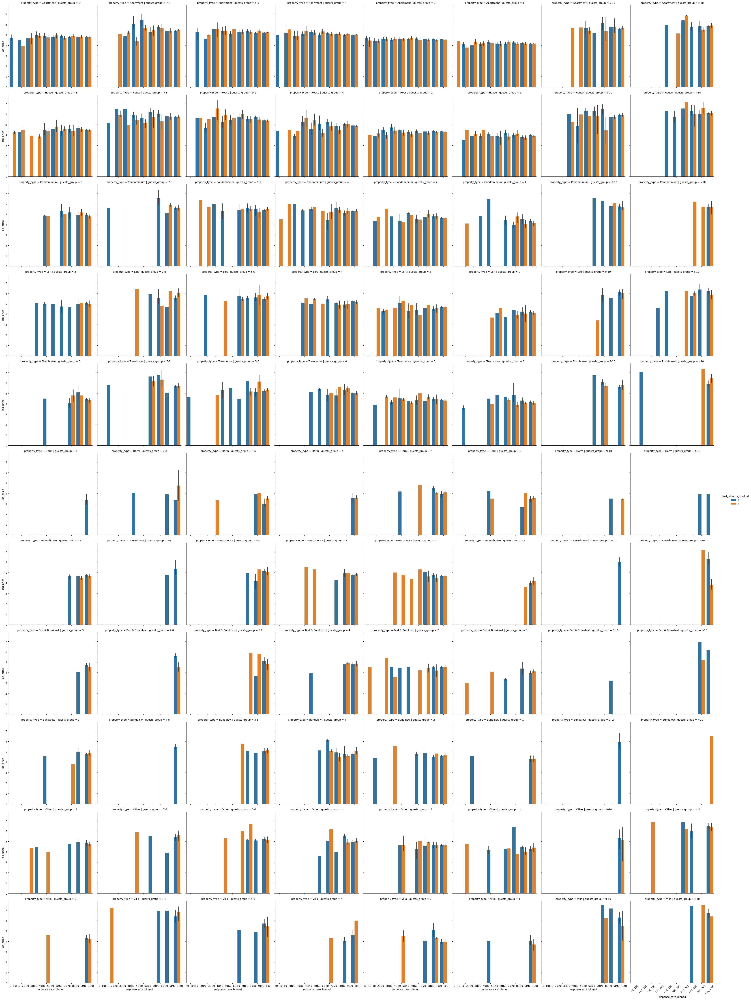

In [ ]:
# check if the tendency of the price to be higher in verified hosts when looking at high response rates holds subgrouping the data into groups of guests and property type
sns.catplot(data = air, x = "response_rate_binned", y = "log_price", order = ["(0, 10]", "(10, 20]","(20, 30]","(30, 40]","(40, 50]","(50, 60]","(60, 70]","(70, 80]", "(80, 90]", "(90, 100]"], hue = "host_identity_verified", kind = "bar", col = "guests_group", row = "property_type") 
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)
# it does not hold in a lot of cases, then not actually meaningful as insight

## Instant bookable feature 

**General analysis**: 
the price of properties with that feature are on average lower than the ones without it, exept for DC. Why?

### General

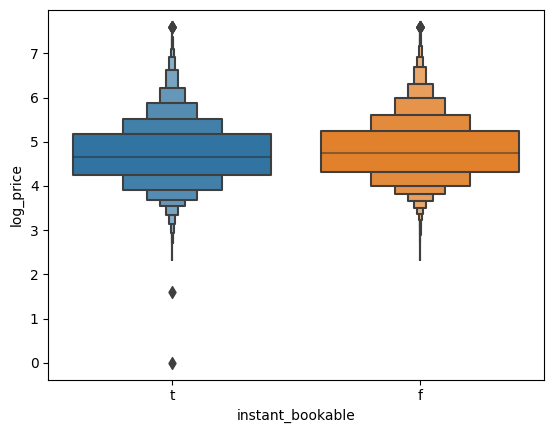

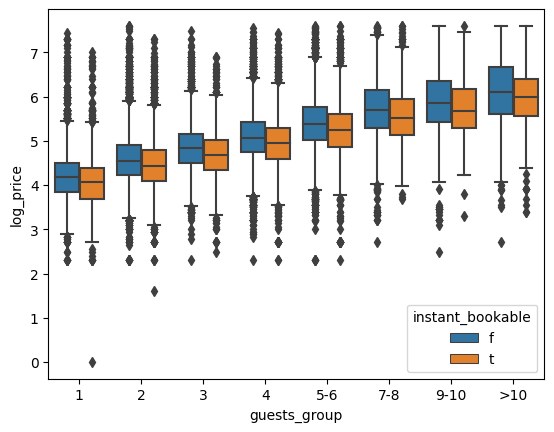

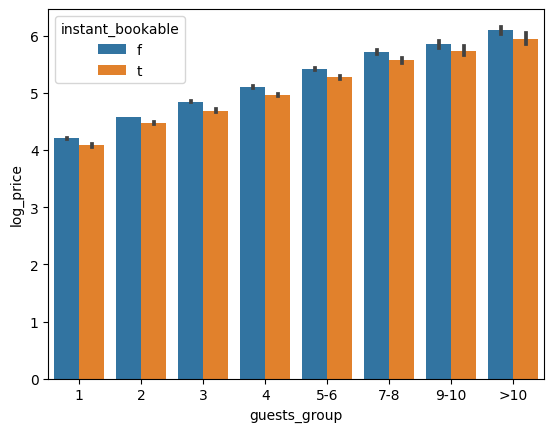

In [ ]:
# see the distribution of prices in instant bookable and non-instant bookable properties
sns.boxenplot(data = air, x = "instant_bookable", y = "log_price", order = ["t", "f"])
plt.show()
print('')
# median price of the instant bookable is lower than the non-instant bookable

# let's see now if we divide into guests groups what happens
sns.boxplot(data = air, x = "guests_group", y = "log_price", hue = "instant_bookable", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"])
plt.show()
print('')
# for each group the median price of the instant bookable is lower than the non-instant bookable

# what if instead we considered the mean? (barplot)
sns.barplot(data = air, x = "guests_group", y = "log_price", hue = "instant_bookable", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"])
plt.show()
print('')
# confirmed even here

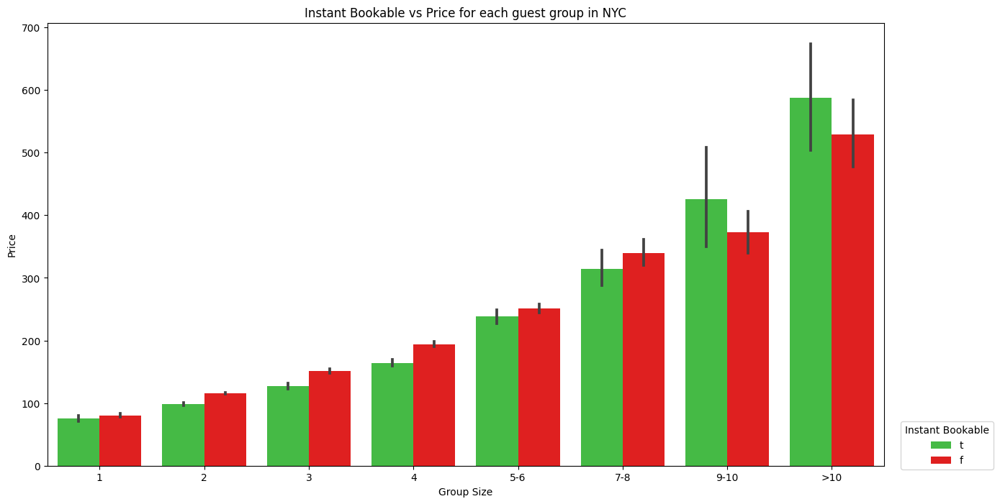

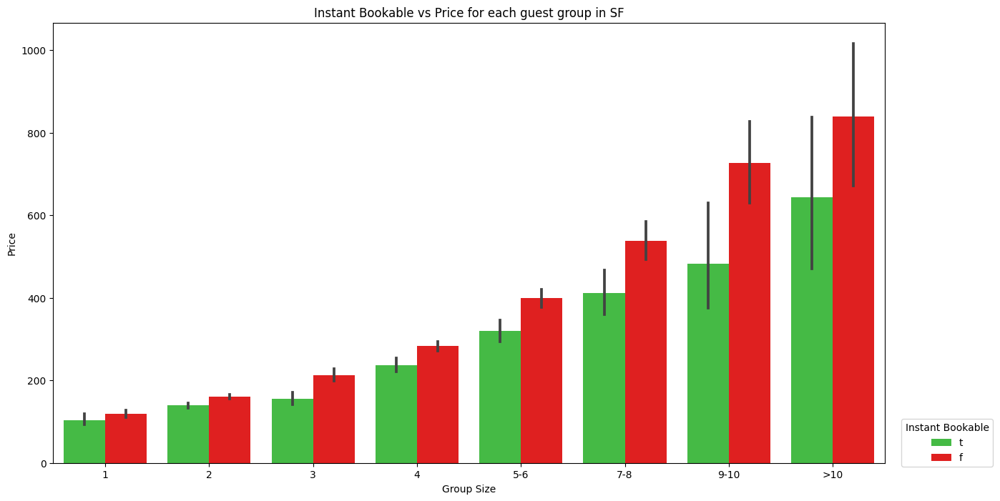

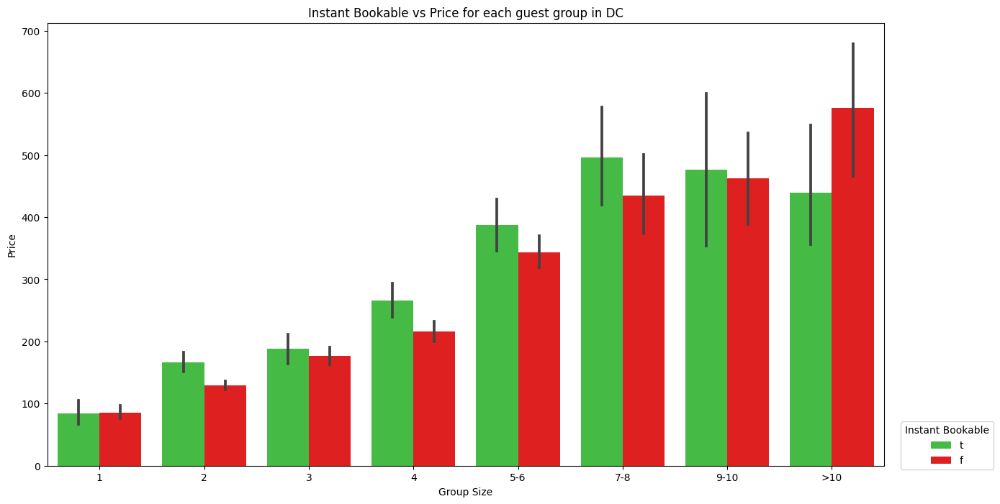

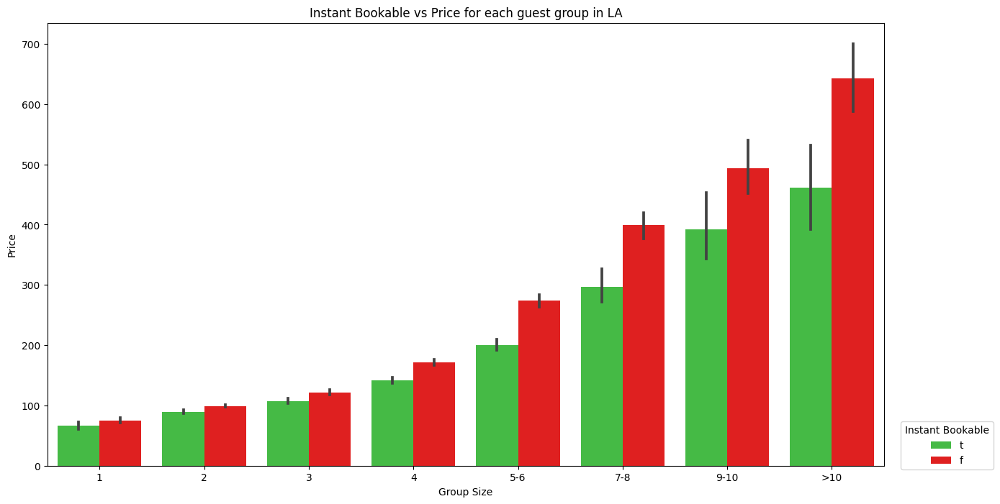

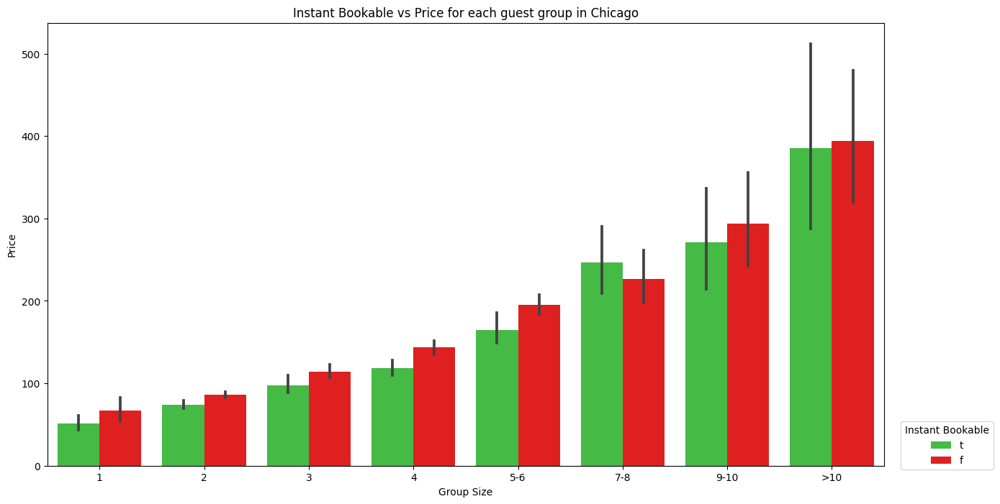

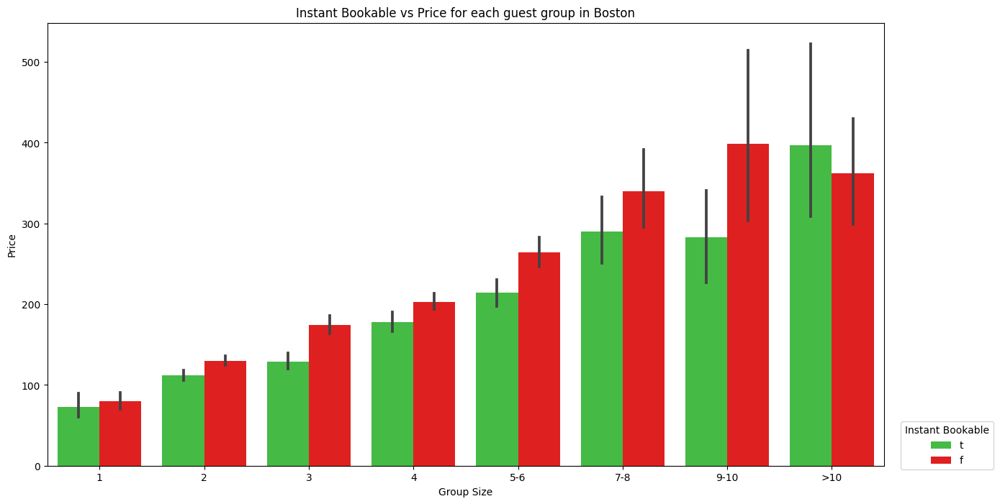

In [ ]:
# let's now see the distribution of the price for each city and groups of guests
cities = air["city"].unique()
my_palette2 = {"t": "limegreen", "f": "red"}

for city in cities:
  plt.figure(figsize = (15,8))
  g = sns.barplot(data = air[air.city == city], x = "guests_group", y = "price", hue = "instant_bookable", palette=my_palette2, order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"], hue_order = ["t", "f"])
  plt.title(f"Instant Bookable vs Price for each guest group in {city}")
  plt.xlabel("Group Size")
  plt.ylabel("Price")
  plt.legend(bbox_to_anchor=(1.02, 0.1), loc='upper left', borderaxespad=0, title = "Instant Bookable")
  plt.show()
  print('')

# trend definetly confirmed, except for DC, why?

Let's see what changes throughout the property types among the cities

### Detailed Analysis of the previous finding

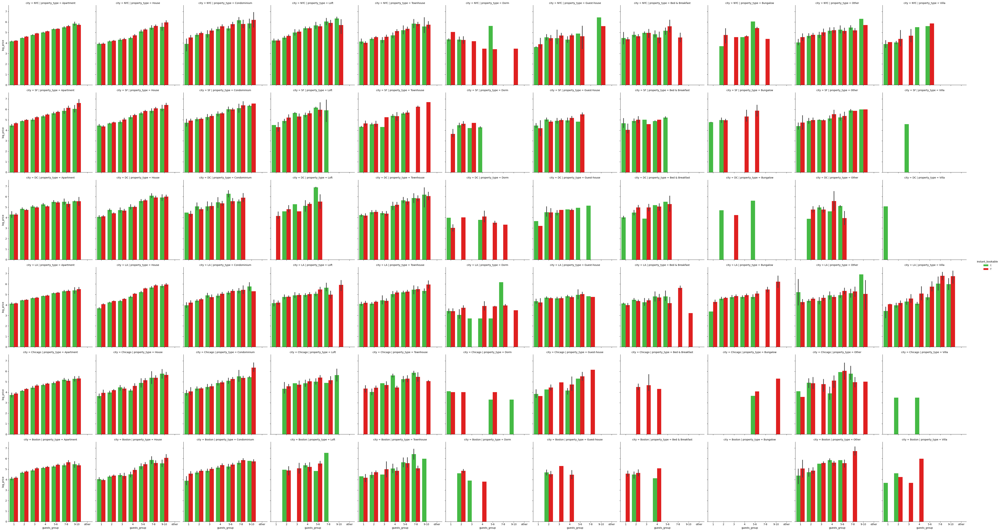

In [ ]:
# check if the insight holds for the subcategories
my_palette2 = {"t": "limegreen", "f": "red"} 
sns.catplot(data = air, col = "property_type", row = "city", hue = "instant_bookable", x = "guests_group", y = "log_price", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"], palette=my_palette2, kind = "bar", hue_order = ["t", "f"])
plt.show()
# it does in most of the cases

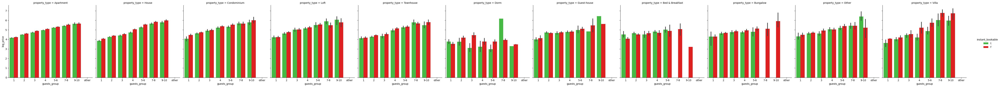

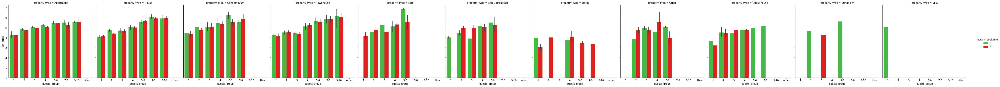

In [ ]:
# compare the DC subgroups behaviour with the other grouped cities 
my_palette2 = {"t": "limegreen", "f": "red"} 
sns.catplot(data = air[air.city != "DC"], col = "property_type", hue = "instant_bookable", x = "guests_group", y = "log_price", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", "other"], palette=my_palette2, kind = "bar", hue_order = ["t", "f"])
plt.show()
sns.catplot(data = air[air.city == "DC"], col = "property_type", hue = "instant_bookable", x = "guests_group", y = "log_price", order=["1", "2", "3", "4", "5-6", "7-8", "9-10", "other"], palette=my_palette2, kind = "bar", hue_order = ["t", "f"])
plt.show()
# can't find any reason, but DC, in both in apartment and houses, has higher median price for instant bookable and also it doesn't have too expensive different type of properies that can higher up the price of non-instant-bookable properties

### Insights

In [ ]:
#correct the code, base should be good

#calculate the percentage of instant bookale property
percentage_instant = (len(air[air.instant_bookable == "t"])/len(air))*100
print(f"This is the percentage of instant bookable properties: {round(percentage_instant,2)}")

# calculate the 10th percentile of log_price
price_10th_percentile = air['log_price'].quantile(0.1)

# create a dataframe of the top 10% most expensive listings
top_10_percent = air[air['log_price'] >= price_10th_percentile]

# calculate the percentage of the top 10% most expensive listings that are not instant bookable
x = (top_10_percent['instant_bookable'] == 'f').sum() / len(top_10_percent) * 100
print(f"{round(x,1)}% of the 10% most expensive listings are not instant bookable.")

# create a dataframe of the bottom 10% least expensive listings
bottom_10_percent = air[air['log_price'] <= air['log_price'].quantile(0.1)]

# calculate the percentage of the bottom 10% least expensive listings that are instant bookable
x = (bottom_10_percent['instant_bookable'] == 't').sum() / len(bottom_10_percent) * 100
print(f"{round(x,1)}% of the 10% least expensive listings are instant bookable.")


This is the percentage of instant bookable properties: 26.3
74.3% of the 10% most expensive listings are not instant bookable.
31.2% of the 10% least expensive listings are instant bookable.


## Cancellation Policy Analysis

**General Analysis**: properties with super strict policies have on average always (with very few exceptions) higher prices than the other properties with different policies and in the same city , property type and group of guests hosted

### General

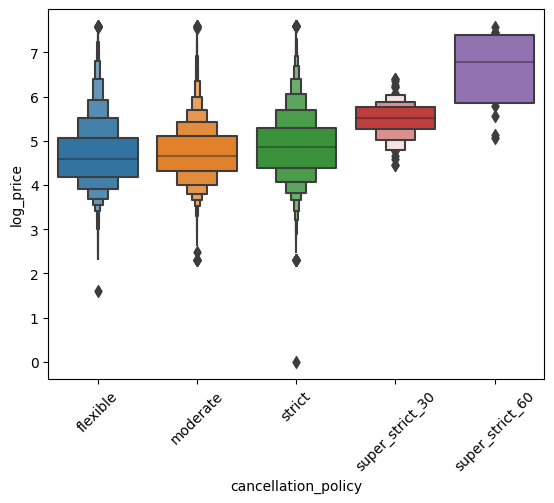

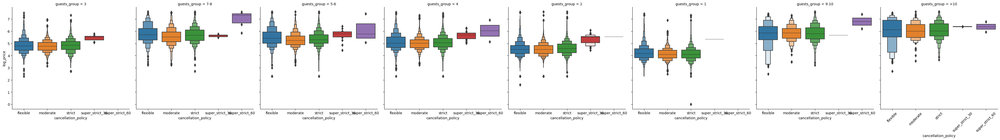

In [ ]:
# see the distribution of the policies in the dataset
sns.boxenplot(data = air, x = "cancellation_policy", y = "log_price", order = ["flexible", "moderate", "strict", "super_strict_30", "super_strict_60"])
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)
plt.show()
print('')
# we can observe a median price that increases as the stricter the policy is

# let's check if we divide the dataframe in groups of guests what happens
sns.catplot(data = air, x = "cancellation_policy", y = "log_price", order = ["flexible", "moderate", "strict", "super_strict_30", "super_strict_60"], kind = "boxen", col = "guests_group")
ax = plt.gca()
ax.tick_params(axis='x', labelrotation = 45)
plt.show()
print('')
# we can see that the linear increas of the median price of the first three policies does not hold when digging into the groups of guests, then it's not a good general insight. 
# however, we can see that in most of the cases (we can see it also in the grid following this cell) that the super strict policies have always higher median price compared to other properties
# with different policies in their correspective category

### Detailed confirmation of the previous finding

In [ ]:
# looking at each different city and group of guests
sns.catplot(data=air, x="cancellation_policy", y="log_price", col="guests_group", row="city", kind="bar",  order = ["flexible", "moderate", "strict", "super_strict_30", "super_strict_60"])
# confirmed

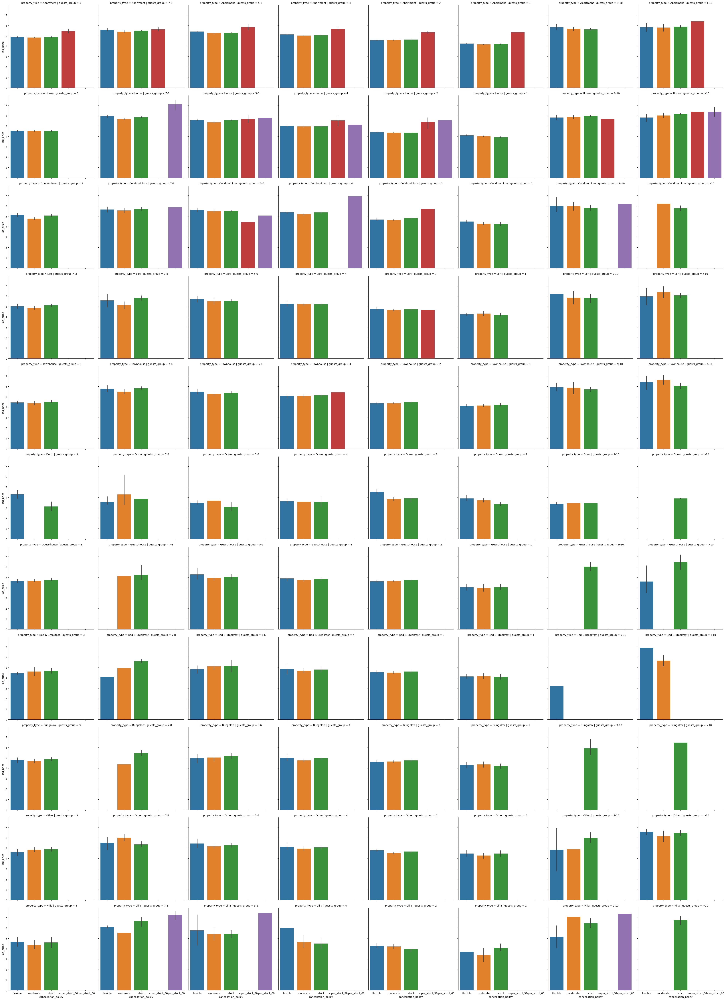

In [ ]:
# looking at each different city and group of guests
sns.catplot(data=air, x="cancellation_policy", y="log_price", col="guests_group", row="property_type", kind="bar",  order = ["flexible", "moderate", "strict", "super_strict_30", "super_strict_60"])
# confirmed

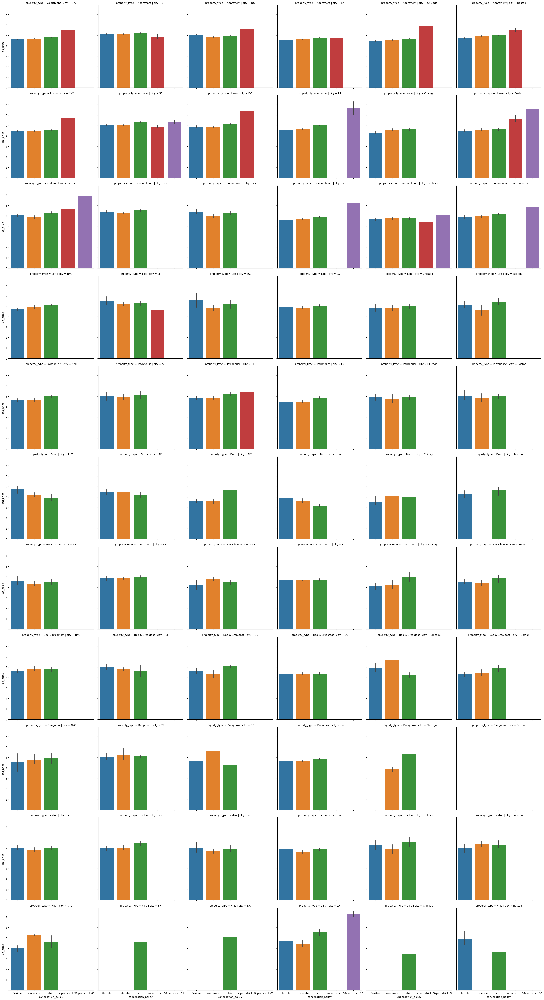

In [ ]:
# looking at each different city and property type
sns.catplot(data=air, x="cancellation_policy", y="log_price", col="city", row="property_type", kind="bar",  order = ["flexible", "moderate", "strict", "super_strict_30", "super_strict_60"])
# confirmed

### Insights

In [ ]:
# get the 90th percentile of log_price for all listings
price_90_percentile = np.percentile(air['log_price'], 90)

# get the dataframe of all super strict listings
super_strict_df = air[air['cancellation_policy'] == 'super_strict_30']

# calculate the percentage of super strict listings with log_price higher than price_90_percentile
x1 = 100 * len(super_strict_df[super_strict_df['log_price'] > price_90_percentile]) / len(super_strict_df)
print(f"90% of the prices of the super strict listings are higher than {round(x1,2):.2f}% of the other properties.")

# get the dataframe of all non-super strict listings
non_super_strict_df = air[air['cancellation_policy'] != 'super_strict_30']

# calculate the 60th percentile of log_price for non-super strict listings
price_60_percentile = np.percentile(non_super_strict_df['log_price'], 70)

# calculate the percentage of super strict listings with log_price higher than price_60_percentile
x2 = 100 * len(super_strict_df[super_strict_df['log_price'] > price_60_percentile]) / len(super_strict_df)
print(f"{round(x2,0):.2f}% of the super strict listings are higher than 70% of the other properties.")


90% of the prices of the super strict listings are higher than 29.91% of the other properties.
79.00% of the super strict listings are higher than 70% of the other properties.


# Reviews Analysis

In [ ]:
### SETUP Host/Reviews Analysis

# transforming the log price in normal price 
air["price"] = air.apply(lambda row: np.exp(row["log_price"]), axis = 1)

# grouping the groups of people to lower down the possible values that the variable can take
def group_guests(x):
    if x == 1:
        return "1"
    elif x == 2:
        return "2"
    elif x == 3:
        return "3"
    elif x == 4:
        return "4"
    elif x == 5 or x == 6:
        return "5-6"
    elif x == 7 or x == 8:
        return "7-8"
    elif x == 9 or x == 10:
        return "9-10"
    else:
        return ">10"
air["guests_group"] = air["accommodates"].apply(group_guests)

### Calculating and adding the variable "Bayesian Average"

**Intuition on why we should cosider the number of ratings in the average**

To analyze the relationship between the reviews information and the price we needed an index that would capture the precise rating given by the variables “average rating” and “number of reviews”, in fact the average rating is highly influenced by the number of reviews. Why? Let’s consider a model associated to each property that describe the assignment of reviews to the property, our random variable is a specific review (1-5) and the model gives us the probability (for the specific property) of our random variable being a specific number from 1 to 5 (the rating of the review), unfortunately we cannot see this model in the data, so we need to find it from them. To evaluate the rating correctly, we don’t actually need all the information of the model, we only need to understand that the real rating is given by the expectation of the model, because this is the “best guess” for the next potential review and the higher it is, the better would be the expectation of the guest. We know that we can learn the model from the data, in fact the average of the values of a data sample concentrates around the expectation when the number of observation tends to infinity, then the more number of reviews we have for the property the more its average will actually meet the “expectation” and the rating will be precise. On the other hand, if we have a small amount of reviews, then the average could be nowhere close to the real expectation. That’s why to analyze the rating of the properties we need to take into account the number of reviews. An easy and effective way is to use the Bayesian average, which is an average that computes the mean of a population by not only using the data residing in the population but also considering some outside information, like a pre-existing belief 

We found the following formula on internet that can approximate pretty good our index:
$$
s_i=\frac{m_i}{m_i+m_{a v g}} \cdot A_i+\frac{m_{a v g}}{m_i+m_{a v g}} \cdot S
$$
- $S$: average value of ratings that any item in the system receives
- $m_i$:  number of ratings of the property
- $m_avg$: average number of ratings that any item in the system receives
- $A_i$: average rating of the property

In [ ]:
# Calculate S: the system's arithmetic mean
S = np.mean(air["review_scores_rating"])

# Calculate m_avg: average number of ratings that any item in the system receives
m_avg = np.mean(air["number_of_reviews"])

# Create a new variable "b_avg" with the Bayesian average for each entry
air["bayesian_avg"] = (air["number_of_reviews"]/(air["number_of_reviews"]+m_avg))*air["review_scores_rating"] + (m_avg/(air["number_of_reviews"]+m_avg))*S

# assigning stars to the properties
def rating_stars(x):
    return round((x/100)*5, 2)
      
air["stars"] = air["bayesian_avg"].apply(rating_stars)

# assigning rating bins to the properties
def group_rating(x):
    if x > 95:
      return "(95,100]"
    elif x > 85 and x <= 95:
        return "(85,95]"
    elif x > 75 and x <= 85:
        return "(75,85]"
    elif x > 65 and x < 75:
        return "(65,75]"
    elif x > 55 and x < 65:
        return "(55,65]"
    elif x > 45 and x < 55:
        return "(45,55]"
    elif x > 35 and x < 45:
        return "(35,45]"
    else:
        return "[0,35]"

# assigning stars' bins to the properties
def stars(x):
    if x > 4.5:
      return ">4.5"
    elif x >= 4 and x <= 4.5:
        return "4-4.5"
    elif x >= 3.5 and x <= 4:
        return "3.5-4"
    elif x >= 3 and x < 3.5:
        return "3-3.5"
    elif x >= 2.5 and x < 3:
        return "2.5-3"
    elif x >= 2 and x < 2.5:
        return "2-2.5"
    elif x >= 1.5 and x < 2:
        return "1.5-2"
    else:
        return "0-1.5"
      
air["stars_group"] = air["bayesian_avg"].apply(stars)
      
air["rating_group"] = air["bayesian_avg"].apply(group_rating)

In [ ]:
# calculate correlation between the average rating and the log price
air["bayesian_avg"].corr(air["log_price"])

0.09322743863684155

In [ ]:
# printing the correlation for each subgroup of "number of guests"
grouped = air.groupby("guests_group")
print("Correlation between bayesian_avg and log_price for")

for guests_group, group in grouped:
    correlation = group["log_price"].corr(group["bayesian_avg"])
    print(f"{guests_group}: {correlation}")

Correlation between bayesian_avg and log_price for
1: 0.12436382754153177
2: 0.1451817194491564
3: 0.158497883919166
4: 0.16319760928986887
5-6: 0.16741492408199934
7-8: 0.23242956347582827
9-10: 0.23186970202909282
>10: 0.2770984951246572


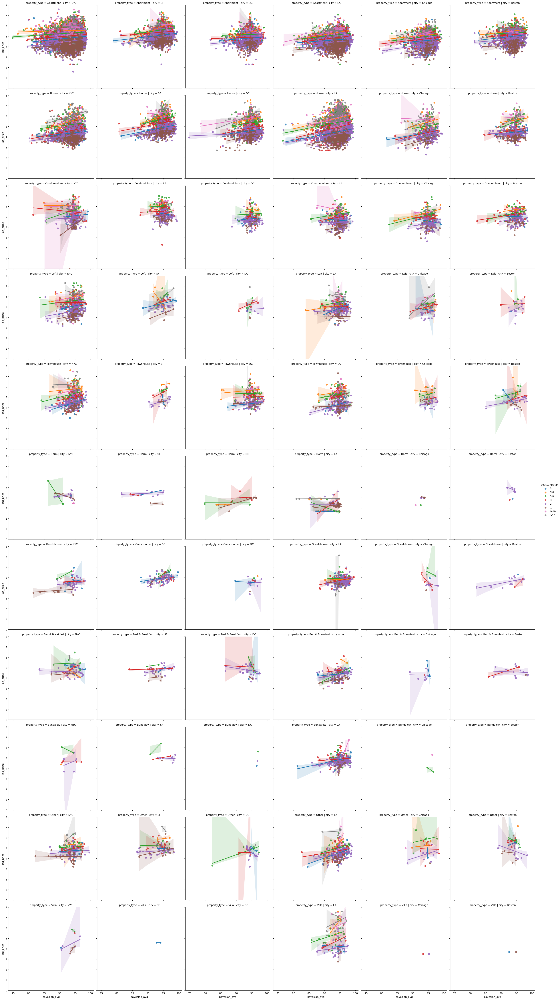

In [ ]:
# scatter plot between log price and ratings, diversified by city, property type and guests groups (in colors)
sns.lmplot(data = air, row = "property_type", col = "city", hue = "guests_group", x = "bayesian_avg", y = "log_price").set(ylim=(0, 8))

###General Analysis

<Axes: xlabel='bayesian_avg', ylabel='Count'>

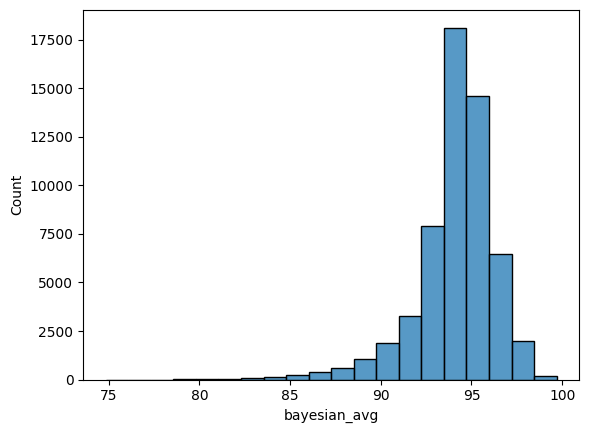

In [ ]:
# plotting the cumulative frequency of rating in 100th 
sns.histplot(data = air, x = "bayesian_avg", bins = 20)

<Axes: xlabel='stars', ylabel='Count'>

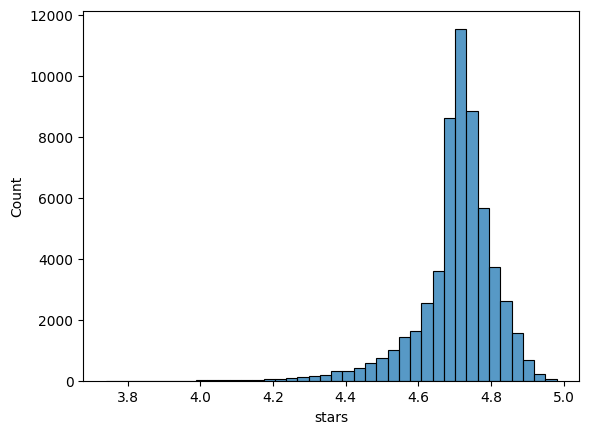

In [ ]:
# plotting the frequency of rating 1-5 rounded to the first two decimals as airbnb display them and more bins to be precise
sns.histplot(data = air, x = "stars", bins = 40)

<Axes: xlabel='stars', ylabel='Count'>

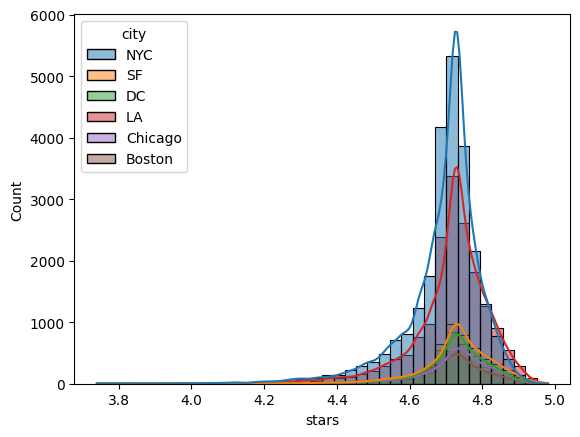

In [ ]:
# plotting the same graph but with the hue of the city to see which city has highest number of ratings 
sns.histplot(data = air, x = "stars", bins = 40, hue = "city", kde = "True")

<Axes: xlabel='stars', ylabel='Percent'>

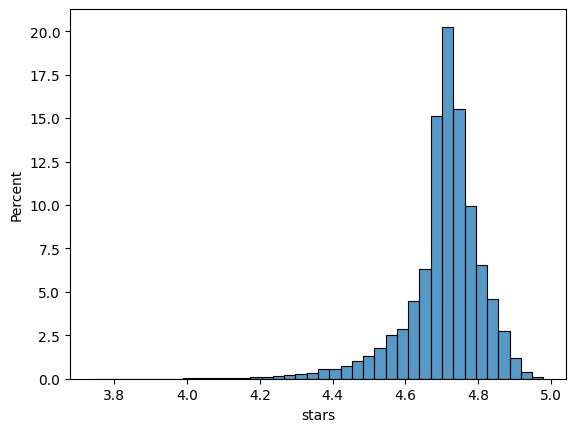

In [ ]:
# plotting relative frequency
sns.histplot(data = air, x = "stars", stat = "percent",  bins = 40)

In [ ]:
# some relevant insights
print("This is the percentage of properties with more than 95 as rating: ", round(len(air[air.rating_group == "(95,100]"])/len(air)*100, 2))
print("This is the percentage of properties with more than 85 as rating: ", round(len(air[(air.rating_group == "(95,100]") | (air.rating_group == "(85,95]")])/len(air)*100,2))

This is the percentage of properties with more than 95 as rating:  25.43
This is the percentage of properties with more than 85 as rating:  77.01


### Relationship with price

<Axes: xlabel='rating_group', ylabel='log_price'>

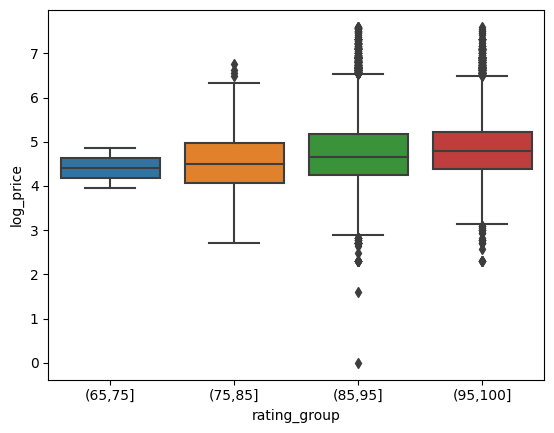

In [ ]:
# plotting boxplot of the price for each rating group
sns.boxplot(data = air, x = "rating_group", y = "log_price", order = ["(65,75]", "(75,85]", "(85,95]", "(95,100]"])
# looks like the median price increases as the rating increases

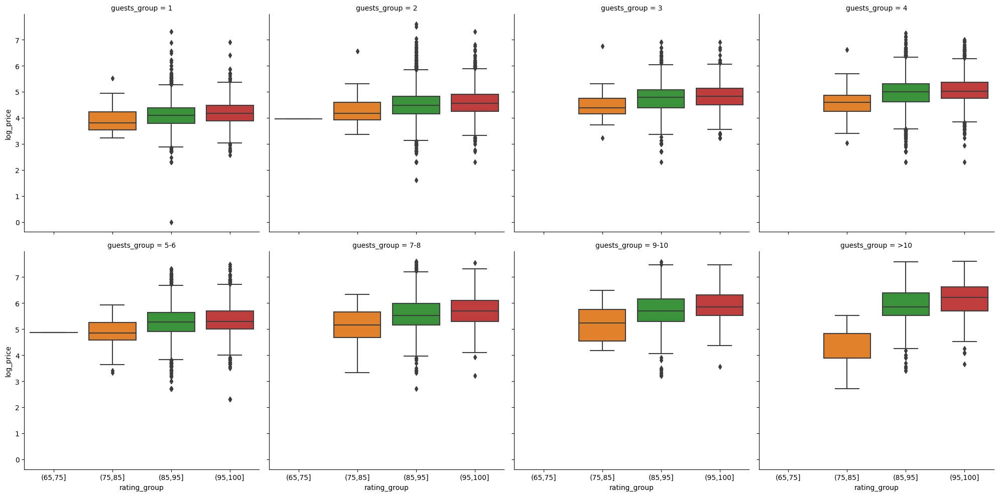

In [ ]:
# compare the price for each rating group in each city
sns.catplot(data = air, x = "rating_group", y = "log_price", order = ["(65,75]", "(75,85]", "(85,95]", "(95,100]"], col = "guests_group", kind = "box", col_order =["1", "2", "3", "4", "5-6", "7-8", "9-10", ">10"], col_wrap = 4 )
# trend is confirmed even though the change in the last two bins is not that significant

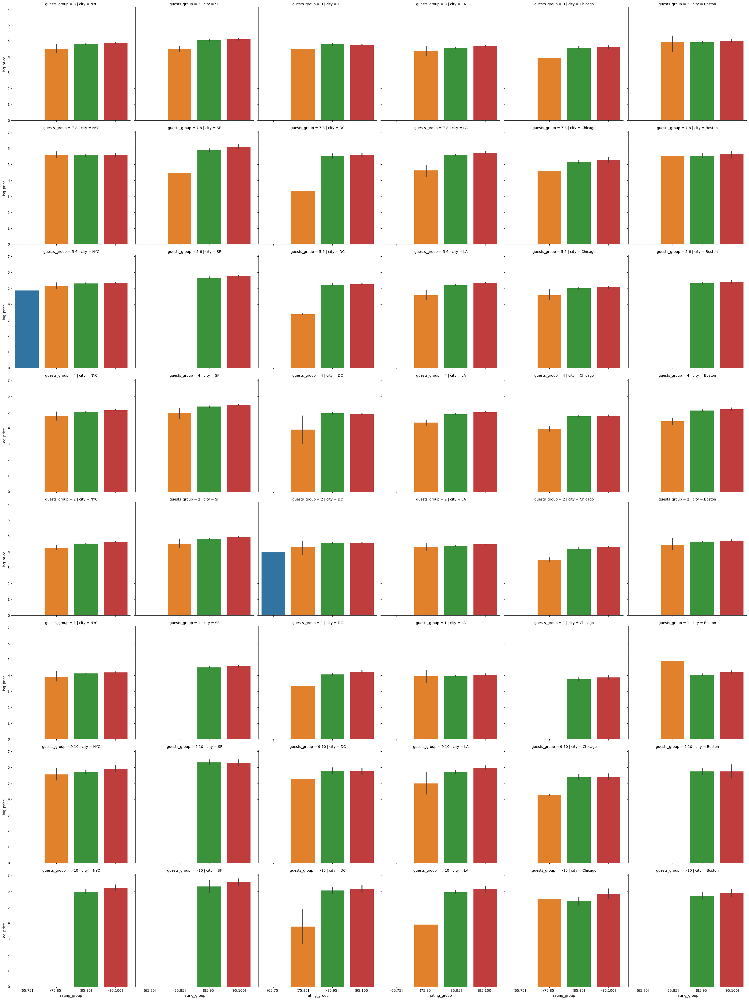

In [ ]:
# compare the price for each rating group in each city and number of guests
sns.catplot(data = air, x = "rating_group", y = "log_price", order = ["(65,75]", "(75,85]", "(85,95]", "(95,100]"], col = "city", row = "guests_group", kind = "bar")
# trend confirmed, but it's not very informative and it's biased since we decided how to bin the ratings

# Price per Guest 


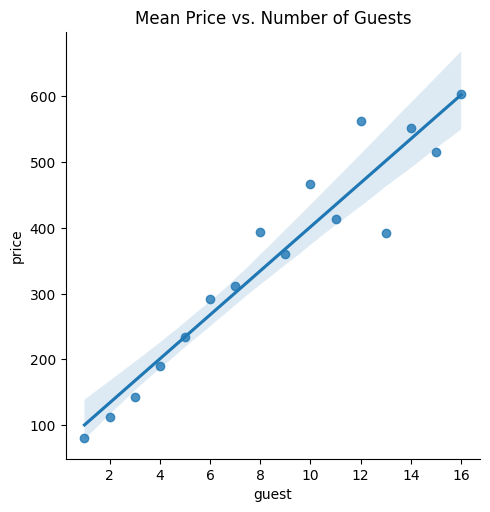

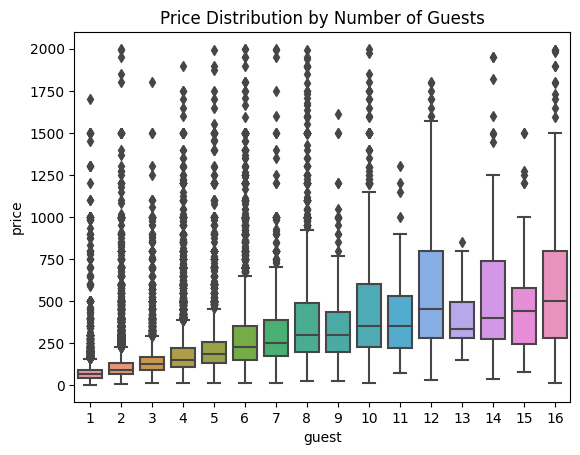

In [ ]:
logprice = air['log_price']
price = (logprice).apply(lambda x: pow(math.e, x))

# Create a new DataFrame with the calculated price and the number of guests
data = pd.DataFrame({'price': price, 'guest': air['accommodates']})

# Calculate the mean price for each number of guests
mean_prices = data.groupby('guest')['price'].mean().reset_index()

# Plot the lmplot with the number of guests on the x-axis and the mean price on the y-axis
sns.lmplot(x='guest', y='price', data=mean_prices)
plt.title('Mean Price vs. Number of Guests')
plt.show()

# Plot a boxplot with the number of guests on the x-axis and the price on the y-axis
sns.boxplot(x='guest', y='price', data=data)
plt.title('Price Distribution by Number of Guests')
plt.show()

**Analyze the Effect of accomodates in all cities singularly**

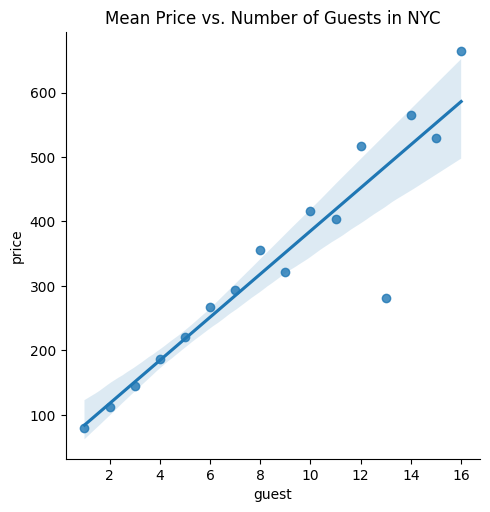

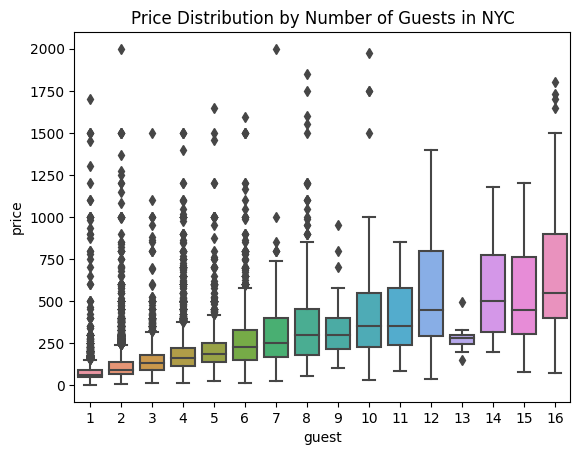

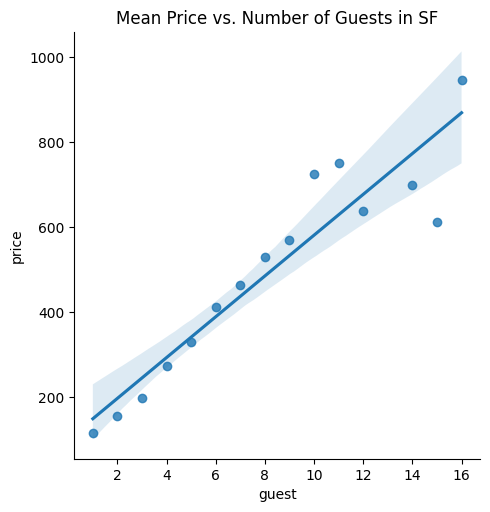

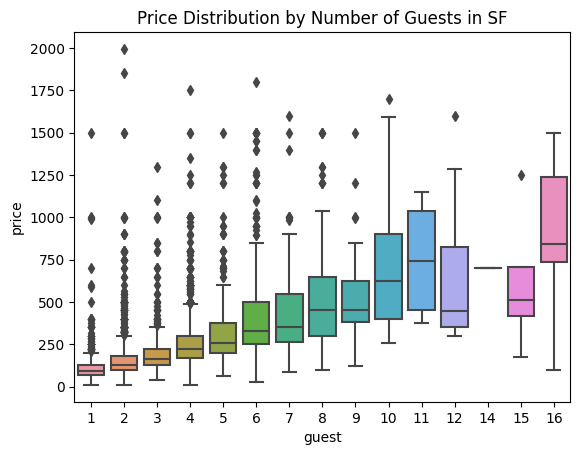

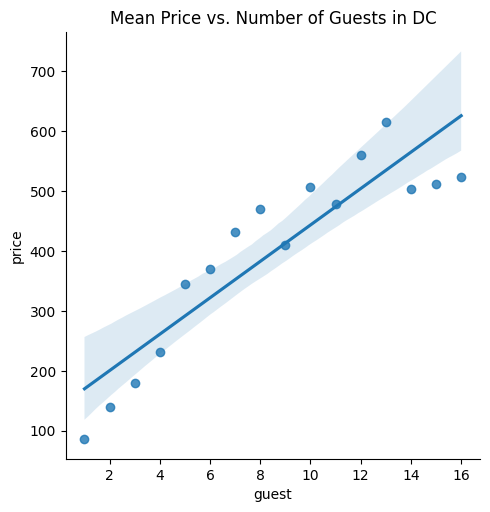

...

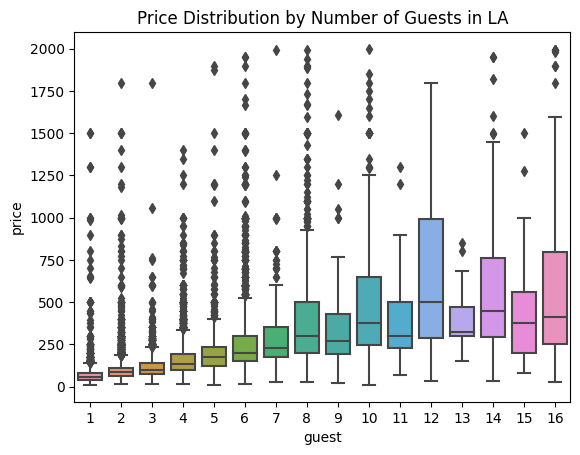

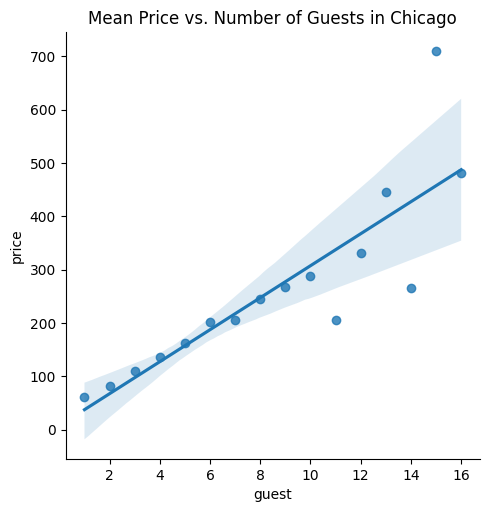

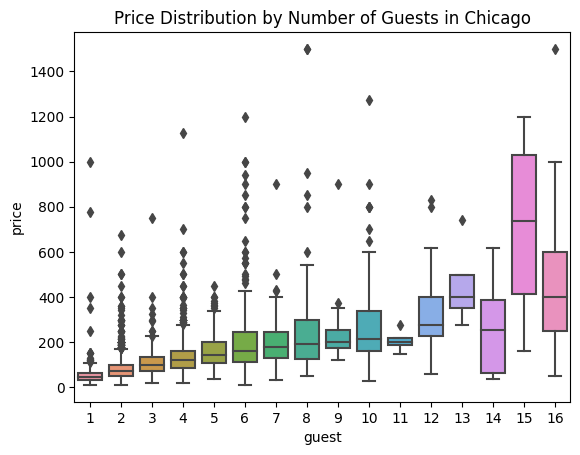

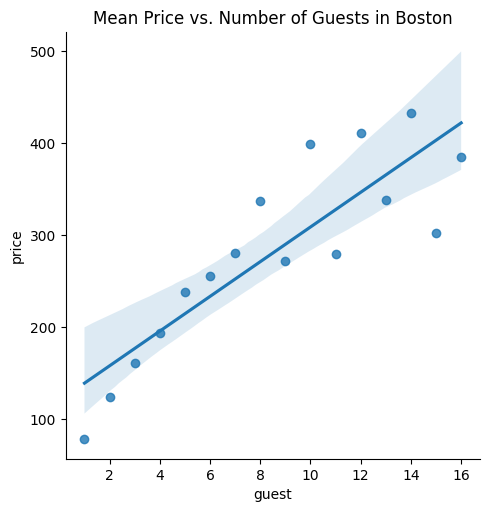

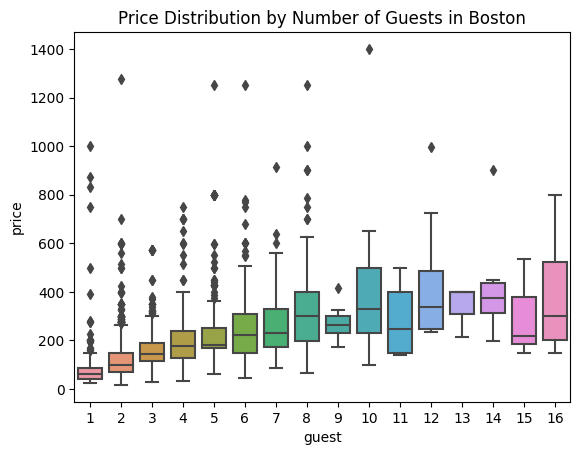

In [ ]:
cities = air['city'].unique() # Get unique cities in the DataFrame

for city in cities:
    # Subset the data for the current city
    city_data = air[air['city'] == city]
    
    # Calculate price for the current city
    logprice = city_data['log_price']
    price = (logprice).apply(lambda x: pow(math.e, x))

    # Create a new DataFrame with the calculated price and the number of guests
    data = pd.DataFrame({'price': price, 'guest': city_data['accommodates']})

    # Calculate the mean price for each number of guests
    mean_prices = data.groupby('guest')['price'].mean().reset_index()

    # Plot the lmplot with the number of guests on the x-axis and the mean price on the y-axis
    sns.lmplot(x='guest', y='price', data=mean_prices)
    plt.title(f'Mean Price vs. Number of Guests in {city}')
    plt.show()

    # Plot a boxplot with the number of guests on the x-axis and the price on the y-axis
    sns.boxplot(x='guest', y='price', data=data)
    plt.title(f'Price Distribution by Number of Guests in {city}')
    plt.show()